# Next Stop: Rail-Induced Displacement of Immigrant Communities?
## Arroyo Seco Collective
### By Erik Felix and Kevin Liu

With Measure R’s passage in 2008, and Measure M’s passage in 2016,  LA Metro has been heavily investing in light rail. Metro’s L Line is a prime example. Completed in 2009 and cross cutting through both immigrant communities and wealthy white communities, the L Line traverses a particularly diverse segment of Los Angeles County making it a prime candidate for study. <br>

<em>Research question</em>: did Metro’s construction of the L Line through Arcadia, Pasadena, Highland Park, Chinatown, Boyle Heights, and East Los Angeles have a measurable impact on exacerbating displacement of foreign-born households who lived near the station? Or, is the trend around the station similar to trends happening neighborhood-wide?
<br>
<br>
To do this, we use the 2011 and 2019 ACS survey to calculate the percent change of foreign born population between 2011 and 2019, per census tract. We use this datapoint to understand how foreign born populations have changed around the station area and neighborhood at large, relative to the total population. Understanding if recent immigrants are having a harder, similar, or easier time living in the census tracts in the station area provides insight into the potential effect the rail investment may have on immigrant communities.

In [5]:
# Let's start by importing all of the libraries we'll need for our analyses

import pandas as pd

import geopandas as gpd

from shapely.geometry import Point

import contextily as ctx

import matplotlib.pyplot as plt

# for interactive plots
import plotly.express as px

# for network analysis
import networkx as nx

# for street network analysis
import osmnx as ox

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


We have four different data files that need merging, so the first section here is merging all our files into one geodataframe. We first merge our 2019 ACS data files which are two geojsons (table B01003 for Total Population, and Table B05007 for Foreign Born Residents). We then do the same and merge our 2011 ACS data files which are two csv’s (same tables). Finally, we bring together the 2011 and 2019 dataframes to create one big data frame with both ACS 2019 and 2011 files in it.

In [6]:
# Importing ACS 2019 Total Pop

gdf1 = gpd.read_file('acs2019_5yr_B01003_14000US06037222001.geojson')

In [7]:
# Importing ACS 2019 Foreign Born

gdf2 = gpd.read_file('acs2019_5yr_B05007.geojson')

In [8]:
gdf1.head()

,geoid,name,B01003001,"B01003001, Error",geometry
0,05000US06037,"Los Angeles County, CA",10081570.0,0.0,"MULTIPOLYGON (((-118.70339 34.16859, -118.7033..."
1,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,443.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
2,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,334.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
3,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,484.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
4,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,276.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."


In [9]:
gdf2.head()

,geoid,name,B05007001,"B05007001, Error",B05007002,"B05007002, Error",B05007003,"B05007003, Error",B05007004,"B05007004, Error",...,"B05007102, Error",B05007103,"B05007103, Error",B05007104,"B05007104, Error",B05007105,"B05007105, Error",B05007106,"B05007106, Error",geometry
0,05000US06037,"Los Angeles County, CA",3430535.0,14118.0,441555.0,6639.0,54213.0,1710.0,387342.0,6344.0,...,998.0,4753.0,625.0,36463.0,1209.0,29493.0,1166.0,6970.0,540.0,"MULTIPOLYGON (((-118.70339 34.16859, -118.7033..."
1,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1424.0,326.0,217.0,129.0,63.0,66.0,154.0,126.0,...,13.0,11.0,16.0,11.0,17.0,0.0,12.0,11.0,17.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
2,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",810.0,180.0,45.0,39.0,9.0,17.0,36.0,35.0,...,12.0,0.0,12.0,21.0,23.0,0.0,12.0,21.0,23.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
3,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",3167.0,438.0,271.0,216.0,10.0,17.0,261.0,216.0,...,17.0,0.0,17.0,88.0,71.0,51.0,44.0,37.0,59.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
4,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",1749.0,251.0,184.0,124.0,48.0,58.0,136.0,112.0,...,12.0,0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."


In [10]:
# Dropping our first rows because we don't need the totals for the entire county

gdf1 = gdf1.drop([0])

In [11]:
gdf2 = gdf2.drop([0])

In [12]:
gdf1.head()

,geoid,name,B01003001,"B01003001, Error",geometry
1,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,443.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
2,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,334.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
3,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,484.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
4,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,276.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
5,14000US06037101300,"Census Tract 1013, Los Angeles, CA",3884.0,394.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [13]:
gdf2.head()

,geoid,name,B05007001,"B05007001, Error",B05007002,"B05007002, Error",B05007003,"B05007003, Error",B05007004,"B05007004, Error",...,"B05007102, Error",B05007103,"B05007103, Error",B05007104,"B05007104, Error",B05007105,"B05007105, Error",B05007106,"B05007106, Error",geometry
1,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1424.0,326.0,217.0,129.0,63.0,66.0,154.0,126.0,...,13.0,11.0,16.0,11.0,17.0,0.0,12.0,11.0,17.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
2,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",810.0,180.0,45.0,39.0,9.0,17.0,36.0,35.0,...,12.0,0.0,12.0,21.0,23.0,0.0,12.0,21.0,23.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
3,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",3167.0,438.0,271.0,216.0,10.0,17.0,261.0,216.0,...,17.0,0.0,17.0,88.0,71.0,51.0,44.0,37.0,59.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
4,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",1749.0,251.0,184.0,124.0,48.0,58.0,136.0,112.0,...,12.0,0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
5,14000US06037101300,"Census Tract 1013, Los Angeles, CA",1658.0,261.0,192.0,164.0,11.0,17.0,181.0,164.0,...,35.0,0.0,12.0,56.0,52.0,56.0,52.0,0.0,12.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [14]:
# Merging our geodataframes via an attribute join, with our attribute being "geoid", which we'll later change to FIPS code

acs19 = gdf2.merge(gdf1,on = ['geoid'])

In [15]:
acs19.head()

,geoid,name_x,B05007001,"B05007001, Error",B05007002,"B05007002, Error",B05007003,"B05007003, Error",B05007004,"B05007004, Error",...,"B05007104, Error",B05007105,"B05007105, Error",B05007106,"B05007106, Error",geometry_x,name_y,B01003001,"B01003001, Error",geometry_y
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1424.0,326.0,217.0,129.0,63.0,66.0,154.0,126.0,...,17.0,0.0,12.0,11.0,17.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...","Census Tract 1011.10, Los Angeles, CA",4283.0,443.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",810.0,180.0,45.0,39.0,9.0,17.0,36.0,35.0,...,23.0,0.0,12.0,21.0,23.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...","Census Tract 1011.22, Los Angeles, CA",3405.0,334.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",3167.0,438.0,271.0,216.0,10.0,17.0,261.0,216.0,...,71.0,51.0,44.0,37.0,59.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...","Census Tract 1012.10, Los Angeles, CA",6347.0,484.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",1749.0,251.0,184.0,124.0,48.0,58.0,136.0,112.0,...,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...","Census Tract 1012.20, Los Angeles, CA",3702.0,276.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",1658.0,261.0,192.0,164.0,11.0,17.0,181.0,164.0,...,52.0,56.0,52.0,0.0,12.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...","Census Tract 1013, Los Angeles, CA",3884.0,394.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [16]:
# Keeping only the estimate, geoid, and geometry columns while dropping margin for error

acs19 = acs19[['geoid', 
               'name_x', 
               'B01003001', 
               'B05007001', 
               'B05007002', 
               'B05007014', 
               'B05007015',  
               'B05007027', 
               'B05007028', 
               'B05007040', 
               'B05007041', 
               'B05007042', 
               'B05007054', 
               'B05007055', 
               'B05007056',
               'B05007068', 
               'B05007069', 
               'B05007081', 
               'B05007082', 
               'B05007094', 
               'B05007095', 
               'geometry_y']
             ] 
               

In [17]:
acs19.head()

,geoid,name_x,B01003001,B05007001,B05007002,B05007014,B05007015,B05007027,B05007028,B05007040,...,B05007054,B05007055,B05007056,B05007068,B05007069,B05007081,B05007082,B05007094,B05007095,geometry_y
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,...,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,...,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,...,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,...,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,...,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [18]:
# Renaming columns based on the metadata

acs19.columns = ['FIPS', 
                 'Census Tract', 
                 '19 Total Population', 
                 '19 Total Foreign Born',
                 '19 Total Entered 2010 or later', 
                 '19 Europe', 
                 '19 Europe Entered 2010 or later', 
                 '19 Asia', 
                 '19 Asia Entered 2010 or later', 
                 '19 Latin America', 
                 '19 Caribbean', 
                 '19 Caribbean entered 2010 or later', 
                 '19 Central America', 
                 '19 Mexico', 
                 '19 Mexico Entered 2010 or later', 
                 '19 Other Central America', 
                 '19 Other Central America Entered 2010 or later', 
                 '19 South America', 
                 '19 South America Entered 2010 or later', 
                 '19 Other Areas', 
                 '19 Other Areas Entered 2010 or later', 
                 'Geometry']
                 

In [19]:
acs19.head()

,FIPS,Census Tract,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,...,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,Geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,...,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,...,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,...,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,...,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,...,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [20]:
# Turning our geoid's into FIPS codes

acs19['FIPS'] = acs19['FIPS'].str.replace('14000US','')

In [21]:
acs19.head()

,FIPS,Census Tract,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,...,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,Geometry
0,06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,...,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,...,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,...,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,...,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,06037101300,"Census Tract 1013, Los Angeles, CA",3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,...,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


The 2011 files required a bit more work before merging, so there are definitely more steps involved below.

In [22]:
# Importing ACS 2011 Foreign Born

df1 = pd.read_csv('ACSDT5Y2011.B05007_data_with_overlays_2022-02-20T144252.csv')

In [23]:
# Importing ACS 2011 Total Pop

df2 = pd.read_csv('ACSDT5Y2011.B01003_data_with_overlays_2022-02-18T183522.csv')

In [24]:
df1.head()

,B05007_001E,B05007_001M,B05007_002E,B05007_002M,B05007_003E,B05007_003M,B05007_004E,B05007_004M,B05007_005E,B05007_005M,...,B05007_091E,B05007_091M,B05007_092E,B05007_092M,B05007_093E,B05007_093M,B05007_094E,B05007_094M,GEO_ID,NAME
0,Estimate!!Total,Margin of Error!!Total,Estimate!!Total!!Europe,Margin of Error!!Total!!Europe,Estimate!!Total!!Europe!!Entered 2000 or later,Margin of Error!!Total!!Europe!!Entered 2000 o...,Estimate!!Total!!Europe!!Entered 2000 or later...,Margin of Error!!Total!!Europe!!Entered 2000 o...,Estimate!!Total!!Europe!!Entered 2000 or later...,Margin of Error!!Total!!Europe!!Entered 2000 o...,...,Estimate!!Total!!Other areas!!Entered 1980 to ...,Margin of Error!!Total!!Other areas!!Entered 1...,Estimate!!Total!!Other areas!!Entered before 1980,Margin of Error!!Total!!Other areas!!Entered b...,Estimate!!Total!!Other areas!!Entered before 1...,Margin of Error!!Total!!Other areas!!Entered b...,Estimate!!Total!!Other areas!!Entered before 1...,Margin of Error!!Total!!Other areas!!Entered b...,id,Geographic Area Name
1,2027,394,93,56,15,17,7,10,8,13,...,0,95,0,95,0,95,0,95,1400000US06037101110,"Census Tract 1011.10, Los Angeles County, Cali..."
2,1254,318,144,80,0,95,0,95,0,95,...,0,95,9,14,0,95,9,14,1400000US06037101122,"Census Tract 1011.22, Los Angeles County, Cali..."
3,3471,547,39,40,0,95,0,95,0,95,...,0,95,0,95,0,95,0,95,1400000US06037101210,"Census Tract 1012.10, Los Angeles County, Cali..."
4,1242,243,61,54,0,95,0,95,0,95,...,0,95,0,95,0,95,0,95,1400000US06037101220,"Census Tract 1012.20, Los Angeles County, Cali..."


In [25]:
# Keeping Estimates and geoid only

ctk = ['B05007_001E', 
       'B05007_002E',
       'B05007_003E', 
       'B05007_015E', 
       'B05007_016E', 
       'B05007_028E', 
       'B05007_029E', 
       'B05007_030E', 
       'B05007_042E', 
       'B05007_043E', 
       'B05007_044E', 
       'B05007_056E', 
       'B05007_057E', 
       'B05007_069E', 
       'B05007_070E', 
       'B05007_082E', 
       'B05007_083E', 
       'GEO_ID'
        ]

In [26]:
df1 = df1[ctk]

In [27]:
df1.head()

,B05007_001E,B05007_002E,B05007_003E,B05007_015E,B05007_016E,B05007_028E,B05007_029E,B05007_030E,B05007_042E,B05007_043E,B05007_044E,B05007_056E,B05007_057E,B05007_069E,B05007_070E,B05007_082E,B05007_083E,GEO_ID
0,Estimate!!Total,Estimate!!Total!!Europe,Estimate!!Total!!Europe!!Entered 2000 or later,Estimate!!Total!!Asia,Estimate!!Total!!Asia!!Entered 2000 or later,Estimate!!Total!!Latin America,Estimate!!Total!!Latin America!!Caribbean,Estimate!!Total!!Latin America!!Caribbean!!Ent...,Estimate!!Total!!Latin America!!Central America,Estimate!!Total!!Latin America!!Central Americ...,Estimate!!Total!!Latin America!!Central Americ...,Estimate!!Total!!Latin America!!Central Americ...,Estimate!!Total!!Latin America!!Central Americ...,Estimate!!Total!!Latin America!!South America,Estimate!!Total!!Latin America!!South America!...,Estimate!!Total!!Other areas,Estimate!!Total!!Other areas!!Entered 2000 or ...,id
1,2027,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,1400000US06037101110
2,1254,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,1400000US06037101122
3,3471,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,1400000US06037101210
4,1242,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,1400000US06037101220


In [28]:
# Renaming according to metadata

df1.columns = ['11 Total Foreign Born', 
               '11 Total Europe', 
               '11 Total Europe Entered 2000 or later', 
               '11 Total Asia', 
               '11 Total Asia Entered 2000 or later', 
               '11 Total Latin America', 
               '11 Total Caribbean', 
               '11 Total Caribbean Entered 2000 or later', 
               '11 Total Central America',  
               '11 Total Mexico', 
               '11 Total Mexico Entered 2000 or later', 
               '11 Total Other Central America', 
               '11 Total Other Central America 2000 or later', 
               '11 Total South America', 
               '11 Total South America Entered 2000 or later', 
               '11 Total Other areas', 
               '11 Total Other areas Entered 2000 or later', 
               'FIPS']

In [29]:
df1.head()

,11 Total Foreign Born,11 Total Europe,11 Total Europe Entered 2000 or later,11 Total Asia,11 Total Asia Entered 2000 or later,11 Total Latin America,11 Total Caribbean,11 Total Caribbean Entered 2000 or later,11 Total Central America,11 Total Mexico,11 Total Mexico Entered 2000 or later,11 Total Other Central America,11 Total Other Central America 2000 or later,11 Total South America,11 Total South America Entered 2000 or later,11 Total Other areas,11 Total Other areas Entered 2000 or later,FIPS
0,Estimate!!Total,Estimate!!Total!!Europe,Estimate!!Total!!Europe!!Entered 2000 or later,Estimate!!Total!!Asia,Estimate!!Total!!Asia!!Entered 2000 or later,Estimate!!Total!!Latin America,Estimate!!Total!!Latin America!!Caribbean,Estimate!!Total!!Latin America!!Caribbean!!Ent...,Estimate!!Total!!Latin America!!Central America,Estimate!!Total!!Latin America!!Central Americ...,Estimate!!Total!!Latin America!!Central Americ...,Estimate!!Total!!Latin America!!Central Americ...,Estimate!!Total!!Latin America!!Central Americ...,Estimate!!Total!!Latin America!!South America,Estimate!!Total!!Latin America!!South America!...,Estimate!!Total!!Other areas,Estimate!!Total!!Other areas!!Entered 2000 or ...,id
1,2027,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,1400000US06037101110
2,1254,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,1400000US06037101122
3,3471,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,1400000US06037101210
4,1242,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,1400000US06037101220


In [30]:
# Dropping county totals

df1 = df1.drop([0])

In [31]:
df1.head()

,11 Total Foreign Born,11 Total Europe,11 Total Europe Entered 2000 or later,11 Total Asia,11 Total Asia Entered 2000 or later,11 Total Latin America,11 Total Caribbean,11 Total Caribbean Entered 2000 or later,11 Total Central America,11 Total Mexico,11 Total Mexico Entered 2000 or later,11 Total Other Central America,11 Total Other Central America 2000 or later,11 Total South America,11 Total South America Entered 2000 or later,11 Total Other areas,11 Total Other areas Entered 2000 or later,FIPS
1,2027,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,1400000US06037101110
2,1254,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,1400000US06037101122
3,3471,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,1400000US06037101210
4,1242,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,1400000US06037101220
5,1374,97,0,1168,141,62,0,0,22,22,0,0,0,40,0,47,15,1400000US06037101300


In [32]:
df1['FIPS'] = df1['FIPS'].str.replace('1400000US','')

In [33]:
df1.head()

,11 Total Foreign Born,11 Total Europe,11 Total Europe Entered 2000 or later,11 Total Asia,11 Total Asia Entered 2000 or later,11 Total Latin America,11 Total Caribbean,11 Total Caribbean Entered 2000 or later,11 Total Central America,11 Total Mexico,11 Total Mexico Entered 2000 or later,11 Total Other Central America,11 Total Other Central America 2000 or later,11 Total South America,11 Total South America Entered 2000 or later,11 Total Other areas,11 Total Other areas Entered 2000 or later,FIPS
1,2027,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,06037101110
2,1254,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,06037101122
3,3471,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,06037101210
4,1242,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,06037101220
5,1374,97,0,1168,141,62,0,0,22,22,0,0,0,40,0,47,15,06037101300


In [34]:
# Creating a sum column for Entered 2000 or later, like the one that exists in our ACS dataframez

column_list = list(df1)

In [35]:
print(column_list)

['11 Total Foreign Born', '11 Total Europe', '11 Total Europe Entered 2000 or later', '11 Total Asia', '11 Total Asia Entered 2000 or later', '11 Total Latin America', '11 Total Caribbean', '11 Total Caribbean Entered 2000 or later', '11 Total Central America', '11 Total Mexico', '11 Total Mexico Entered 2000 or later', '11 Total Other Central America', '11 Total Other Central America 2000 or later', '11 Total South America', '11 Total South America Entered 2000 or later', '11 Total Other areas', '11 Total Other areas Entered 2000 or later', 'FIPS']


In [36]:
column_list = ['11 Total Europe Entered 2000 or later', '11 Total Asia Entered 2000 or later', '11 Total Caribbean Entered 2000 or later', '11 Total Mexico Entered 2000 or later', '11 Total Other Central America 2000 or later', '11 Total South America Entered 2000 or later', '11 Total Other areas Entered 2000 or later']

In [37]:
print(column_list)

['11 Total Europe Entered 2000 or later', '11 Total Asia Entered 2000 or later', '11 Total Caribbean Entered 2000 or later', '11 Total Mexico Entered 2000 or later', '11 Total Other Central America 2000 or later', '11 Total South America Entered 2000 or later', '11 Total Other areas Entered 2000 or later']


In [38]:
df1["sum"] = df1[column_list].sum(axis=1)

In [39]:
df1.head()

,11 Total Foreign Born,11 Total Europe,11 Total Europe Entered 2000 or later,11 Total Asia,11 Total Asia Entered 2000 or later,11 Total Latin America,11 Total Caribbean,11 Total Caribbean Entered 2000 or later,11 Total Central America,11 Total Mexico,11 Total Mexico Entered 2000 or later,11 Total Other Central America,11 Total Other Central America 2000 or later,11 Total South America,11 Total South America Entered 2000 or later,11 Total Other areas,11 Total Other areas Entered 2000 or later,FIPS,sum
1,2027,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,06037101110,1.530304e+11
2,1254,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,06037101122,8.700000e+06
3,3471,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,06037101210,5.610655e+11
4,1242,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,06037101220,9.807801e+08
5,1374,97,0,1168,141,62,0,0,22,22,0,0,0,40,0,47,15,06037101300,1.410000e+08


In [40]:
# Renaming sum column

df1 = df1.rename(columns={'sum': '11 Total Entered 2000 or later'})

In [41]:
df1.head()

,11 Total Foreign Born,11 Total Europe,11 Total Europe Entered 2000 or later,11 Total Asia,11 Total Asia Entered 2000 or later,11 Total Latin America,11 Total Caribbean,11 Total Caribbean Entered 2000 or later,11 Total Central America,11 Total Mexico,11 Total Mexico Entered 2000 or later,11 Total Other Central America,11 Total Other Central America 2000 or later,11 Total South America,11 Total South America Entered 2000 or later,11 Total Other areas,11 Total Other areas Entered 2000 or later,FIPS,11 Total Entered 2000 or later
1,2027,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,06037101110,1.530304e+11
2,1254,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,06037101122,8.700000e+06
3,3471,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,06037101210,5.610655e+11
4,1242,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,06037101220,9.807801e+08
5,1374,97,0,1168,141,62,0,0,22,22,0,0,0,40,0,47,15,06037101300,1.410000e+08


In [42]:
# Reordering our columns

df1 = df1[['11 Total Foreign Born', 
           '11 Total Entered 2000 or later', 
           '11 Total Europe', 
           '11 Total Europe Entered 2000 or later', 
           '11 Total Asia', '11 Total Asia Entered 2000 or later', 
           '11 Total Latin America', '11 Total Caribbean', 
           '11 Total Caribbean Entered 2000 or later', 
           '11 Total Central America', '11 Total Mexico', 
           '11 Total Mexico Entered 2000 or later', 
           '11 Total Other Central America', 
           '11 Total Other Central America 2000 or later', 
           '11 Total South America', 
           '11 Total South America Entered 2000 or later', 
           '11 Total Other areas', 
           '11 Total Other areas Entered 2000 or later', 
           'FIPS']]

In [43]:
df1.head()

,11 Total Foreign Born,11 Total Entered 2000 or later,11 Total Europe,11 Total Europe Entered 2000 or later,11 Total Asia,11 Total Asia Entered 2000 or later,11 Total Latin America,11 Total Caribbean,11 Total Caribbean Entered 2000 or later,11 Total Central America,11 Total Mexico,11 Total Mexico Entered 2000 or later,11 Total Other Central America,11 Total Other Central America 2000 or later,11 Total South America,11 Total South America Entered 2000 or later,11 Total Other areas,11 Total Other areas Entered 2000 or later,FIPS
1,2027,1.530304e+11,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,06037101110
2,1254,8.700000e+06,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,06037101122
3,3471,5.610655e+11,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,06037101210
4,1242,9.807801e+08,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,06037101220
5,1374,1.410000e+08,97,0,1168,141,62,0,0,22,22,0,0,0,40,0,47,15,06037101300


In [44]:
# Moving on to our total pop file

df2.head()

,B01003_001E,B01003_001M,GEO_ID,NAME
0,Estimate!!Total,Margin of Error!!Total,id,Geographic Area Name
1,5012,424,1400000US06037101110,"Census Tract 1011.10, Los Angeles County, Cali..."
2,3584,388,1400000US06037101122,"Census Tract 1011.22, Los Angeles County, Cali..."
3,6529,533,1400000US06037101210,"Census Tract 1012.10, Los Angeles County, Cali..."
4,2751,319,1400000US06037101220,"Census Tract 1012.20, Los Angeles County, Cali..."


In [45]:
# Just keeping total pop and geoid

ctk2 = ['B01003_001E', 
        'GEO_ID']

In [46]:
df2 = df2[ctk2]

In [47]:
df2.head()

,B01003_001E,GEO_ID
0,Estimate!!Total,id
1,5012,1400000US06037101110
2,3584,1400000US06037101122
3,6529,1400000US06037101210
4,2751,1400000US06037101220


In [48]:
# Renaming

df2.columns = ['11 Total Population', 
               'FIPS']

In [49]:
# Dropping total

df2 = df2.drop([0])

In [50]:
df2.head()

,11 Total Population,FIPS
1,5012,1400000US06037101110
2,3584,1400000US06037101122
3,6529,1400000US06037101210
4,2751,1400000US06037101220
5,4123,1400000US06037101300


In [51]:
# geoid -- FIPS, for some reason this file's geoid had more zeroes!

df2['FIPS'] = df2['FIPS'].str.replace('1400000US','')

In [52]:
df2.head()

,11 Total Population,FIPS
1,5012,06037101110
2,3584,06037101122
3,6529,06037101210
4,2751,06037101220
5,4123,06037101300


In [53]:
# Attribute join

acs11 = df1.merge(df2, on='FIPS')

In [54]:
acs11

,11 Total Foreign Born,11 Total Entered 2000 or later,11 Total Europe,11 Total Europe Entered 2000 or later,11 Total Asia,11 Total Asia Entered 2000 or later,11 Total Latin America,11 Total Caribbean,11 Total Caribbean Entered 2000 or later,11 Total Central America,11 Total Mexico,11 Total Mexico Entered 2000 or later,11 Total Other Central America,11 Total Other Central America 2000 or later,11 Total South America,11 Total South America Entered 2000 or later,11 Total Other areas,11 Total Other areas Entered 2000 or later,FIPS,11 Total Population
0,2027,1.530304e+11,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,06037101110,5012
1,1254,8.700000e+06,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,06037101122,3584
2,3471,5.610655e+11,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,06037101210,6529
3,1242,9.807801e+08,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,06037101220,2751
4,1374,1.410000e+08,97,0,1168,141,62,0,0,22,22,0,0,0,40,0,47,15,06037101300,4123
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2341,209,8.000000e+03,9,0,25,0,159,0,0,159,151,8,8,0,0,0,16,0,06037980031,1017
2342,0,0.000000e+00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,06037980033,4
2343,0,0.000000e+00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,06037990100,0
2344,0,0.000000e+00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,06037990200,0


In [55]:
# The Grand Join! Attribute joining the ACS 2019 and ACS 2011

merged = acs19.merge(acs11, on='FIPS')

In [56]:
merged.head()

,FIPS,Census Tract,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,...,11 Total Central America,11 Total Mexico,11 Total Mexico Entered 2000 or later,11 Total Other Central America,11 Total Other Central America 2000 or later,11 Total South America,11 Total South America Entered 2000 or later,11 Total Other areas,11 Total Other areas Entered 2000 or later,11 Total Population
0,06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,...,412,137,42,275,55,37,8,18,9,5012
1,06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,...,46,34,0,12,0,12,0,18,0,3584
2,06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,...,1420,710,65,710,512,38,0,55,30,6529
3,06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,...,419,313,78,106,0,8,0,71,71,2751
4,06037101300,"Census Tract 1013, Los Angeles, CA",3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,...,22,22,0,0,0,40,0,47,15,4123


In [57]:
# Rearranging columns

merged = merged[['FIPS', 
        'Census Tract', 
        '11 Total Population', 
        '11 Total Foreign Born', 
        '11 Total Europe', 
        '11 Total Europe Entered 2000 or later', 
        '11 Total Asia', 
        '11 Total Asia Entered 2000 or later', 
        '11 Total Latin America', 
        '11 Total Caribbean', 
        '11 Total Caribbean Entered 2000 or later', 
        '11 Total Central America',  
        '11 Total Mexico', 
        '11 Total Mexico Entered 2000 or later', 
        '11 Total Other Central America', 
        '11 Total Other Central America 2000 or later', 
        '11 Total South America', 
        '11 Total South America Entered 2000 or later', 
        '11 Total Other areas', 
        '11 Total Other areas Entered 2000 or later', 
        '19 Total Population', 
        '19 Total Foreign Born',
        '19 Total Entered 2010 or later', 
        '19 Europe', 
        '19 Europe Entered 2010 or later', 
        '19 Asia', 
        '19 Asia Entered 2010 or later', 
        '19 Latin America', 
        '19 Caribbean', 
        '19 Caribbean entered 2010 or later', 
        '19 Central America', 
        '19 Mexico', 
        '19 Mexico Entered 2010 or later', 
        '19 Other Central America', 
        '19 Other Central America Entered 2010 or later', 
        '19 South America', 
        '19 South America Entered 2010 or later', 
        '19 Other Areas', 
        '19 Other Areas Entered 2010 or later', 
        'Geometry']]

In [58]:
# Wanted to be able to see all our columns

pd.set_option('display.max_columns', None)

In [59]:
merged.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Total Europe,11 Total Europe Entered 2000 or later,11 Total Asia,11 Total Asia Entered 2000 or later,11 Total Latin America,11 Total Caribbean,11 Total Caribbean Entered 2000 or later,11 Total Central America,11 Total Mexico,11 Total Mexico Entered 2000 or later,11 Total Other Central America,11 Total Other Central America 2000 or later,11 Total South America,11 Total South America Entered 2000 or later,11 Total Other areas,11 Total Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,Geometry
0,06037101110,"Census Tract 1011.10, Los Angeles, CA",5012,2027,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,8.0,0.0,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,06037101122,"Census Tract 1011.22, Los Angeles, CA",3584,1254,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,0.0,0.0,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,06037101210,"Census Tract 1012.10, Los Angeles, CA",6529,3471,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,19.0,0.0,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,06037101220,"Census Tract 1012.20, Los Angeles, CA",2751,1242,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,41.0,0.0,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,06037101300,"Census Tract 1013, Los Angeles, CA",4123,1374,97,0,1168,141,62,0,0,22,22,0,0,0,40,0,47,15,3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,0.0,0.0,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [60]:
# Creating consistent naming

merged.columns = ['FIPS', 
                  'Census Tract', 
                  '11 Total Population', 
                  '11 Total Foreign Born', 
                  '11 Europe', 
                  '11 Europe Entered 2000 or later', 
                  '11 Asia', 
                  '11 Asia Entered 2000 or later', 
                  '11 Latin America', 
                  '11 Caribbean', 
                  '11 Caribbean Entered 2000 or later', 
                  '11 Central America', 
                  '11 Mexico',
                  '11 Mexico Entered 2000 or later', 
                  '11 Other Central America', 
                  '11 Other Central America 2000 or later', 
                  '11 South America', 
                  '11 South America Entered 2000 or later', 
                  '11 Other areas', 
                  '11 Other areas Entered 2000 or later', 
                  '19 Total Population', 
                  '19 Total Foreign Born', 
                  '19 Total Entered 2010 or later', 
                  '19 Europe', 
                  '19 Europe Entered 2010 or later', 
                  '19 Asia', 
                  '19 Asia Entered 2010 or later', 
                  '19 Latin America', 
                  '19 Caribbean', 
                  '19 Caribbean entered 2010 or later', 
                  '19 Central America', 
                  '19 Mexico', 
                  '19 Mexico Entered 2010 or later', 
                  '19 Other Central America', 
                  '19 Other Central America Entered 2010 or later', 
                  '19 South America', 
                  '19 South America Entered 2010 or later', 
                  '19 Other Areas', 
                  '19 Other Areas Entered 2010 or later', 
                  'geometry']

In [61]:
merged.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry
0,06037101110,"Census Tract 1011.10, Los Angeles, CA",5012,2027,93,15,1467,303,449,0,0,412,137,42,275,55,37,8,18,9,4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,8.0,0.0,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,06037101122,"Census Tract 1011.22, Los Angeles, CA",3584,1254,144,0,1026,87,66,8,0,46,34,0,12,0,12,0,18,0,3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,0.0,0.0,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,06037101210,"Census Tract 1012.10, Los Angeles, CA",6529,3471,39,0,1919,561,1458,0,0,1420,710,65,710,512,38,0,55,30,6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,19.0,0.0,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,06037101220,"Census Tract 1012.20, Los Angeles, CA",2751,1242,61,0,673,98,437,10,0,419,313,78,106,0,8,0,71,71,3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,41.0,0.0,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,06037101300,"Census Tract 1013, Los Angeles, CA",4123,1374,97,0,1168,141,62,0,0,22,22,0,0,0,40,0,47,15,3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,0.0,0.0,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [62]:
# Our 2011 data is all objects, whereas we want floats for the pop counts

merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2345 entries, 0 to 2344
Data columns (total 40 columns):
 #   Column                                          Non-Null Count  Dtype   
---  ------                                          --------------  -----   
 0   FIPS                                            2345 non-null   object  
 1   Census Tract                                    2345 non-null   object  
 2   11 Total Population                             2345 non-null   object  
 3   11 Total Foreign Born                           2345 non-null   object  
 4   11 Europe                                       2345 non-null   object  
 5   11 Europe Entered 2000 or later                 2345 non-null   object  
 6   11 Asia                                         2345 non-null   object  
 7   11 Asia Entered 2000 or later                   2345 non-null   object  
 8   11 Latin America                                2345 non-null   object  
 9   11 Caribbean                  

In [63]:
 # Convering our pop counts to floats
    
 merged['11 Total Population'] =  merged['11 Total Population'].astype(float)
 merged['11 Total Foreign Born'] = merged ['11 Total Foreign Born'].astype(float)                                
 merged['11 Europe'] = merged['11 Europe'].astype(float)                                           
 merged['11 Europe Entered 2000 or later'] = merged['11 Europe Entered 2000 or later'].astype(float)                     
 merged['11 Asia'] =  merged['11 Asia'].astype(float)                                            
 merged['11 Asia Entered 2000 or later'] = merged['11 Asia Entered 2000 or later'].astype(float)                        
 merged['11 Latin America'] =  merged['11 Latin America'].astype(float)                                    
 merged['11 Caribbean'] = merged['11 Caribbean'].astype(float)                                        
 merged['11 Caribbean Entered 2000 or later'] = merged['11 Caribbean Entered 2000 or later'].astype(float)                  
 merged['11 Central America'] = merged['11 Central America'].astype(float)                                  
 merged['11 Mexico'] = merged['11 Mexico'].astype(float)                                           
 merged['11 Mexico Entered 2000 or later'] = merged['11 Mexico Entered 2000 or later'].astype(float)                     
 merged['11 Other Central America'] = merged['11 Other Central America'].astype(float)                            
 merged['11 Other Central America 2000 or later'] = merged['11 Other Central America 2000 or later'].astype(float)              
 merged['11 South America'] = merged['11 South America'].astype(float)                                    
 merged['11 South America Entered 2000 or later'] = merged['11 South America Entered 2000 or later'].astype(float)              
 merged['11 Other areas'] = merged['11 Other areas'].astype(float)
 merged['11 Other areas Entered 2000 or later'] = merged['11 Other areas Entered 2000 or later'].astype(float)        


In [64]:
# Success!

merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2345 entries, 0 to 2344
Data columns (total 40 columns):
 #   Column                                          Non-Null Count  Dtype   
---  ------                                          --------------  -----   
 0   FIPS                                            2345 non-null   object  
 1   Census Tract                                    2345 non-null   object  
 2   11 Total Population                             2345 non-null   float64 
 3   11 Total Foreign Born                           2345 non-null   float64 
 4   11 Europe                                       2345 non-null   float64 
 5   11 Europe Entered 2000 or later                 2345 non-null   float64 
 6   11 Asia                                         2345 non-null   float64 
 7   11 Asia Entered 2000 or later                   2345 non-null   float64 
 8   11 Latin America                                2345 non-null   float64 
 9   11 Caribbean                  

In [65]:
# Our research q is concerned with % change, so we create a column for that

merged['% Change Foreign Born'] = (merged['19 Total Foreign Born']/merged['19 Total Population'] - merged['11 Total Foreign Born']/merged['11 Total Population']) * 100

In [66]:
merged.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born
0,06037101110,"Census Tract 1011.10, Los Angeles, CA",5012.0,2027.0,93.0,15.0,1467.0,303.0,449.0,0.0,0.0,412.0,137.0,42.0,275.0,55.0,37.0,8.0,18.0,9.0,4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,8.0,0.0,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",-7.195213
1,06037101122,"Census Tract 1011.22, Los Angeles, CA",3584.0,1254.0,144.0,0.0,1026.0,87.0,66.0,8.0,0.0,46.0,34.0,0.0,12.0,0.0,12.0,0.0,18.0,0.0,3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,0.0,0.0,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",-11.200293
2,06037101210,"Census Tract 1012.10, Los Angeles, CA",6529.0,3471.0,39.0,0.0,1919.0,561.0,1458.0,0.0,0.0,1420.0,710.0,65.0,710.0,512.0,38.0,0.0,55.0,30.0,6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,19.0,0.0,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",-3.265223
3,06037101220,"Census Tract 1012.20, Los Angeles, CA",2751.0,1242.0,61.0,0.0,673.0,98.0,437.0,10.0,0.0,419.0,313.0,78.0,106.0,0.0,8.0,0.0,71.0,71.0,3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,41.0,0.0,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",2.097513
4,06037101300,"Census Tract 1013, Los Angeles, CA",4123.0,1374.0,97.0,0.0,1168.0,141.0,62.0,0.0,0.0,22.0,22.0,0.0,0.0,0.0,40.0,0.0,47.0,15.0,3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,0.0,0.0,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",9.362702


In [67]:
# Checking to see if our merge resulted in a geodataframe

type(merged)

pandas.core.frame.DataFrame

In [68]:
# Converting to a geodataframe

merged = gpd.GeoDataFrame(merged)

In [69]:
# Checking again

type(merged)

geopandas.geodataframe.GeoDataFrame

In [70]:
merged.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born
0,06037101110,"Census Tract 1011.10, Los Angeles, CA",5012.0,2027.0,93.0,15.0,1467.0,303.0,449.0,0.0,0.0,412.0,137.0,42.0,275.0,55.0,37.0,8.0,18.0,9.0,4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,8.0,0.0,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",-7.195213
1,06037101122,"Census Tract 1011.22, Los Angeles, CA",3584.0,1254.0,144.0,0.0,1026.0,87.0,66.0,8.0,0.0,46.0,34.0,0.0,12.0,0.0,12.0,0.0,18.0,0.0,3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,0.0,0.0,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",-11.200293
2,06037101210,"Census Tract 1012.10, Los Angeles, CA",6529.0,3471.0,39.0,0.0,1919.0,561.0,1458.0,0.0,0.0,1420.0,710.0,65.0,710.0,512.0,38.0,0.0,55.0,30.0,6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,19.0,0.0,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",-3.265223
3,06037101220,"Census Tract 1012.20, Los Angeles, CA",2751.0,1242.0,61.0,0.0,673.0,98.0,437.0,10.0,0.0,419.0,313.0,78.0,106.0,0.0,8.0,0.0,71.0,71.0,3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,41.0,0.0,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",2.097513
4,06037101300,"Census Tract 1013, Los Angeles, CA",4123.0,1374.0,97.0,0.0,1168.0,141.0,62.0,0.0,0.0,22.0,22.0,0.0,0.0,0.0,40.0,0.0,47.0,15.0,3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,0.0,0.0,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",9.362702


In [71]:
merged.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2345 entries, 0 to 2344
Data columns (total 41 columns):
 #   Column                                          Non-Null Count  Dtype   
---  ------                                          --------------  -----   
 0   FIPS                                            2345 non-null   object  
 1   Census Tract                                    2345 non-null   object  
 2   11 Total Population                             2345 non-null   float64 
 3   11 Total Foreign Born                           2345 non-null   float64 
 4   11 Europe                                       2345 non-null   float64 
 5   11 Europe Entered 2000 or later                 2345 non-null   float64 
 6   11 Asia                                         2345 non-null   float64 
 7   11 Asia Entered 2000 or later                   2345 non-null   float64 
 8   11 Latin America                                2345 non-null   float64 
 9   11 Caribbean          

In [72]:
# Creating a new variable so we can always reference back to our merged table if needed

gdf = merged

Now that we've got our two tables merged and our columns titled, let's move on to creating some maps.

### Percentage of Foreign Born Population in Metro L Line Del Mar Station Walkshed

Using 2019 ACS 5 Year data, we will be creating a choropleth map of the census tracts showing the percentage of foreign born populations within a 10 minute walk from the Del Mar Station. We will overlay this data with a isochrone map of the walkshed (10 minute walking distance) around Del Mar Station. First, we create the isochrone walkshed map for the Del Mar Station.

In [73]:
# Let's start by orienting ourselves around the Del Mar Station by calling for it by address in osmnx

address = 'Del Mar, South Raymond Avenue, Old Pasadena, Pasadena, Los Angeles County, California, 91105, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [74]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 5.1 s, sys: 56.9 ms, total: 5.15 s
Wall time: 5.27 s


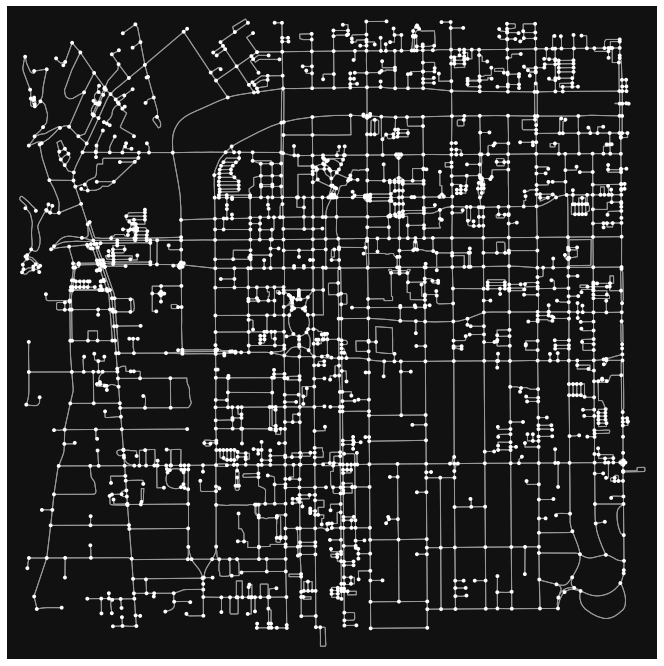

In [75]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [76]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [77]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [78]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
14963716,4.049279e+06,-1.315043e+07,traffic_signals,4,-118.132316,34.152361,POINT (-13150429.308 4049278.739)
6784510760,4.049278e+06,-1.315040e+07,NaN,3,-118.132087,34.152358,POINT (-13150403.793 4049278.403)
3892769467,4.049279e+06,-1.315045e+07,traffic_signals,4,-118.132468,34.152362,POINT (-13150446.139 4049278.941)
1995207967,4.049204e+06,-1.315043e+07,NaN,4,-118.132311,34.151805,POINT (-13150428.729 4049204.015)
6784510757,4.049306e+06,-1.315043e+07,NaN,3,-118.132316,34.152564,POINT (-13150429.308 4049306.141)


<AxesSubplot:>

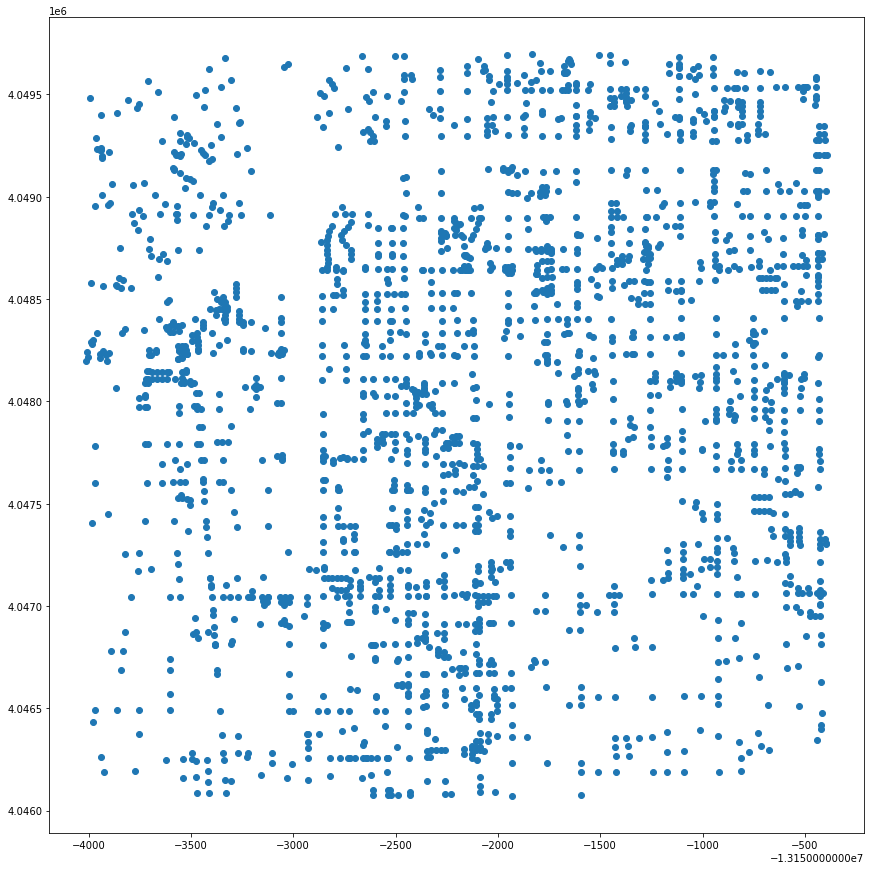

In [79]:
gdf_nodes.plot(figsize=(15,15))

In [80]:
gdf_edges.head()

osmid  oneway               name  \
u          v          key                                                      
14963716   6784510760 0                 405328940   False       Maple Street   
           3892769467 0                 607802969   False       Maple Street   
           1995207967 0    [173415946, 173415947]   False  North Lake Avenue   
           6784510757 0                 385937988   False  North Lake Avenue   
6784510760 14963716   0                 405328940   False       Maple Street   

                             highway  length  \
u          v          key                      
14963716   6784510760 0      primary  21.093   
           3892769467 0      primary  13.914   
           1995207967 0    secondary  61.772   
           6784510757 0    secondary  22.659   
6784510760 14963716   0      primary  21.093   

                                                                    geometry  \
u          v          key                                                      
14963716   6784510760 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           3892769467 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           1995207967 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           6784510757 0    LINESTRING (-13150429.308 4049278.739, -131504...   
6784510760 14963716   0    LINESTRING (-13150403.793 4049278.403, -131504...   

                          maxspeed bridge lanes access service  ref tunnel  \
u          v          key                                                    
14963716   6784510760 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           3892769467 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           1995207967 0     35 mph    yes   NaN    NaN     NaN  NaN    NaN   
           6784510757 0     35 mph    NaN     2    NaN     NaN  NaN    NaN   
6784510760 14963716   0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   

                          width  
u          v          key        
14963716   6784510760 0     NaN  
           3892769467 0     NaN  
           1995207967 0     NaN  
           6784510757 0     NaN  
6784510760 14963716   0     NaN

<AxesSubplot:>

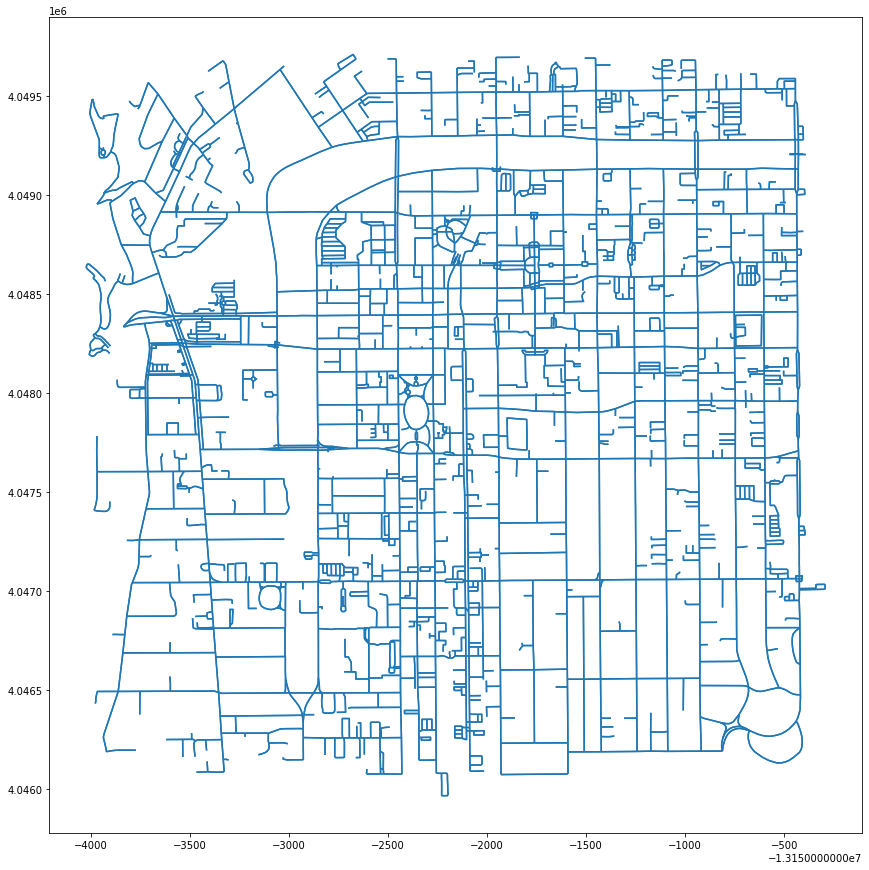

In [81]:
gdf_edges.plot(figsize=(15,15))

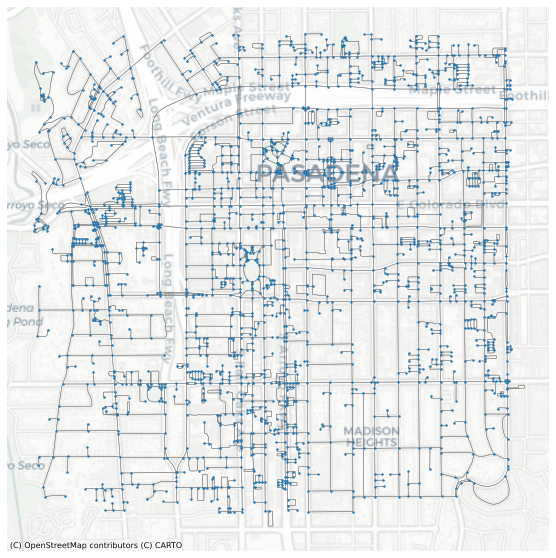

In [82]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [83]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13154010.901174664
4046072.998110596
-13150391.069632793
4049695.185661036


In [84]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13152200.985403728
4047884.0918858163


In [85]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 1995241213


In [86]:
# what is this record?
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
1995241213,4.047831e+06,-1.315221e+07,NaN,1,-118.148271,34.141596,POINT (-13152205.321 4047830.780)


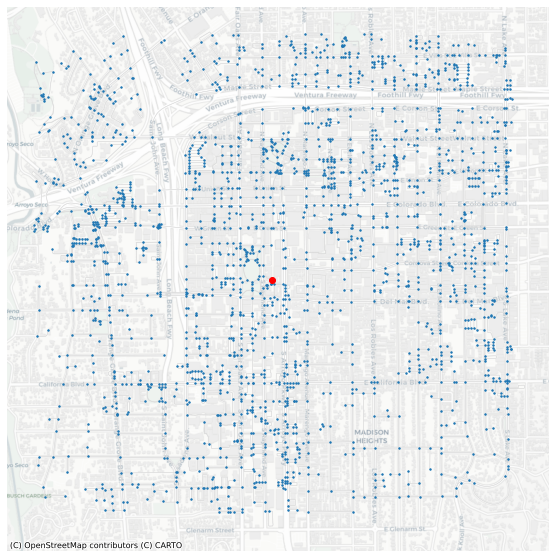

In [87]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [88]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width
u,v,key,,,,,,,,,,,,,,
123564808,122757972,0,405356561,False,Cordova Street,tertiary,125.994,"LINESTRING (-13151255.109 4047957.991, -131512...",35 mph,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5926575780,32581276,0,514095304,False,East California Boulevard,secondary,17.948,"LINESTRING (-13151410.077 4047056.152, -131514...",30 mph,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6817747257,6785064944,0,13444217,False,North El Molino Avenue,tertiary,22.341,"LINESTRING (-13150939.852 4048663.057, -131509...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6437110710,6437110714,0,686726207,False,NaN,service,75.843,"LINESTRING (-13152534.738 4046258.837, -131525...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5321222768,5321222765,0,550979156,False,NaN,footway,100.150,"LINESTRING (-13153181.059 4048115.251, -131530...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [89]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [90]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,,
5366500938,5366500937,0,556319542,False,NaN,footway,29.832,"LINESTRING (-13151619.514 4049545.167, -131516...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.372900
122663823,601848898,0,629463882,False,South El Molino Avenue,tertiary,64.908,"LINESTRING (-13150936.346 4048405.809, -131509...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.811350
122790547,122790546,0,167078565,False,South de Lacey Avenue,residential,24.541,"LINESTRING (-13152647.059 4048299.711, -131526...",NaN,NaN,2,NaN,NaN,NaN,NaN,NaN,0.306762
1687098880,1687098882,0,606872186,False,Corson Street,primary,41.338,"LINESTRING (-13152759.882 4048948.827, -131527...",35 mph,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.516725
5547461838,6792046347,0,60306241,False,West Walnut Street,secondary,62.687,"LINESTRING (-13153487.688 4048912.939, -131534...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.783587


In [91]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [92]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [93]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 1995241213, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 179 nodes within 10 minutes 


In [94]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
122646621,4.047666e+06,-1.315185e+07,NaN,3,-118.145076,34.140372,POINT (-13151849.722 4047666.099),10 mins,#0d0887
280556293,4.047688e+06,-1.315216e+07,NaN,3,-118.147905,34.140535,POINT (-13152164.612 4047688.076),10 mins,#0d0887
2028699207,4.047711e+06,-1.315286e+07,traffic_signals,4,-118.154108,34.140704,POINT (-13152855.104 4047710.752),NaN,NaN
6735902714,4.046788e+06,-1.315229e+07,NaN,1,-118.149040,34.133843,POINT (-13152291.026 4046788.007),NaN,NaN
1447280919,4.048389e+06,-1.315334e+07,NaN,3,-118.158424,34.145743,POINT (-13153335.637 4048388.539),NaN,NaN
7419081373,4.046908e+06,-1.315283e+07,NaN,1,-118.153914,34.134735,POINT (-13152833.497 4046908.078),NaN,NaN
3053019364,4.048658e+06,-1.315195e+07,crossing,4,-118.145977,34.147748,POINT (-13151949.977 4048658.255),NaN,NaN
4075599856,4.049204e+06,-1.315044e+07,NaN,4,-118.132451,34.151805,POINT (-13150444.336 4049204.015),NaN,NaN
1447282010,4.048485e+06,-1.315333e+07,NaN,3,-118.158387,34.146457,POINT (-13153331.474 4048484.684),NaN,NaN


In [95]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [96]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
4367112380,4.048249e+06,-1.315160e+07,NaN,1,-118.142854,34.144702,POINT (-13151602.326 4048248.504),NaN,#cccccc
5549289832,4.047137e+06,-1.315285e+07,NaN,3,-118.154074,34.136435,POINT (-13152851.375 4047136.699),NaN,#cccccc
29322329,4.047670e+06,-1.315093e+07,traffic_signals,4,-118.136849,34.140402,POINT (-13150933.930 4047670.161),NaN,#cccccc
8265630556,4.047818e+06,-1.315259e+07,NaN,1,-118.151718,34.141503,POINT (-13152589.084 4047818.244),NaN,#cccccc
8265630557,4.047797e+06,-1.315256e+07,NaN,3,-118.151491,34.141344,POINT (-13152563.826 4047796.899),NaN,#cccccc


<AxesSubplot:>

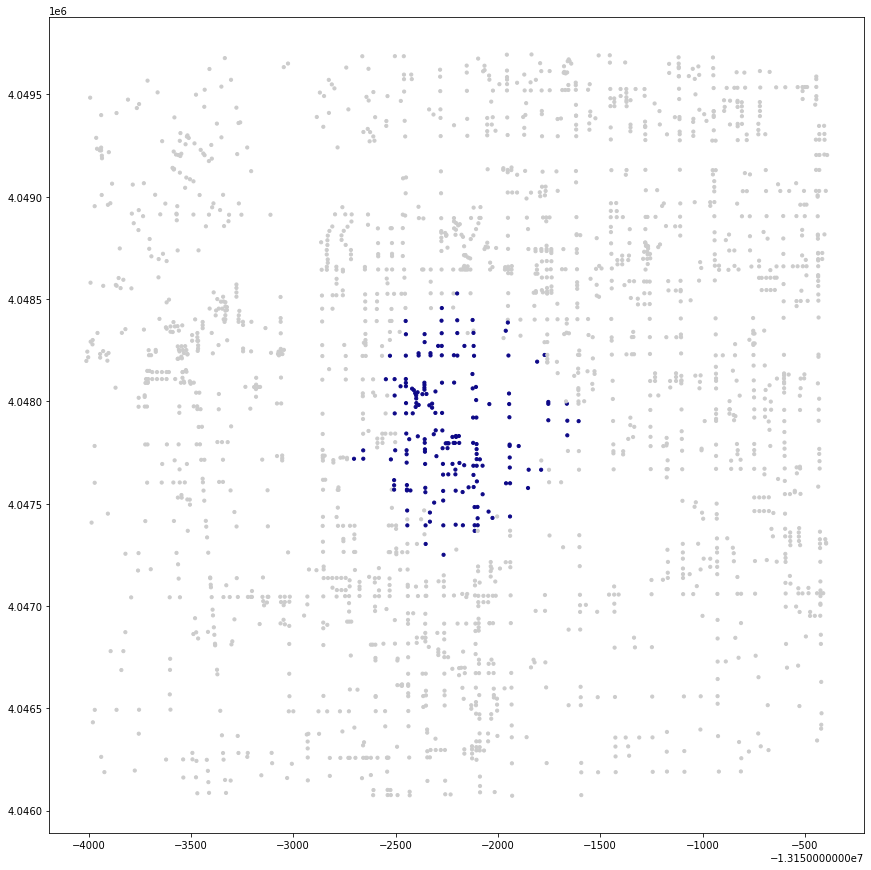

In [97]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

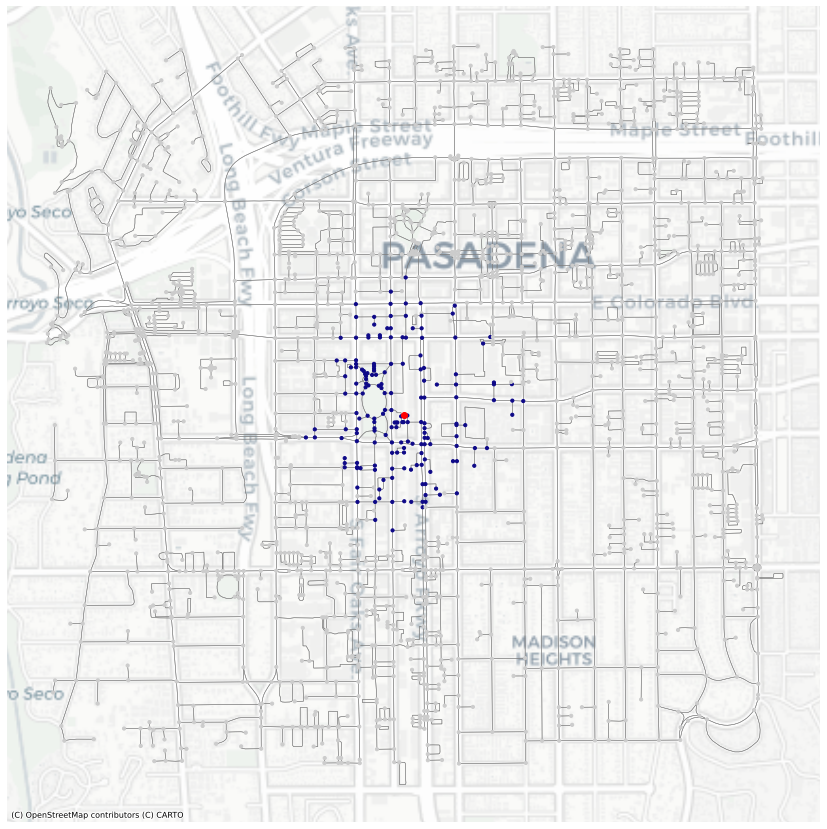

In [98]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[1995241213]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [99]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
16218739,4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,POINT (-13152450.736 4048392.897),10 mins,#0d0887
122575436,4.048394e+06,-1.315228e+07,traffic_signals,4,-118.148901,34.145787,POINT (-13152275.453 4048394.443),10 mins,#0d0887
122615775,4.048328e+06,-1.315245e+07,NaN,3,-118.150464,34.145293,POINT (-13152449.467 4048328.011),10 mins,#0d0887
29322322,4.047716e+06,-1.315252e+07,NaN,3,-118.151123,34.140746,POINT (-13152522.860 4047716.495),10 mins,#0d0887
725857496,4.047742e+06,-1.315245e+07,NaN,3,-118.150433,34.140933,POINT (-13152446.005 4047741.674),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8366502777,4.047717e+06,-1.315209e+07,NaN,3,-118.147218,34.140748,POINT (-13152088.124 4047716.737),10 mins,#0d0887
8366502785,4.047743e+06,-1.315210e+07,NaN,3,-118.147359,34.140944,POINT (-13152103.865 4047743.113),10 mins,#0d0887
8366502796,4.047767e+06,-1.315210e+07,NaN,3,-118.147361,34.141119,POINT (-13152104.009 4047766.677),10 mins,#0d0887


In [100]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

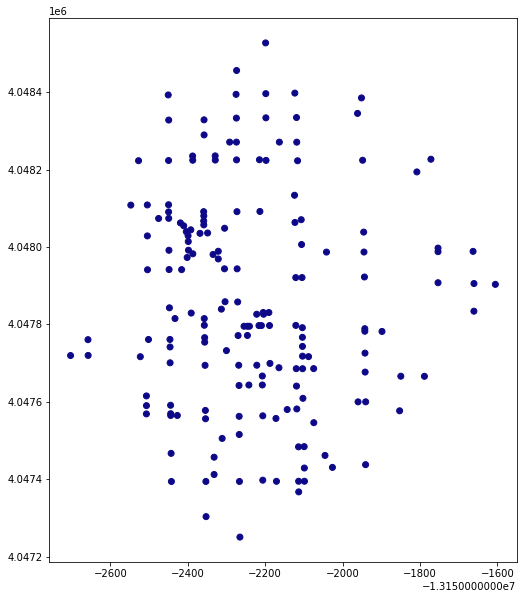

In [101]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

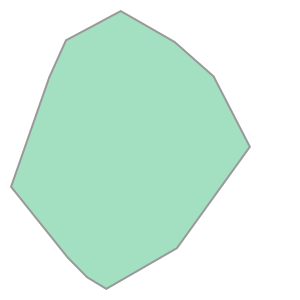

In [102]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [103]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13152703.098 4047719.535, -131526...",4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,#0d0887


In [104]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13152265.489 4047250.399, -13152352..."


In [105]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13152265.489 4047250.399, -13152352..."


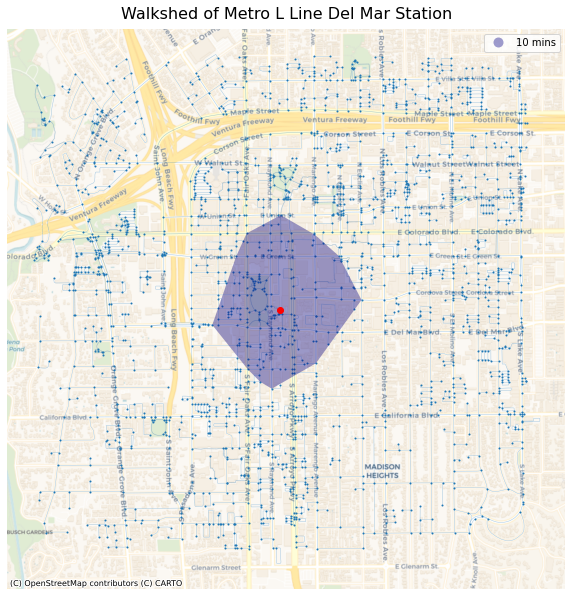

In [106]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Del Mar Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

And there we have it! The convex hull of the 10 minute walkshed from Del Mar Station. Time to move on to the ACS data.

<AxesSubplot:>

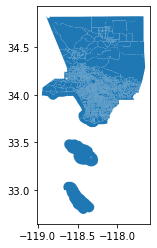

In [107]:
#Double checking our spatial data

gdf.plot()

In [108]:
# Quick peek at our data types, making sure our numbers a float types

gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2345 entries, 0 to 2344
Data columns (total 41 columns):
 #   Column                                          Non-Null Count  Dtype   
---  ------                                          --------------  -----   
 0   FIPS                                            2345 non-null   object  
 1   Census Tract                                    2345 non-null   object  
 2   11 Total Population                             2345 non-null   float64 
 3   11 Total Foreign Born                           2345 non-null   float64 
 4   11 Europe                                       2345 non-null   float64 
 5   11 Europe Entered 2000 or later                 2345 non-null   float64 
 6   11 Asia                                         2345 non-null   float64 
 7   11 Asia Entered 2000 or later                   2345 non-null   float64 
 8   11 Latin America                                2345 non-null   float64 
 9   11 Caribbean          

In [109]:
# And another peek at our data set again before moving on to mapping

gdf.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born
0,06037101110,"Census Tract 1011.10, Los Angeles, CA",5012.0,2027.0,93.0,15.0,1467.0,303.0,449.0,0.0,0.0,412.0,137.0,42.0,275.0,55.0,37.0,8.0,18.0,9.0,4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,8.0,0.0,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",-7.195213
1,06037101122,"Census Tract 1011.22, Los Angeles, CA",3584.0,1254.0,144.0,0.0,1026.0,87.0,66.0,8.0,0.0,46.0,34.0,0.0,12.0,0.0,12.0,0.0,18.0,0.0,3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,0.0,0.0,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",-11.200293
2,06037101210,"Census Tract 1012.10, Los Angeles, CA",6529.0,3471.0,39.0,0.0,1919.0,561.0,1458.0,0.0,0.0,1420.0,710.0,65.0,710.0,512.0,38.0,0.0,55.0,30.0,6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,19.0,0.0,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",-3.265223
3,06037101220,"Census Tract 1012.20, Los Angeles, CA",2751.0,1242.0,61.0,0.0,673.0,98.0,437.0,10.0,0.0,419.0,313.0,78.0,106.0,0.0,8.0,0.0,71.0,71.0,3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,41.0,0.0,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",2.097513
4,06037101300,"Census Tract 1013, Los Angeles, CA",4123.0,1374.0,97.0,0.0,1168.0,141.0,62.0,0.0,0.0,22.0,22.0,0.0,0.0,0.0,40.0,0.0,47.0,15.0,3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,0.0,0.0,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",9.362702


### Starting to Build Our Foreign Born Percent by Census Tract Map Layer

Our data is nice and neat, so let's move on to creating our final maps with overlays.

<AxesSubplot:>

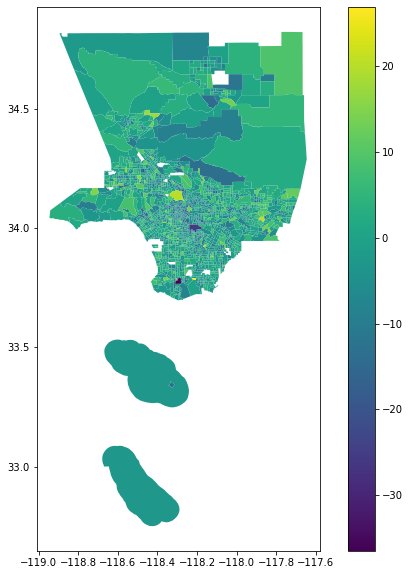

In [110]:
#Looking at our data as a choropleth for all of LA County

gdf.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [111]:
#Isolating our Del Mar Station walkshed census tracts

delmar = gdf[gdf["FIPS"].isin(['06037461902',  
                                '06037463602', 
                                '06037463700']
)
            ]

In [112]:
delmar.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born
1360,06037461902,"Census Tract 4619.02, Los Angeles, CA",1306.0,321.0,39.0,2.0,141.0,0.0,113.0,0.0,0.0,113.0,84.0,0.0,29.0,0.0,0.0,0.0,28.0,0.0,1801.0,586.0,265.0,46.0,38.0,468.0,227.0,44.0,0.0,0.0,28.0,28.0,0.0,0.0,0.0,16.0,0.0,28.0,0.0,"MULTIPOLYGON (((-118.15570 34.14973, -118.1554...",7.958612
1382,06037463602,"Census Tract 4636.02, Los Angeles, CA",5047.0,1613.0,327.0,108.0,851.0,234.0,345.0,86.0,0.0,166.0,78.0,14.0,88.0,52.0,93.0,33.0,90.0,28.0,6057.0,1926.0,818.0,145.0,72.0,1457.0,627.0,212.0,6.0,0.0,185.0,77.0,19.0,108.0,0.0,21.0,0.0,112.0,100.0,"MULTIPOLYGON (((-118.15046 34.14577, -118.1497...",-0.161660
1383,06037463700,"Census Tract 4637, Los Angeles, CA",2203.0,295.0,39.0,23.0,184.0,72.0,62.0,0.0,0.0,34.0,22.0,0.0,12.0,0.0,28.0,0.0,10.0,0.0,3138.0,602.0,126.0,108.0,39.0,314.0,79.0,126.0,0.0,0.0,101.0,61.0,0.0,40.0,0.0,25.0,8.0,54.0,0.0,"MULTIPOLYGON (((-118.16776 34.14147, -118.1676...",5.793363


<AxesSubplot:>

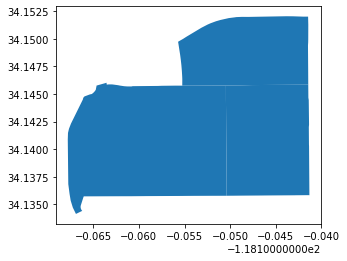

In [113]:
#Quick check to make sure it looks right

delmar.plot()

In [114]:
delmar.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 3 entries, 1360 to 1383
Data columns (total 41 columns):
 #   Column                                          Non-Null Count  Dtype   
---  ------                                          --------------  -----   
 0   FIPS                                            3 non-null      object  
 1   Census Tract                                    3 non-null      object  
 2   11 Total Population                             3 non-null      float64 
 3   11 Total Foreign Born                           3 non-null      float64 
 4   11 Europe                                       3 non-null      float64 
 5   11 Europe Entered 2000 or later                 3 non-null      float64 
 6   11 Asia                                         3 non-null      float64 
 7   11 Asia Entered 2000 or later                   3 non-null      float64 
 8   11 Latin America                                3 non-null      float64 
 9   11 Caribbean          

<AxesSubplot:>

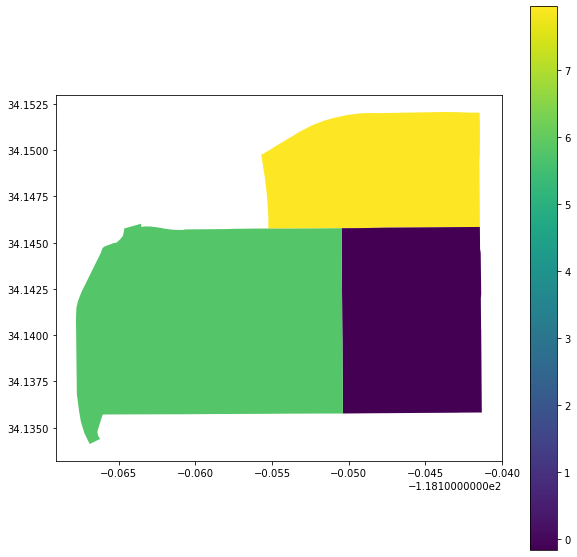

In [115]:
#Fairly narrow range of percentage foreign born here, with a noticeably higher percentage to the north

delmar.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

### Bringing it all together

First, let's project our map to web mercator

In [116]:
delmar_web_mercator = delmar.to_crs(epsg=3857)

Lets add a basemap and some details

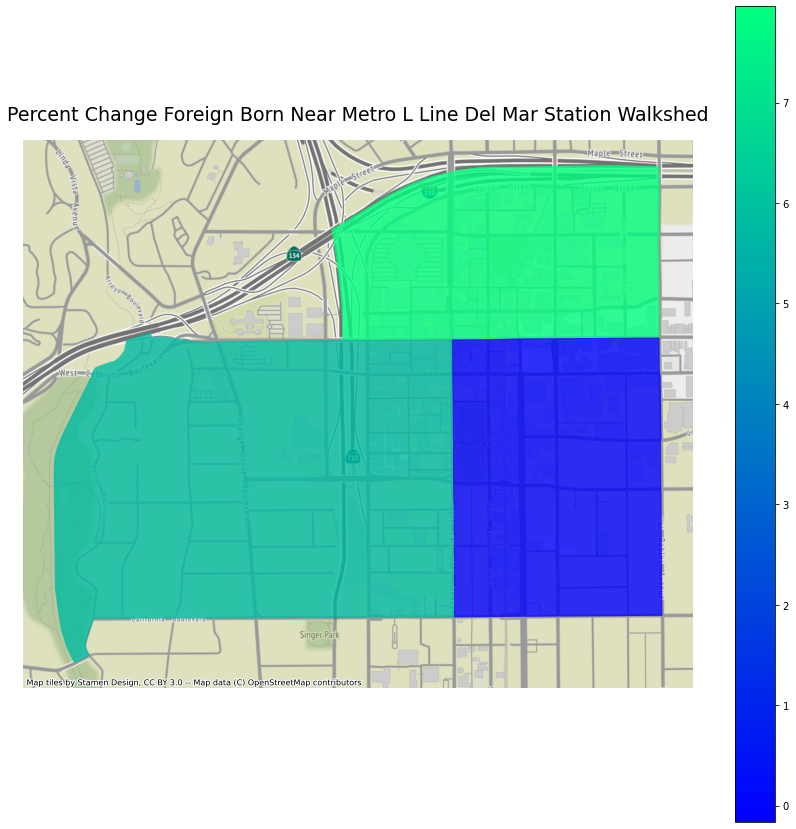

In [117]:
fig, ax = plt.subplots(figsize=(15, 15))
 
delmar_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8, 
                    cmap="winter")

ax.axis('off')

ax.set_title('Percent Change Foreign Born Near Metro L Line Del Mar Station Walkshed',fontsize=19, pad=20)

ctx.add_basemap(ax,source=ctx.providers.Stamen.Terrain)
#how can we add a legend and bins to this?

Looking good! Let's layer the isochrone layer on top to show us the walkshed from Del Mar Station

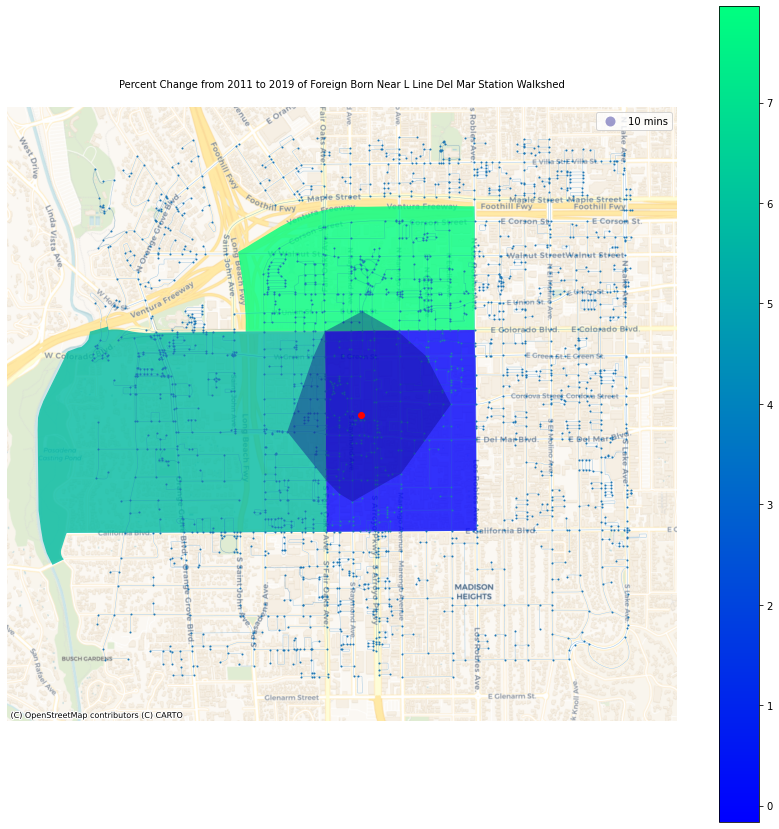

In [118]:
fig, ax = plt.subplots(figsize=(15, 15))
 
delmar_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8, 
                    cmap="winter")

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Del Mar Station Walkshed',fontsize=10, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

We see an increase in foreign born population to the north of the station, and very little change immediately around the station. There is more multi-family housing in the dark blue census tract which typically is more affordable, yet we see very little foreign born populations entering this area. The tract to the east of the station saw a relatively moderate increase in foreign born population. This tract has more single family homes and considerably higher property values, along with an archery range, country club, and the Rose Bowl Parade headquarters. This implies that more affluent foreign born populations moved to this part of the walkshed. 

### Percentage of Foreign Born Population in Metro L Line Chinatown Station Walkshed

Let's create a choropleth map of the Chinatown Station showing the percent Foreign Born population within the station walkshed. Just as we did before, we begin by first creating an isochrone walkshed map. 

In [119]:
address = 'Chinatown Station, College Street, New Chinatown, Chinatown, Los Angeles, Los Angeles County, California, 90012, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [120]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 6.7 s, sys: 110 ms, total: 6.81 s
Wall time: 7 s


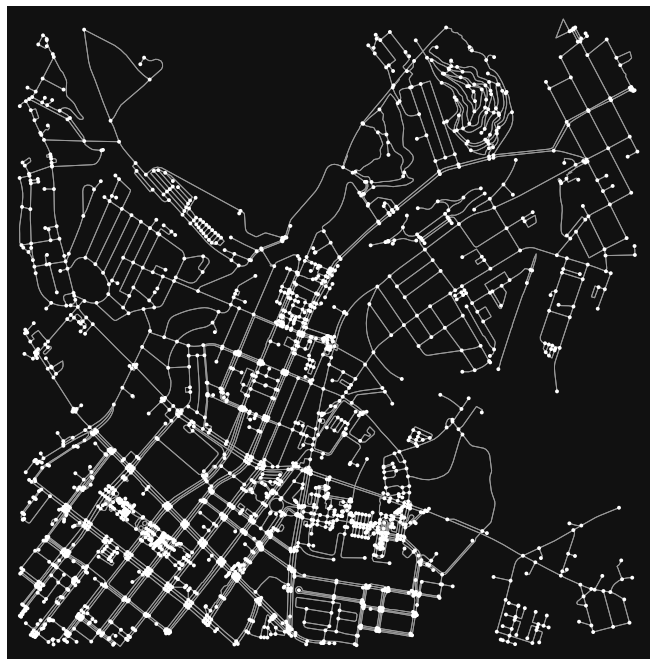

In [121]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [122]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [123]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [124]:
gdf_nodes.head()

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
15027548,4.039027e+06,-1.316061e+07,3,-118.223785,34.076114,NaN,POINT (-13160611.557 4039026.875)
67619407,4.039118e+06,-1.316050e+07,4,-118.222746,34.076796,traffic_signals,POINT (-13160495.907 4039118.493)
123283621,4.038908e+06,-1.316055e+07,3,-118.223245,34.075226,NaN,POINT (-13160551.456 4038907.559)
15027549,4.038710e+06,-1.316045e+07,4,-118.222311,34.073758,traffic_signals,POINT (-13160447.416 4038710.296)
3723806094,4.038716e+06,-1.316045e+07,4,-118.222338,34.073802,NaN,POINT (-13160450.467 4038716.075)


### Plotting the station area

<AxesSubplot:>

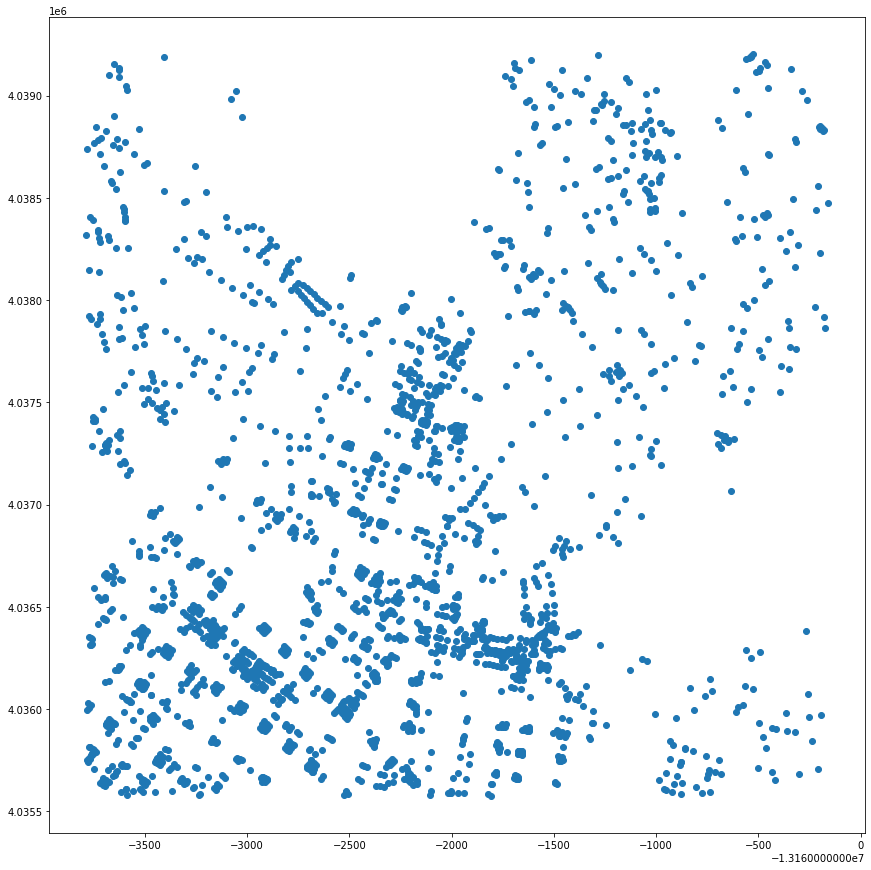

In [125]:
gdf_nodes.plot(figsize=(15,15))

In [126]:
gdf_edges.head()

osmid               name    highway  oneway  \
u        v          key                                                    
15027548 67619407   0      9126419    Humboldt Street   tertiary   False   
         123283621  0    358037415          Avenue 19   tertiary   False   
67619407 7871476832 0      9126419    Humboldt Street   tertiary   False   
         6787624912 0    398398790  San Fernando Road  secondary   False   
         15027548   0      9126419    Humboldt Street   tertiary   False   

                          length  \
u        v          key            
15027548 67619407   0    122.072   
         123283621  0    110.537   
67619407 7871476832 0     41.864   
         6787624912 0     67.319   
         15027548   0    122.072   

                                                                  geometry  \
u        v          key                                                      
15027548 67619407   0    LINESTRING (-13160611.557 4039026.875, -131605...   
         123283621  0    LINESTRING (-13160611.557 4039026.875, -131606...   
67619407 7871476832 0    LINESTRING (-13160495.907 4039118.493, -131604...   
         6787624912 0    LINESTRING (-13160495.907 4039118.493, -131605...   
         15027548   0    LINESTRING (-13160495.907 4039118.493, -131605...   

                        lanes maxspeed bridge service access tunnel width  
u        v          key                                                    
15027548 67619407   0     NaN      NaN    NaN     NaN    NaN    NaN   NaN  
         123283621  0       2      NaN    NaN     NaN    NaN    NaN   NaN  
67619407 7871476832 0     NaN      NaN    NaN     NaN    NaN    NaN   NaN  
         6787624912 0       4      NaN    NaN     NaN    NaN    NaN   NaN  
         15027548   0     NaN      NaN    NaN     NaN    NaN    NaN   NaN

<AxesSubplot:>

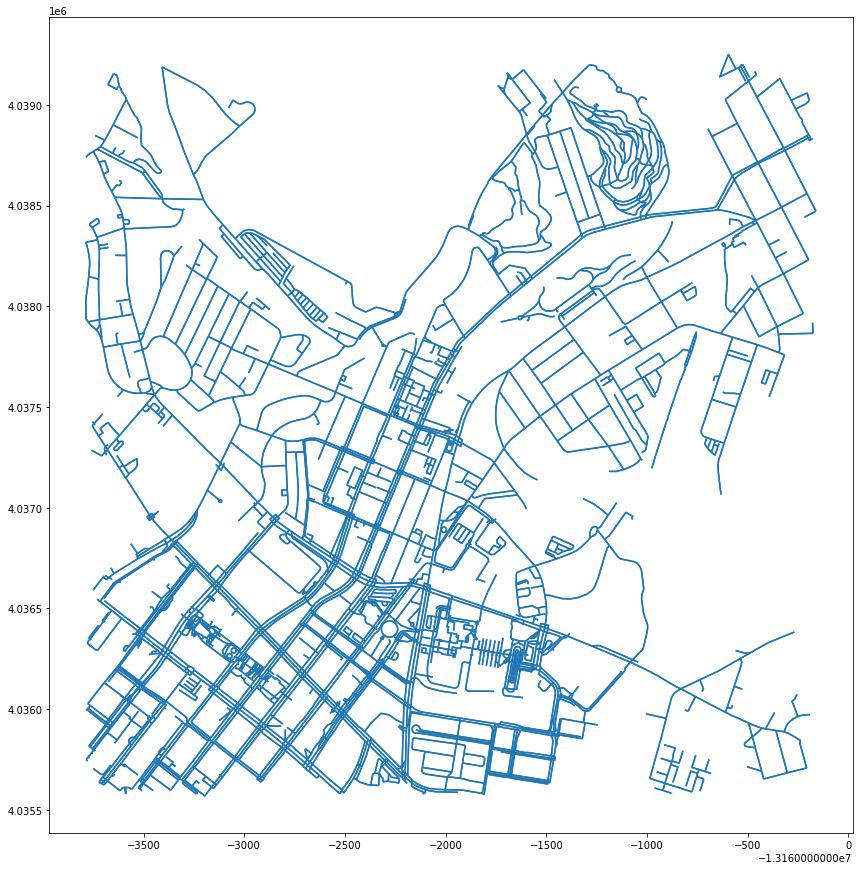

In [127]:
gdf_edges.plot(figsize=(15,15))

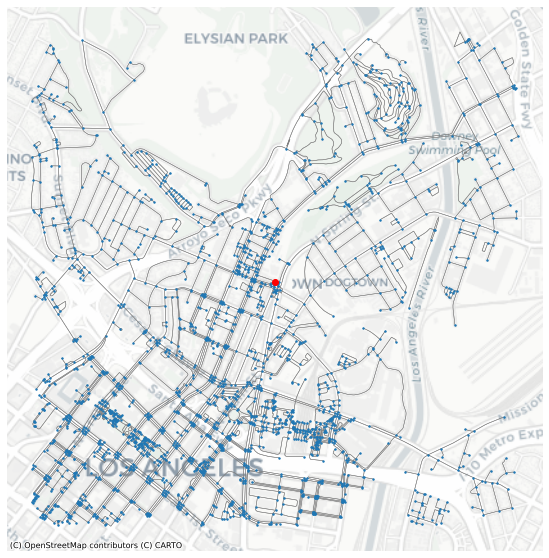

In [128]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[8290553634]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [129]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,bridge,service,access,tunnel,width
u,v,key,,,,,,,,,,,,,
9464527557,9464527561,0,"[1026531897, 1026531901]",NaN,footway,False,141.296,"LINESTRING (-13161527.605 4036207.029, -131614...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
8290553630,8290553631,0,892008506,NaN,steps,False,18.113,"LINESTRING (-13161982.401 4037368.077, -131619...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1967647116,1842185978,0,"[173394030, 199478046]",NaN,"[track, path]",False,178.453,"LINESTRING (-13161338.930 4039085.068, -131613...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
7882430703,7882430709,0,844893672,NaN,service,False,17.669,"LINESTRING (-13161193.780 4037646.549, -131611...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
6699521858,2889717986,0,285298338,NaN,footway,False,7.061,"LINESTRING (-13163652.828 4035933.214, -131636...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [130]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [131]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,bridge,service,access,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,
9029665577,6471204769,0,975793196,NaN,footway,False,99.820,"LINESTRING (-13162890.835 4035916.581, -131628...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.247750
68965696,1994531073,0,173261602,North Main Street,secondary,False,105.908,"LINESTRING (-13160452.515 4037809.338, -131604...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.323850
2889730936,3259253717,0,285298960,NaN,footway,False,14.243,"LINESTRING (-13163440.386 4035949.996, -131634...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.178038
123342065,123717449,0,13457374,Everett Place,residential,False,52.052,"LINESTRING (-13163349.727 4038250.226, -131633...",2,NaN,NaN,NaN,NaN,NaN,NaN,0.650650
6883792659,6883792657,0,978305961,NaN,footway,False,15.069,"LINESTRING (-13162201.300 4035682.851, -131621...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.188363


In [132]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [133]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [134]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 8290553634, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 173 nodes within 10 minutes 


In [135]:
gdf_nodes.sample(30)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
250637533,4.036757e+06,-1.316258e+07,3,-118.241433,34.059221,NaN,POINT (-13162576.168 4036756.748),NaN,NaN
6385294187,4.035711e+06,-1.316212e+07,3,-118.237297,34.051435,NaN,POINT (-13162115.728 4035710.583),NaN,NaN
3297494625,4.035663e+06,-1.316370e+07,5,-118.251559,34.051081,NaN,POINT (-13163703.356 4035663.034),NaN,NaN
123048024,4.039028e+06,-1.316359e+07,3,-118.250501,34.076121,NaN,POINT (-13163585.591 4039027.842),NaN,NaN
8873804552,4.036046e+06,-1.316283e+07,3,-118.243730,34.053934,NaN,POINT (-13162831.858 4036046.305),NaN,NaN
250634049,4.036954e+06,-1.316346e+07,4,-118.249409,34.060691,NaN,POINT (-13163464.052 4036954.313),NaN,NaN
122601075,4.035708e+06,-1.316021e+07,4,-118.220154,34.051415,NaN,POINT (-13160207.367 4035707.869),NaN,NaN
9438227514,4.035894e+06,-1.316162e+07,3,-118.232840,34.052803,NaN,POINT (-13161619.577 4035894.371),NaN,NaN
339135503,4.036088e+06,-1.316176e+07,1,-118.234108,34.054245,NaN,POINT (-13161760.686 4036088.172),NaN,NaN


In [136]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [137]:
gdf_nodes.sample(5)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
1967655356,4.036201e+06,-1.316241e+07,3,-118.239943,34.055084,NaN,POINT (-13162410.235 4036200.929),NaN,#cccccc
605023298,4.035593e+06,-1.316074e+07,1,-118.224914,34.050557,NaN,POINT (-13160737.181 4035592.591),NaN,#cccccc
8881484977,4.036397e+06,-1.316254e+07,4,-118.241128,34.056544,crossing,POINT (-13162542.171 4036397.033),NaN,#cccccc
3898644903,4.036109e+06,-1.316294e+07,3,-118.244677,34.054402,NaN,POINT (-13162937.188 4036109.213),NaN,#cccccc
8409457169,4.037488e+06,-1.316217e+07,3,-118.237797,34.064661,NaN,POINT (-13162171.299 4037487.673),10 mins,#0d0887


<AxesSubplot:>

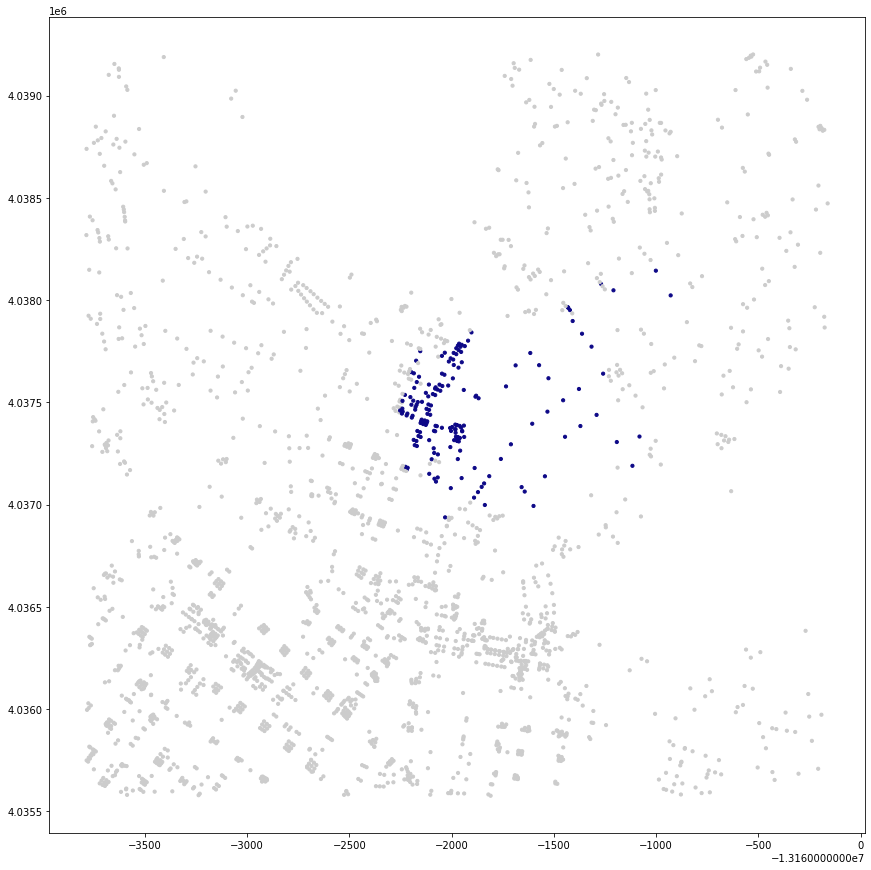

In [138]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

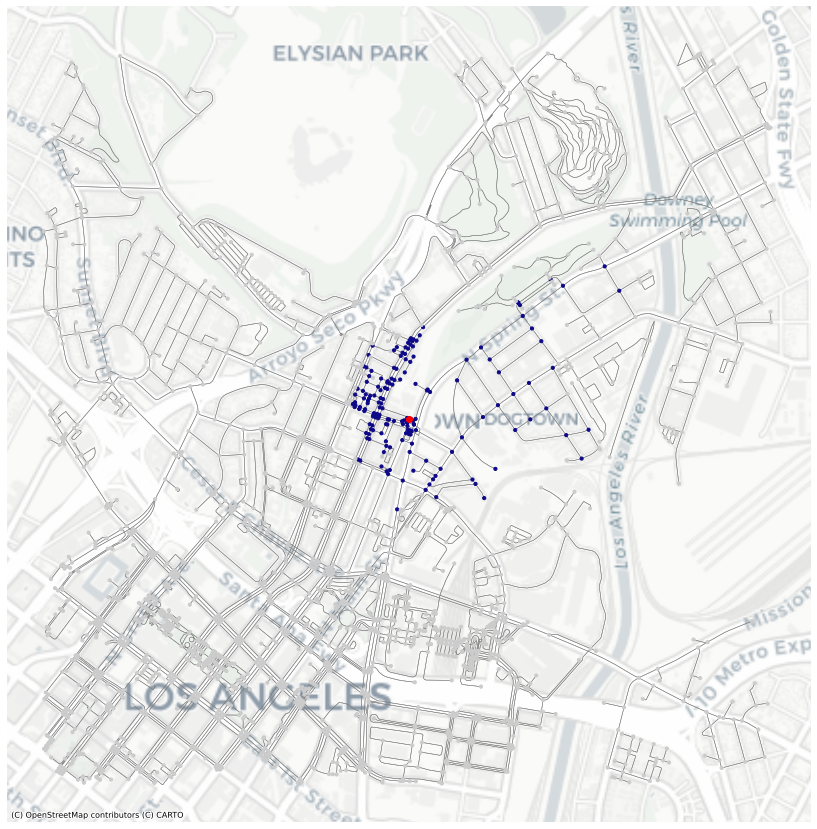

In [139]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[8290553634]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [140]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
15717265,4.038144e+06,-1.316100e+07,4,-118.227285,34.069542,traffic_signals,POINT (-13161001.164 4038143.644),10 mins,#0d0887
122656713,4.038023e+06,-1.316093e+07,4,-118.226635,34.068642,NaN,POINT (-13160928.751 4038022.752),10 mins,#0d0887
123037729,4.038048e+06,-1.316121e+07,4,-118.229147,34.068827,NaN,POINT (-13161208.430 4038047.599),10 mins,#0d0887
17677673,4.037351e+06,-1.316198e+07,3,-118.236082,34.063645,NaN,POINT (-13161980.397 4037351.213),10 mins,#0d0887
67619377,4.037281e+06,-1.316201e+07,3,-118.236313,34.063122,NaN,POINT (-13162006.145 4037280.975),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8409454505,4.037529e+06,-1.316211e+07,1,-118.237282,34.064967,NaN,POINT (-13162114.070 4037528.873),10 mins,#0d0887
8409457169,4.037488e+06,-1.316217e+07,3,-118.237797,34.064661,NaN,POINT (-13162171.299 4037487.673),10 mins,#0d0887
8409457171,4.037477e+06,-1.316218e+07,1,-118.237841,34.064580,NaN,POINT (-13162176.286 4037476.802),10 mins,#0d0887


In [141]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

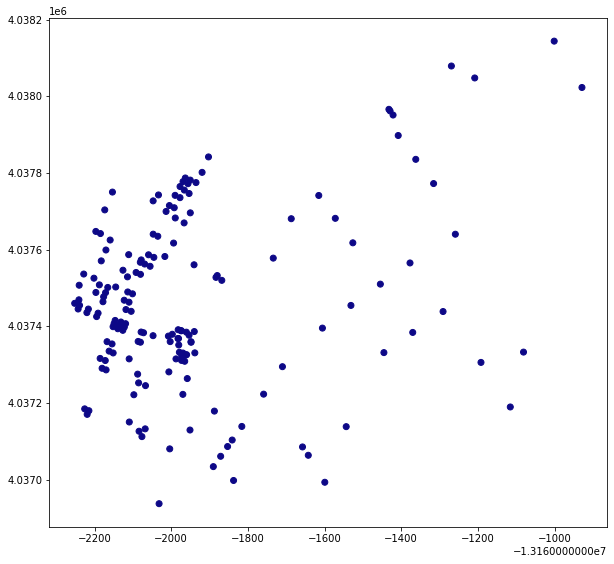

In [142]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

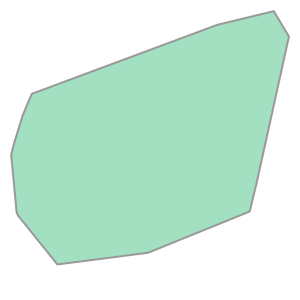

In [143]:
gdf_10.unary_union.convex_hull

In [144]:
# Getting a oblong asymmetrical shape here. Code seems right so there's something up here... Maybe it has to do with osmnx? Or maybe it's just the topology of the station area?

isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,street_count,lon,lat,highway,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13162251.772 4037459.803, -131622...",4.038144e+06,-1.316100e+07,4,-118.227285,34.069542,traffic_signals,#0d0887


In [145]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13162031.671 4036937.288, -13162219..."


In [146]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13162031.671 4036937.288, -13162219..."


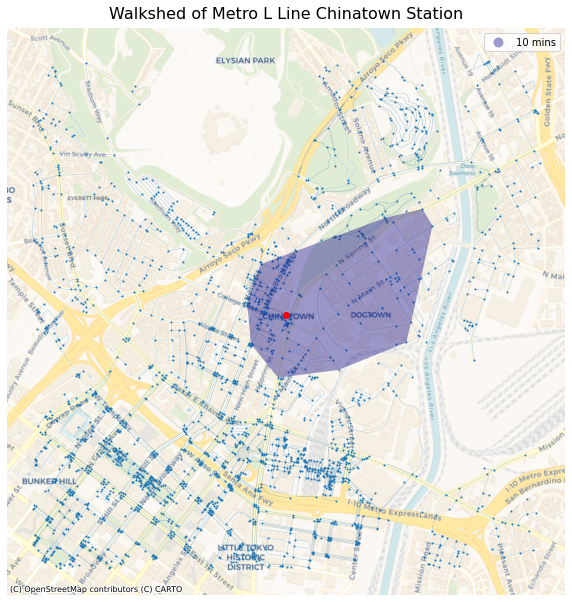

In [147]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[8290553634]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Chinatown Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

### Choropleth map of percent foreign born in the Chinatown Station walkshed

Now we pivot to create the choropleth map of the percent foreign born in the census tracts in our station walkshed.

### Isolating Our Chinatown Walkshed

Based on the walk shed map we created, we use its nodes to cross reference a census tract map and identify the tracts in our walkshed. We now isolate those tracts into its own variable.

In [148]:
Chinatown = gdf[gdf["FIPS"].isin(['06037206010', 
                                       '06037207103', 
                                       '06037207102',
                                       '06037206020']
                                      )
                     ]

In [149]:
Chinatown.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born
529,06037206010,"Census Tract 2060.10, Los Angeles, CA",2947.0,1661.0,18.0,0.0,926.0,290.0,714.0,11.0,0.0,703.0,635.0,29.0,68.0,0.0,0.0,0.0,3.0,3.0,4121.0,2059.0,238.0,10.0,0.0,1135.0,225.0,914.0,0.0,0.0,914.0,748.0,13.0,166.0,0.0,0.0,0.0,0.0,0.0,"MULTIPOLYGON (((-118.23924 34.06726, -118.2380...",-6.398801
530,06037206020,"Census Tract 2060.20, Los Angeles, CA",7677.0,1404.0,14.0,0.0,189.0,17.0,1187.0,55.0,24.0,1099.0,773.0,153.0,326.0,72.0,33.0,0.0,14.0,9.0,8947.0,1074.0,113.0,116.0,15.0,242.0,54.0,696.0,7.0,7.0,680.0,448.0,14.0,232.0,23.0,9.0,0.0,20.0,0.0,"MULTIPOLYGON (((-118.23787 34.05427, -118.2378...",-6.284370
537,06037207102,"Census Tract 2071.02, Los Angeles, CA",2276.0,1753.0,1.0,0.0,1592.0,799.0,160.0,38.0,0.0,102.0,72.0,0.0,30.0,0.0,20.0,0.0,0.0,0.0,2926.0,1837.0,114.0,50.0,29.0,1465.0,71.0,321.0,1.0,1.0,295.0,181.0,0.0,114.0,0.0,25.0,13.0,1.0,0.0,"MULTIPOLYGON (((-118.24303 34.05735, -118.2429...",-14.239135
538,06037207103,"Census Tract 2071.03, Los Angeles, CA",2098.0,1728.0,0.0,0.0,1688.0,626.0,22.0,0.0,0.0,22.0,22.0,0.0,0.0,0.0,0.0,0.0,18.0,18.0,2393.0,1649.0,411.0,16.0,11.0,1551.0,389.0,76.0,6.0,0.0,30.0,12.0,0.0,18.0,0.0,40.0,11.0,6.0,0.0,"MULTIPOLYGON (((-118.24557 34.06470, -118.2454...",-13.454837


<AxesSubplot:>

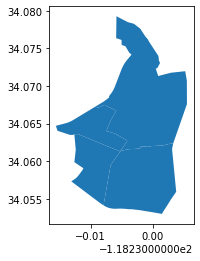

In [150]:
Chinatown.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

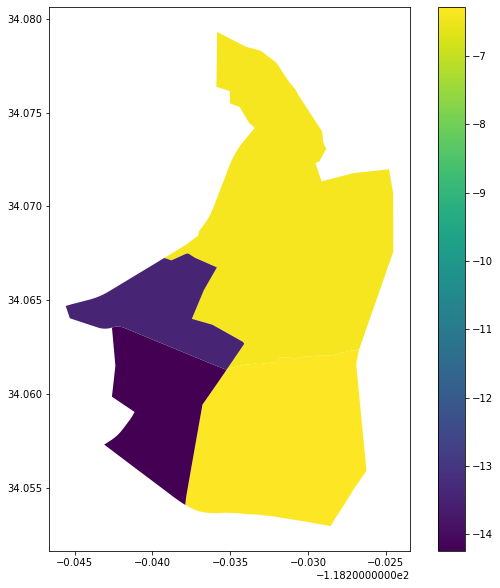

In [151]:
Chinatown.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

Wow, the darker blue census tracts saw a 12%-14% decrease in foreign born residents. It’s hard to tell, but the yellow polygon is actually two census tracts. Let's add some map details like titles and a basemap.

### Adding a base map and map details

We first have to project our data to web mercator.

In [152]:
Chinatown_web_mercator = Chinatown.to_crs(epsg=3857)

Now we can tap into adding map details and our basemap.

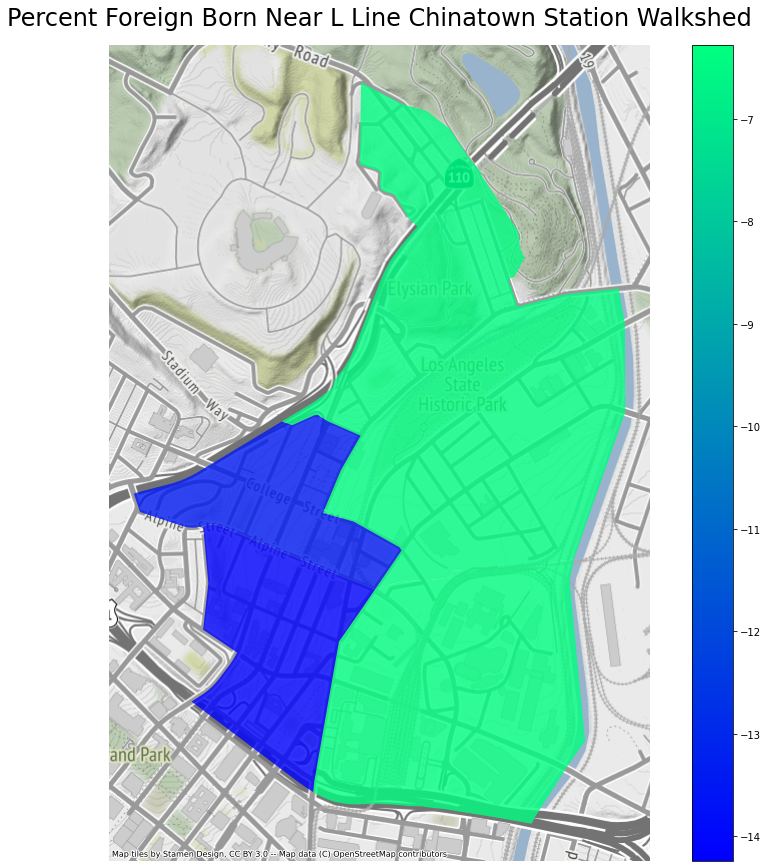

In [153]:
fig, ax = plt.subplots(figsize=(15, 15))
 
Chinatown_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8, 
                    cmap="winter")

ax.axis('off')

ax.set_title('Percent Foreign Born Near L Line Chinatown Station Walkshed',fontsize=24, pad=20)

ctx.add_basemap(ax,source=ctx.providers.Stamen.Terrain)

Nice! Let's layer our isochrone map with our choropleth map.

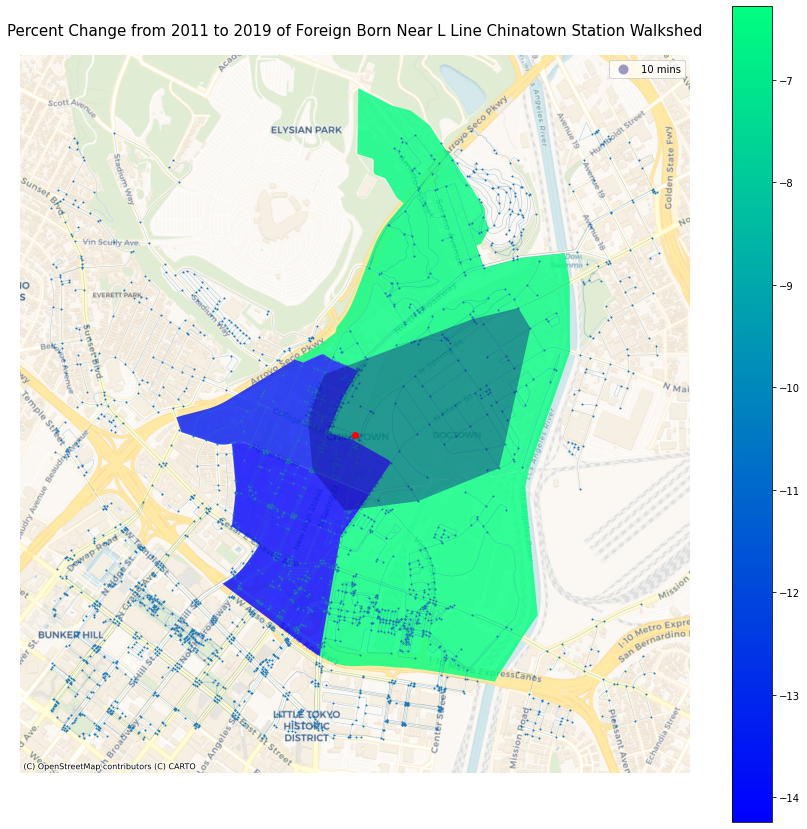

In [154]:
fig, ax = plt.subplots(figsize=(15, 15))
 
Chinatown_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8, 
                    cmap="winter")

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[8290553634]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Chinatown Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

This tells a different story than the Del Mar Station. Whereas Del Mar Station saw either no or up to a 7% increase in foreign born populations, Chinatown Station saw at least a 7% *decrease* in every census tract in its walkshed. The stations that saw the largest decrease are adjacent to the gentrifying neighborhoods of Angelino Heights, Echo Park, and Downtown LA. Their immediate proximity to these neighborhoods could have added additional pressures that made the decrease in foreign born residents larger than the other census tracts in the Chinatown Station walkshed.

## Plotly Bar Charts to Explore Our Data in a Different Way


Using a function and for loop for each station area, we used plotly to create bar graphs to show trends in foreign born populations in each station walkshed, and also the broader neighborhood/city. We trimmed and manipulated our data to show each ethnicity's population as a percentage relative to the total number of foreign born residents in the station area and/or neighborhood. We then re-organized the data into a Pandas DataFrame so that we had a column of all of the ethnicities, and a column each for the years of entry.

In [155]:
# Listing out our station areas as FIPS codes to feed into a function for loop

delmar = ['06037461902', '06037463602', '06037463700']

In [156]:
chinatown = ['06037206010', '06037207103', '06037207102', '06037206020']

In [157]:
# Ok let's take a stab at making a function to trim our data to give us the above table for each station

def stn_chart19(stop): 
    # Using .isin to single out the rows we want
    df = gdf[gdf["FIPS"].isin(stop)]
    
    df = df.append(df.sum(numeric_only=True), ignore_index=True)
    
    
     # Keeping only summation row
    df = df.iloc[-1:]
    
    
    # Creating percentages
    df['Foreign Born'] = df['19 Total Foreign Born']/df['19 Total Population']*100
    df['Europe'] = df['19 Europe']/df['19 Total Population']*100
    df['Asia'] = df['19 Asia']/df['19 Total Population']*100
    df['Latin America'] = df['19 Latin America']/df['19 Total Population']*100
    df['Caribbean'] = df['19 Caribbean']/df['19 Total Population']*100
    df['Central America'] = df['19 Central America']/df['19 Total Population']*100
    df['Mexico'] = df['19 Mexico']/df['19 Total Population']*100
    df['Other Central America'] = df['19 Other Central America']/df['19 Total Population']*100
    df['South America'] = df['19 South America']/df['19 Total Population']*100
    df['Other Areas'] = df['19 Other Areas Entered 2010 or later']/df['19 Total Population']*100

    
    # Flipping rows and columns
    df = df.transpose()
    
    # Reseting index
    df = df.reset_index()
    
    # Renaming columns
    df.columns = ['Country of Origin', 'Percentage of Total Foreign Born']
    
    # Keeping only the percentage rows
    df = df.drop(df.index[0:41])
    
    display(df)
    
    # Plotting
    
    graph = px.bar(df, x="Country of Origin", y="Percentage of Total Foreign Born", 
                   title=('Foreign Born Population Breakdown')
        )
    
    display(graph)


,Country of Origin,Percentage of Total Foreign Born
41,Foreign Born,28.319389
42,Europe,2.719171
43,Asia,20.36195
44,Latin America,3.473991
45,Caribbean,0.054565
46,Central America,2.855584
47,Mexico,1.50964
48,Other Central America,1.345944
49,South America,0.563841
50,Other Areas,0.909422


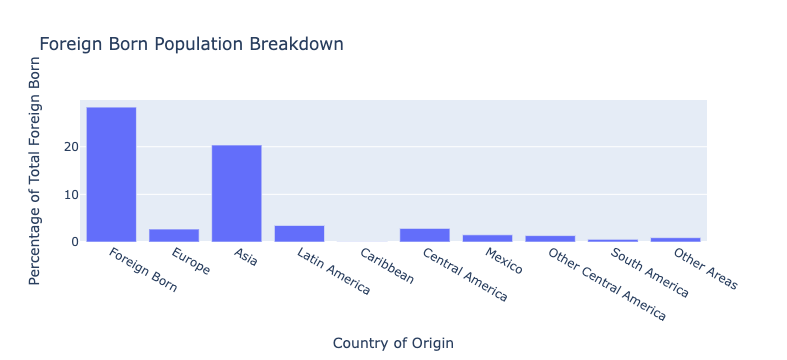

In [158]:
# Function testing before the for loop

stn_chart19(stop = delmar) 

,Country of Origin,Percentage of Total Foreign Born
41,Foreign Born,35.99826
42,Europe,1.044216
43,Asia,23.89188
44,Latin America,10.915321
45,Caribbean,0.076141
46,Central America,10.436722
47,Mexico,7.55425
48,Other Central America,2.882471
49,South America,0.402458
50,Other Areas,0.0


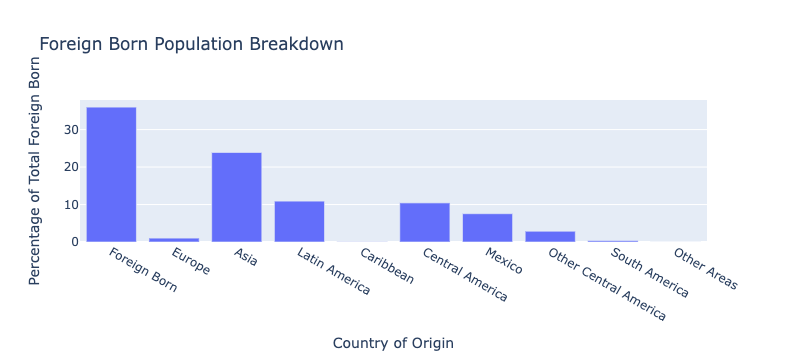

In [159]:
stn_chart19(stop=chinatown)

,Country of Origin,Percentage of Total Foreign Born
41,Foreign Born,28.319389
42,Europe,2.719171
43,Asia,20.36195
44,Latin America,3.473991
45,Caribbean,0.054565
46,Central America,2.855584
47,Mexico,1.50964
48,Other Central America,1.345944
49,South America,0.563841
50,Other Areas,0.909422


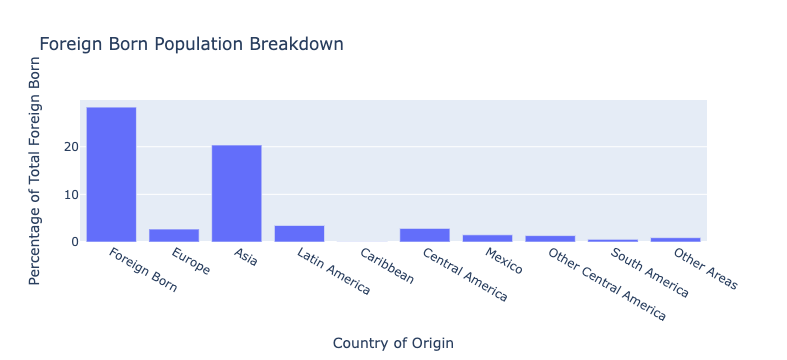

,Country of Origin,Percentage of Total Foreign Born
41,Foreign Born,35.99826
42,Europe,1.044216
43,Asia,23.89188
44,Latin America,10.915321
45,Caribbean,0.076141
46,Central America,10.436722
47,Mexico,7.55425
48,Other Central America,2.882471
49,South America,0.402458
50,Other Areas,0.0


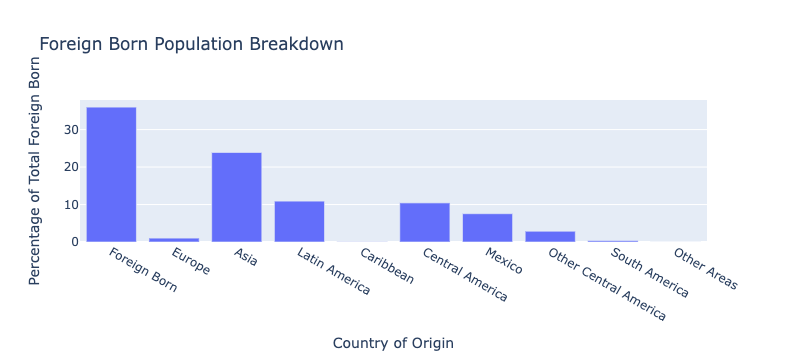

In [160]:
# Here's our for loop which we hope to feed more stations into

# list of neighborhoods
stations = [delmar, chinatown]

# call the function with a loop
for station in stations:
        stn_chart19(stop=station)

## Interactive Map of Foreign Born in Pasadena and Chinatown

We are interested in creating a map that shows the percent of foreign born in our entire neighborhoods, Chinatown and Pasadena.  

### Importing plotly

To create our interactive map, we'll use plotly.

In [161]:
# for interactive plots
import plotly.express as px

First, we calculate the percentage of each ethnicity relative to the total population of its census tract, and add this to our geodataframe.

In [162]:
gdf.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born
0,06037101110,"Census Tract 1011.10, Los Angeles, CA",5012.0,2027.0,93.0,15.0,1467.0,303.0,449.0,0.0,0.0,412.0,137.0,42.0,275.0,55.0,37.0,8.0,18.0,9.0,4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,8.0,0.0,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",-7.195213
1,06037101122,"Census Tract 1011.22, Los Angeles, CA",3584.0,1254.0,144.0,0.0,1026.0,87.0,66.0,8.0,0.0,46.0,34.0,0.0,12.0,0.0,12.0,0.0,18.0,0.0,3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,0.0,0.0,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",-11.200293
2,06037101210,"Census Tract 1012.10, Los Angeles, CA",6529.0,3471.0,39.0,0.0,1919.0,561.0,1458.0,0.0,0.0,1420.0,710.0,65.0,710.0,512.0,38.0,0.0,55.0,30.0,6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,19.0,0.0,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",-3.265223
3,06037101220,"Census Tract 1012.20, Los Angeles, CA",2751.0,1242.0,61.0,0.0,673.0,98.0,437.0,10.0,0.0,419.0,313.0,78.0,106.0,0.0,8.0,0.0,71.0,71.0,3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,41.0,0.0,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",2.097513
4,06037101300,"Census Tract 1013, Los Angeles, CA",4123.0,1374.0,97.0,0.0,1168.0,141.0,62.0,0.0,0.0,22.0,22.0,0.0,0.0,0.0,40.0,0.0,47.0,15.0,3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,0.0,0.0,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",9.362702


In [163]:
Per_Europe = (gdf['19 Europe']/gdf['19 Total Population'])*100
Per_Asia = (gdf['19 Asia']/gdf['19 Total Population'])*100
Per_Latin_America = (gdf['19 Latin America']/gdf['19 Total Population'])*100
Per_Caribbean = (gdf['19 Caribbean']/gdf['19 Total Population'])*100
Per_Central_America = (gdf['19 Central America']/gdf['19 Total Population'])*100
Per_Mexico = (gdf['19 Mexico']/gdf['19 Total Population'])*100
Per_Other_Central_America = (gdf['19 Other Central America']/gdf['19 Total Population'])*100
Per_South_America = (gdf['19 South America']/gdf['19 Total Population'])*100
Per_Other_Areas = (gdf['19 Other Areas']/gdf['19 Total Population'])*100

In [164]:
gdf['% Europe'] = Per_Europe
gdf['% Asia'] = Per_Asia
gdf['% Latin America'] = Per_Latin_America
gdf['% Caribbean'] = Per_Caribbean
gdf['% Central America'] = Per_Central_America
gdf['% Mexico'] = Per_Mexico
gdf['% Other Central America'] = Per_Other_Central_America
gdf['% South America'] = Per_South_America
gdf['% Other Areas'] = Per_Other_Areas

In [165]:
gdf.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born,% Europe,% Asia,% Latin America,% Caribbean,% Central America,% Mexico,% Other Central America,% South America,% Other Areas
0,06037101110,"Census Tract 1011.10, Los Angeles, CA",5012.0,2027.0,93.0,15.0,1467.0,303.0,449.0,0.0,0.0,412.0,137.0,42.0,275.0,55.0,37.0,8.0,18.0,9.0,4283.0,1424.0,217.0,131.0,7.0,818.0,160.0,446.0,8.0,0.0,329.0,310.0,26.0,19.0,0.0,109.0,24.0,29.0,0.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",-7.195213,3.058604,19.098763,10.413262,0.186785,7.681532,7.237917,0.443614,2.544945,0.677095
1,06037101122,"Census Tract 1011.22, Los Angeles, CA",3584.0,1254.0,144.0,0.0,1026.0,87.0,66.0,8.0,0.0,46.0,34.0,0.0,12.0,0.0,12.0,0.0,18.0,0.0,3405.0,810.0,45.0,75.0,10.0,690.0,35.0,24.0,0.0,0.0,24.0,0.0,0.0,24.0,0.0,0.0,0.0,21.0,0.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",-11.200293,2.202643,20.264317,0.704846,0.000000,0.704846,0.000000,0.704846,0.000000,0.616740
2,06037101210,"Census Tract 1012.10, Los Angeles, CA",6529.0,3471.0,39.0,0.0,1919.0,561.0,1458.0,0.0,0.0,1420.0,710.0,65.0,710.0,512.0,38.0,0.0,55.0,30.0,6347.0,3167.0,271.0,96.0,17.0,1846.0,181.0,1137.0,19.0,0.0,1004.0,499.0,0.0,505.0,73.0,114.0,0.0,88.0,0.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",-3.265223,1.512526,29.084607,17.913975,0.299354,15.818497,7.861982,7.956515,1.796124,1.386482
3,06037101220,"Census Tract 1012.20, Los Angeles, CA",2751.0,1242.0,61.0,0.0,673.0,98.0,437.0,10.0,0.0,419.0,313.0,78.0,106.0,0.0,8.0,0.0,71.0,71.0,3702.0,1749.0,184.0,149.0,7.0,1063.0,152.0,519.0,41.0,0.0,470.0,334.0,0.0,136.0,25.0,8.0,0.0,18.0,0.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",2.097513,4.024851,28.714209,14.019449,1.107509,12.695840,9.022150,3.673690,0.216099,0.486224
4,06037101300,"Census Tract 1013, Los Angeles, CA",4123.0,1374.0,97.0,0.0,1168.0,141.0,62.0,0.0,0.0,22.0,22.0,0.0,0.0,0.0,40.0,0.0,47.0,15.0,3884.0,1658.0,192.0,119.0,0.0,1346.0,192.0,110.0,0.0,0.0,83.0,27.0,0.0,56.0,0.0,27.0,0.0,83.0,0.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",9.362702,3.063852,34.654995,2.832132,0.000000,2.136972,0.695160,1.441813,0.695160,2.136972


Now, let's continue using "percent foreign born" to create our interactive map of Pasadena and Chinatown. 

### Pasadena: Foreign Born Interactive Map

To map out the City of Pasadena, we first create a subset of our main dataframe consisting of only Pasadena census tracts. 

In [166]:
Pasadena = gdf[gdf["FIPS"].isin(['06037460401',
                                    '06037460800',
                                    '06037463800', 
                                    '06037463900', 
                                    '06037464000', 
                                    '06037463500', 
                                    '06037463400', 
                                    '06037463200', 
                                    '06037462900', 
                                    '06037463000', 
                                    '06037462500', 
                                    '06037461400', 
                                    '06037461501', 
                                    '06037461502', 
                                    '06037460900', 
                                    '06037460401', 
                                    '06037461700', 
                                    '06037461600', 
                                    '06037462002', 
                                    '06037462001', 
                                    '06037462100', 
                                    '06037462400', 
                                    '06037462600', 
                                    '06037462800', 
                                    '06037462700', 
                                    '06037462301', 
                                    '06037462302', 
                                    '06037462201', 
                                    '06037462202', 
                                    '06037461901', 
                                    '06037461902', 
                                    '06037463700', 
                                    '06037463602',
                                    '06037463601']
                                      )
                     ]

Now we drop our new Pasadena variable into a plotly interactive choropleth map. 

We’re adding a basemap under our interactive map to give geographic context of the Pasadena neighborhood. We’re bringing in our token below which allows us to access the MapBox library of basemaps.

In [167]:
# Let's bring in a mapbox token for some base maps

token = 'pk.eyJ1IjoiZXJpa2ZlbGl4IiwiYSI6ImNrenhiMjA2dTFoOXkydW1oZmNhbzN0dnAifQ.BFHZeDdzV1tiDVEUt19HAQ'
px.set_mapbox_access_token(token)

Now we need to orient the basemap around the Pasadena neighborhood.

In [168]:
# what's the centroid?

minx, miny, maxx, maxy = Pasadena.geometry.total_bounds
center_lat_Pasadena = (maxy-miny)/2+miny
center_lon_Pasadena = (maxx-minx)/2+minx


Now we're bringing in new arguments like "mapbox_style" and "center" to finally add a basemap to the interactive map. 

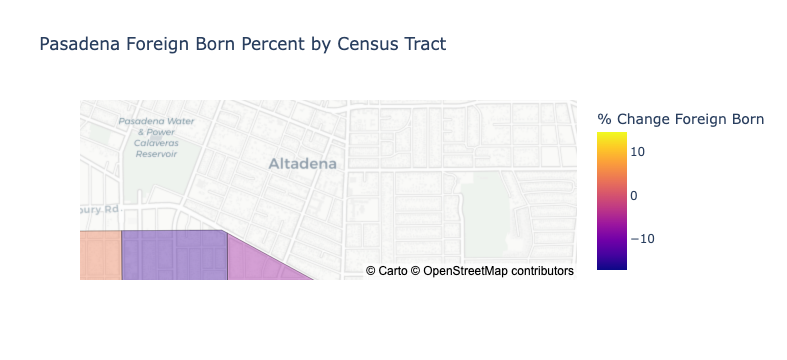

In [169]:
px.choropleth_mapbox(Pasadena,
                   geojson=Pasadena.geometry,
                   locations=Pasadena.index,
                   mapbox_style="carto-positron",
                   zoom=13,
                   opacity=0.4,
                   center = {"lat": center_lat_Pasadena, "lon": center_lon_Pasadena},
                   color="% Change Foreign Born",
                   hover_data=['% Europe', '% Asia', '% Latin America', '% Caribbean', '% Central America', '% Mexico', '% Other Central America', '% South America', '% Other Areas'],
                   title="Pasadena Foreign Born Percent by Census Tract")

This map allows us to read the exact percentage foreign born for each ethnicity in each census tract by placing your cursor over it. It gives us more exact statistics than a static map.
<br>
<br>
West Pasadena seems to show a general trend of increasing foreign born populations, while as we move East we generally see a trend of declining shares of foreign born residents in a given census tract. Some of the largest shifts occur right along the 210 freeway, with one tract logging in at -17%, and while another saw an increase of 11%. 
<br>
<br>
The tract out station area is in does show a decrease in percent foreign born, but the tracts immediately surrounding it show moderate to high increases.

### Chinatown: Foreign Born Interactive Map

Once again, we begin by creating a subset of only census tracts within our neighborhood. In this case, it is Chinatown. 

In [170]:
Chinatown = gdf[gdf["FIPS"].isin(['06037206010', 
                                       '06037207103', 
                                       '06037207102',
                                       '06037206020']
                                      )
                     ]

Chinatown is so small that it actually consists of the same census tracts as our walkshed. 

In [171]:
Chinatown.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born,% Europe,% Asia,% Latin America,% Caribbean,% Central America,% Mexico,% Other Central America,% South America,% Other Areas
529,06037206010,"Census Tract 2060.10, Los Angeles, CA",2947.0,1661.0,18.0,0.0,926.0,290.0,714.0,11.0,0.0,703.0,635.0,29.0,68.0,0.0,0.0,0.0,3.0,3.0,4121.0,2059.0,238.0,10.0,0.0,1135.0,225.0,914.0,0.0,0.0,914.0,748.0,13.0,166.0,0.0,0.0,0.0,0.0,0.0,"MULTIPOLYGON (((-118.23924 34.06726, -118.2380...",-6.398801,0.242660,27.541859,22.179083,0.000000,22.179083,18.150934,4.028149,0.000000,0.000000
530,06037206020,"Census Tract 2060.20, Los Angeles, CA",7677.0,1404.0,14.0,0.0,189.0,17.0,1187.0,55.0,24.0,1099.0,773.0,153.0,326.0,72.0,33.0,0.0,14.0,9.0,8947.0,1074.0,113.0,116.0,15.0,242.0,54.0,696.0,7.0,7.0,680.0,448.0,14.0,232.0,23.0,9.0,0.0,20.0,0.0,"MULTIPOLYGON (((-118.23787 34.05427, -118.2378...",-6.284370,1.296524,2.704817,7.779144,0.078239,7.600313,5.007265,2.593048,0.100592,0.223539
537,06037207102,"Census Tract 2071.02, Los Angeles, CA",2276.0,1753.0,1.0,0.0,1592.0,799.0,160.0,38.0,0.0,102.0,72.0,0.0,30.0,0.0,20.0,0.0,0.0,0.0,2926.0,1837.0,114.0,50.0,29.0,1465.0,71.0,321.0,1.0,1.0,295.0,181.0,0.0,114.0,0.0,25.0,13.0,1.0,0.0,"MULTIPOLYGON (((-118.24303 34.05735, -118.2429...",-14.239135,1.708817,50.068353,10.970608,0.034176,10.082023,6.185919,3.896104,0.854409,0.034176
538,06037207103,"Census Tract 2071.03, Los Angeles, CA",2098.0,1728.0,0.0,0.0,1688.0,626.0,22.0,0.0,0.0,22.0,22.0,0.0,0.0,0.0,0.0,0.0,18.0,18.0,2393.0,1649.0,411.0,16.0,11.0,1551.0,389.0,76.0,6.0,0.0,30.0,12.0,0.0,18.0,0.0,40.0,11.0,6.0,0.0,"MULTIPOLYGON (((-118.24557 34.06470, -118.2454...",-13.454837,0.668617,64.814041,3.175930,0.250731,1.253656,0.501463,0.752194,1.671542,0.250731


<AxesSubplot:>

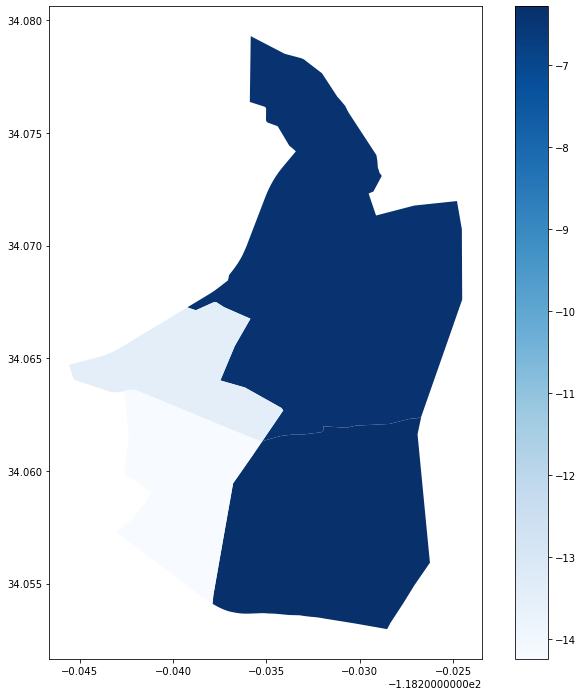

In [172]:
fig,ax = plt.subplots(figsize=(12,12))

Chinatown.plot(ax=ax,column='% Change Foreign Born', legend=True,cmap='Blues')

Now to add an interactive element. We are going to add hover text so that the percent foreign born of each census tract will pop up.

We’re adding a basemap under our interactive map to give geographic context of the Chinatown neighborhood. We’re bringing in our token below which allows us to access the MapBox library of basemaps. 

Now we need to orient the basemap around the Chinatown neighborhood. 

In [173]:
# what's the centroid?

minx, miny, maxx, maxy = Chinatown.geometry.total_bounds
center_lat_Chinatown = (maxy-miny)/2+miny
center_lon_Chinatown = (maxx-minx)/2+minx


Now we'm bringing in new arguments like "mapbox_style" and "center" to finally add a basemap to the interactive map. 

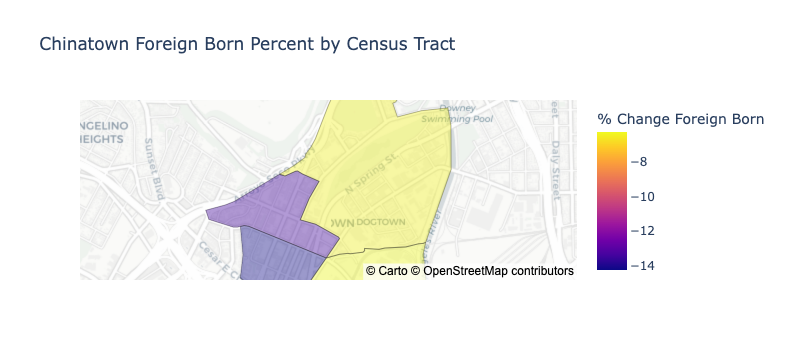

In [174]:
px.choropleth_mapbox(Chinatown,
                   geojson=Chinatown.geometry,
                   locations=Chinatown.index,
                   mapbox_style="carto-positron",
                   zoom=13,
                   opacity=0.4,
                   center = {"lat": center_lat_Chinatown, "lon": center_lon_Chinatown},
                   color="% Change Foreign Born",
                   hover_data=['% Europe', '% Asia', '% Latin America', '% Caribbean', '% Central America', '% Mexico', '% Other Central America', '% South America', '% Other Areas'],
                   title="Chinatown Foreign Born Percent by Census Tract")

This map allows us to read the exact percentage foreign born for each ethnicity in each census tract by placing your cursor over it. It gives us more exact statistics than a static map. 
<br>
<br>
Generally we see a decreasing trend in foreign born populations. We see a large percentage of Asian foreign born populations in the neighborhood, and also a fairly robust Mexican and Central American population just north of the station. The most significant decreases in foreign born population are occurring towards downtown, and in the more dense part of Chinatown.  


### adding a marker to the interactive map

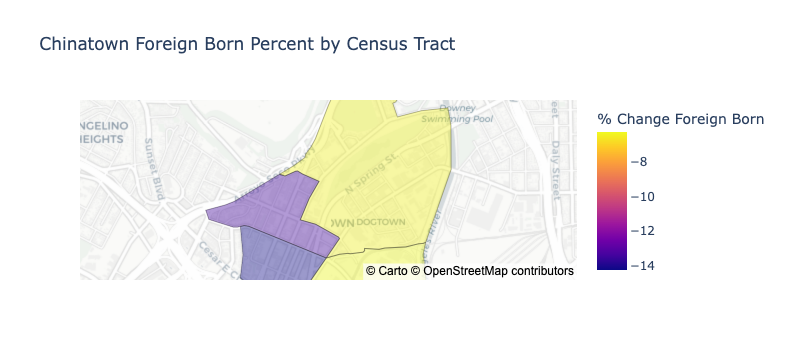

In [175]:
px.choropleth_mapbox(Chinatown,
                   geojson=Chinatown.geometry,
                   locations=Chinatown.index,
                   mapbox_style="carto-positron",
                   zoom=13,
                   opacity=0.4,
                   center = {"lat": center_lat_Chinatown, "lon": center_lon_Chinatown},
                   color="% Change Foreign Born",
                   hover_data=['% Europe', '% Asia', '% Latin America', '% Caribbean', '% Central America', '% Mexico', '% Other Central America', '% South America', '% Other Areas'],
                   title="Chinatown Foreign Born Percent by Census Tract")

In [176]:
px.choropleth_mapbox(Chinatown,
                   geojson=Chinatown.geometry,
                   locations=Chinatown.index,
                   mapbox_style="carto-positron",
                   zoom=13,
                   opacity=0.4,
                   center = {"lat": center_lat_Chinatown, "lon": center_lon_Chinatown},
                   color="% Change Foreign Born",
                   hover_data=['% Europe', '% Asia', '% Latin America', '% Caribbean', '% Central America', '% Mexico', '% Other Central America', '% South America', '% Other Areas'],
                   title="Chinatown Foreign Born Percent by Census Tract")

px.add_scattermapbox(
    lat = center_lat_Chinatown,
    lon = center_lon_Chinatown,
    mode = 'markers+text',
    text = texts,
    marker_size=12,
    marker_color='rgb(235, 0, 100)'
)

AttributeError: module 'plotly.express' has no attribute 'add_scattermapbox'

In [ ]:
For some reason it's saying it doesn't know what add_scattermapbox is even though the stack overflow page says 

### Confirming the walkshed census tracts for our other stations.

I'm doing the same as we've done for the Del Mar and Chinatown Station to confirm the census tracts in the walkshed. We do this by overlaying the walkshed map with a choropleth of the gdf subset for each station. For each station, I will paste in the walkshed osmnx code from the "Walkshed Maps for All Stations" notebook

## Arcadia Station

In [427]:
address = 'Arcadia, East Saint Joseph Street, Arcadia, Los Angeles County, California, 91006, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [428]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G7 = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 4.5 s, sys: 36 ms, total: 4.54 s
Wall time: 4.56 s


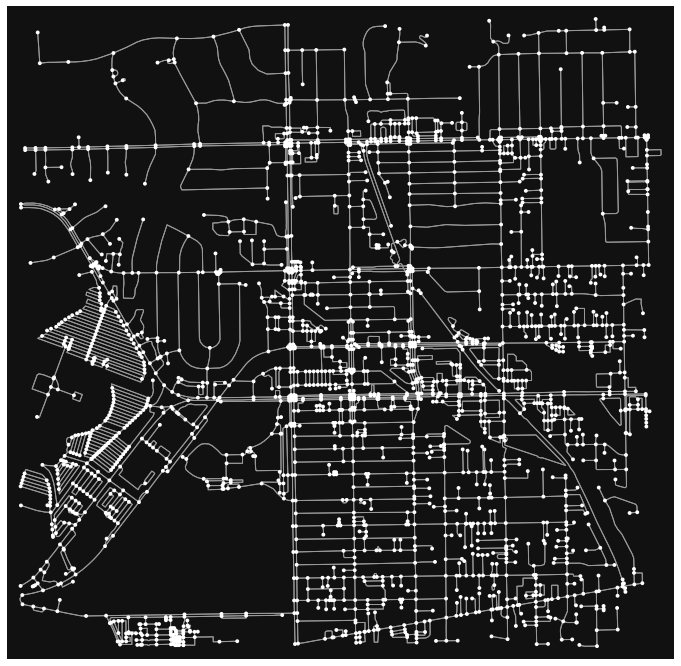

In [429]:
fig, ax = ox.plot_graph(G7,figsize=(12,12))

In [430]:
G7 = ox.project_graph(G7, to_crs='epsg:3857')

In [431]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G7)

In [432]:
gdf_nodes.head()

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
28947780,4.048216e+06,-1.313920e+07,3,-118.031451,34.144457,NaN,POINT (-13139201.067 4048215.578)
7464757602,4.048249e+06,-1.313920e+07,3,-118.031456,34.144706,NaN,POINT (-13139201.568 4048249.096)
268161590,4.048088e+06,-1.313920e+07,3,-118.031432,34.143510,NaN,POINT (-13139198.930 4048088.256)
122699116,4.048217e+06,-1.313913e+07,3,-118.030834,34.144465,NaN,POINT (-13139132.372 4048216.627)
28947781,4.048357e+06,-1.313920e+07,4,-118.031471,34.145510,traffic_signals,POINT (-13139203.238 4048357.185)


### Plotting the station area

<AxesSubplot:>

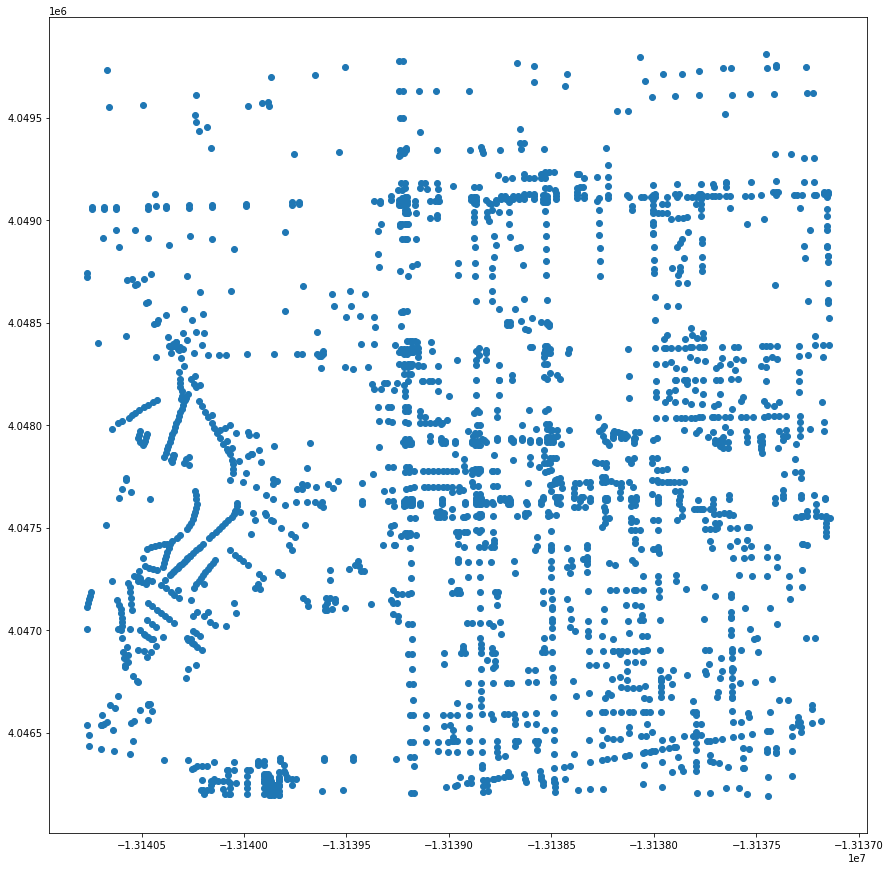

In [433]:
gdf_nodes.plot(figsize=(15,15))

In [434]:
gdf_edges.head()

osmid  oneway lanes                name  \
u          v          key                                                
28947780   7464757602 0    182043866   False     2  Santa Anita Avenue   
           268161590  0    182043866   False     2  Santa Anita Avenue   
           122699116  0    206911853   False   NaN     La Porte Street   
7464757602 939854546  0    182043866   False     2  Santa Anita Avenue   
           28947780   0    182043866   False     2  Santa Anita Avenue   

                               highway   length  \
u          v          key                         
28947780   7464757602 0        primary   27.713   
           268161590  0        primary  105.272   
           122699116  0    residential   56.797   
7464757602 939854546  0        primary   30.260   
           28947780   0        primary   27.713   

                                                                    geometry  \
u          v          key                                                      
28947780   7464757602 0    LINESTRING (-13139201.067 4048215.578, -131392...   
           268161590  0    LINESTRING (-13139201.067 4048215.578, -131391...   
           122699116  0    LINESTRING (-13139201.067 4048215.578, -131391...   
7464757602 939854546  0    LINESTRING (-13139201.568 4048249.096, -131392...   
           28947780   0    LINESTRING (-13139201.568 4048249.096, -131392...   

                          service maxspeed access width bridge tunnel  
u          v          key                                              
28947780   7464757602 0       NaN      NaN    NaN   NaN    NaN    NaN  
           268161590  0       NaN      NaN    NaN   NaN    NaN    NaN  
           122699116  0       NaN      NaN    NaN   NaN    NaN    NaN  
7464757602 939854546  0       NaN      NaN    NaN   NaN    NaN    NaN  
           28947780   0       NaN      NaN    NaN   NaN    NaN    NaN

<AxesSubplot:>

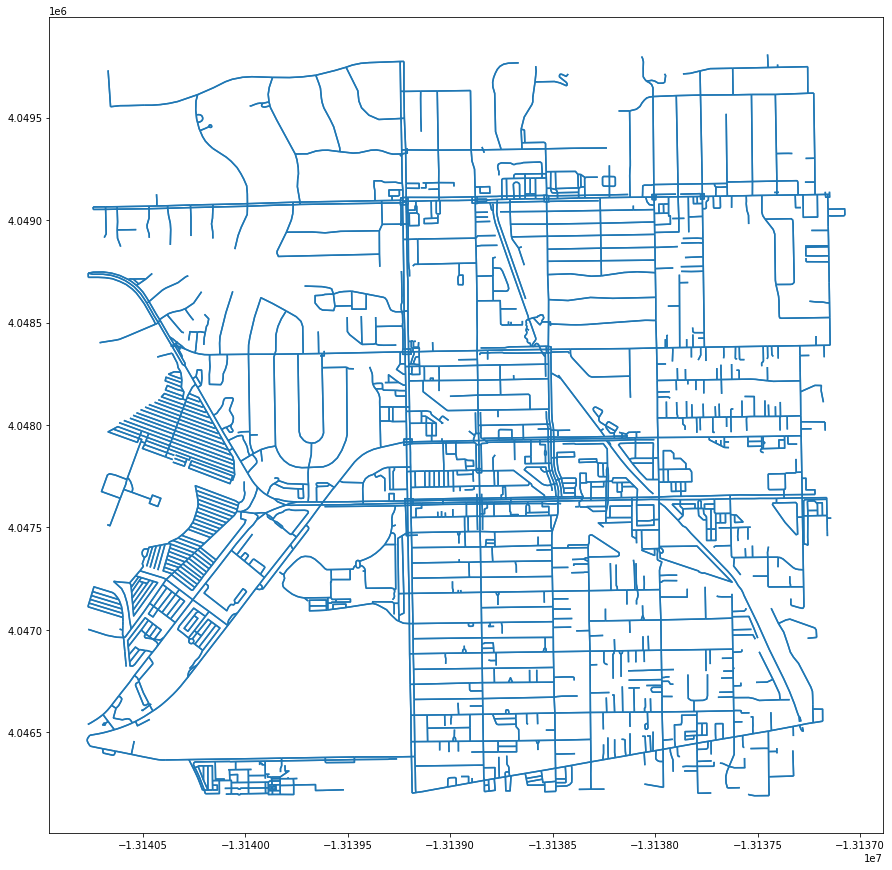

In [435]:
gdf_edges.plot(figsize=(15,15))

In [436]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13140768.523793029
4046191.6095434465
-13137140.766303413
4049808.4405088546


In [437]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13138954.64504822
4048000.0250261505


In [438]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node7 = ox.distance.nearest_nodes(G7,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node7))

The id for the nearest node is 5599455859


In [439]:
# what is this record?
gdf_nodes.loc[[center_node7]]

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
5599455859,4.047971e+06,-1.313891e+07,1,-118.028828,34.142635,NaN,POINT (-13138909.043 4047970.553)


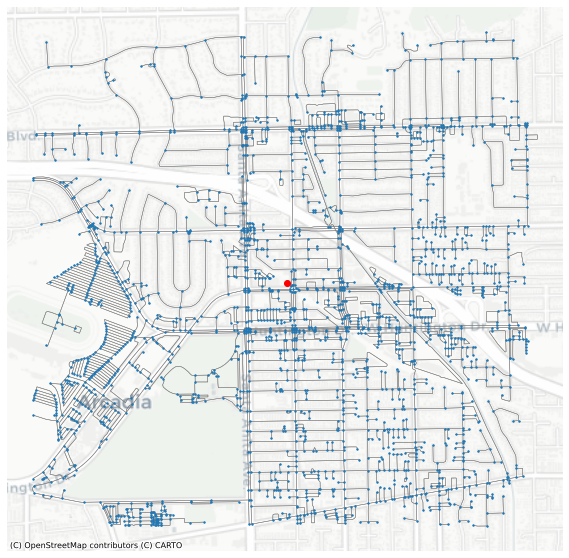

In [440]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node7]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [441]:
gdf_edges.sample(5)

,,,osmid,oneway,lanes,name,highway,length,geometry,service,maxspeed,access,width,bridge,tunnel
u,v,key,,,,,,,,,,,,,
7215957601,7215957599,0,772867508,False,NaN,NaN,service,18.740,"LINESTRING (-13140080.224 4047874.519, -131400...",driveway,NaN,NaN,NaN,NaN,NaN
6094647127,7514692604,0,649402694,False,NaN,NaN,service,63.075,"LINESTRING (-13138090.466 4047609.058, -131380...",parking_aisle,NaN,NaN,NaN,NaN,NaN
6048642754,6048642746,0,642532930,False,NaN,NaN,service,14.439,"LINESTRING (-13138625.846 4046257.989, -131386...",NaN,NaN,NaN,NaN,NaN,NaN
8679015590,939788171,0,13373063,False,4,South 1st Avenue,tertiary,23.912,"LINESTRING (-13138845.535 4046932.704, -131388...",NaN,NaN,NaN,NaN,NaN,NaN
939854567,939854539,0,80563350,False,NaN,NaN,footway,40.371,"LINESTRING (-13139581.246 4047294.674, -131395...",NaN,NaN,NaN,NaN,NaN,NaN


In [442]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [443]:
gdf_edges.sample(5)

,,,osmid,oneway,lanes,name,highway,length,geometry,service,maxspeed,access,width,bridge,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,
6103802947,6103802960,0,650719549,False,NaN,NaN,service,131.835,"LINESTRING (-13139409.725 4048639.571, -131394...",NaN,NaN,NaN,NaN,NaN,NaN,1.647938
6731995041,6731995042,0,716708124,False,NaN,NaN,service,59.887,"LINESTRING (-13138756.569 4048221.012, -131387...",NaN,NaN,NaN,NaN,NaN,NaN,0.748587
7215957505,7215957506,0,772867480,False,NaN,NaN,service,15.842,"LINESTRING (-13140310.388 4048062.647, -131403...",driveway,NaN,NaN,NaN,NaN,NaN,0.198025
6789946935,4077284463,0,723974013,False,NaN,NaN,service,121.080,"LINESTRING (-13140520.782 4046753.444, -131404...",NaN,NaN,NaN,NaN,NaN,NaN,1.513500
2398722025,2398722331,0,748864006,False,NaN,NaN,service,9.683,"LINESTRING (-13139190.492 4048298.070, -131392...",NaN,NaN,NaN,NaN,NaN,NaN,0.121037


In [444]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [445]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [446]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G7, 5599455859, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 165 nodes within 10 minutes 


In [447]:
gdf_nodes.sample(30)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
6790180066,4.047964e+06,-1.313818e+07,1,-118.022245,34.142588,NaN,POINT (-13138176.260 4047964.191),NaN,NaN
6064231017,4.047195e+06,-1.313809e+07,4,-118.021442,34.136870,NaN,POINT (-13138086.837 4047195.217),NaN,NaN
6978527793,4.046234e+06,-1.313989e+07,3,-118.037618,34.129721,NaN,POINT (-13139887.541 4046233.716),NaN,NaN
7882725096,4.047924e+06,-1.314008e+07,3,-118.039380,34.142291,NaN,POINT (-13140083.731 4047924.284),NaN,NaN
7059565448,4.047630e+06,-1.313921e+07,4,-118.031518,34.140101,NaN,POINT (-13139208.504 4047629.677),NaN,NaN
939854594,4.047031e+06,-1.313920e+07,4,-118.031436,34.135649,NaN,POINT (-13139199.387 4047030.975),NaN,NaN
7257002469,4.047907e+06,-1.313731e+07,1,-118.014436,34.142163,NaN,POINT (-13137306.955 4047907.095),NaN,NaN
6978557800,4.046281e+06,-1.313979e+07,1,-118.036756,34.130072,NaN,POINT (-13139791.573 4046280.878),NaN,NaN
8456014412,4.048163e+06,-1.313793e+07,1,-118.020017,34.144064,NaN,POINT (-13137928.229 4048162.677),NaN,NaN


In [448]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [449]:
gdf_nodes.sample(5)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
2164853021,4.048287e+06,-1.313915e+07,4,-118.030991,34.144985,NaN,POINT (-13139149.805 4048286.610),10 mins,#0d0887
6822387902,4.046645e+06,-1.313896e+07,1,-118.029306,34.132776,NaN,POINT (-13138962.265 4046644.523),NaN,#cccccc
7872074181,4.046430e+06,-1.313789e+07,3,-118.019690,34.131180,NaN,POINT (-13137891.839 4046429.925),NaN,#cccccc
6063764207,4.048226e+06,-1.314026e+07,3,-118.040941,34.144534,NaN,POINT (-13140257.400 4048225.934),NaN,#cccccc
123566635,4.047040e+06,-1.313850e+07,3,-118.025131,34.135719,NaN,POINT (-13138497.517 4047040.403),NaN,#cccccc


<AxesSubplot:>

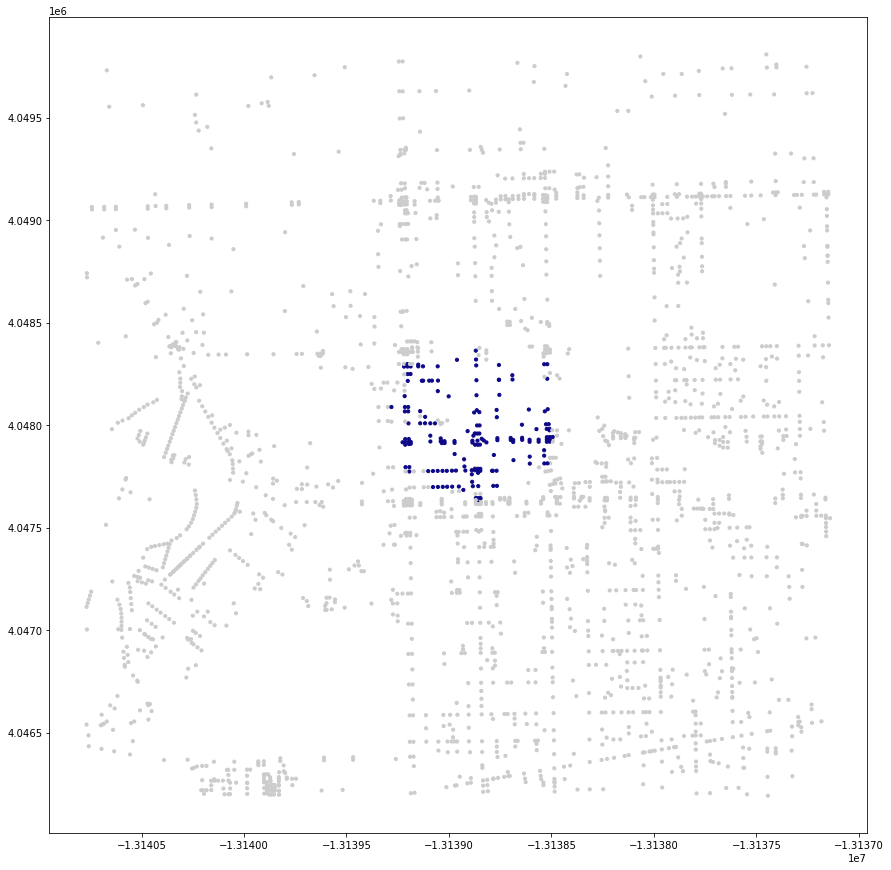

In [450]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

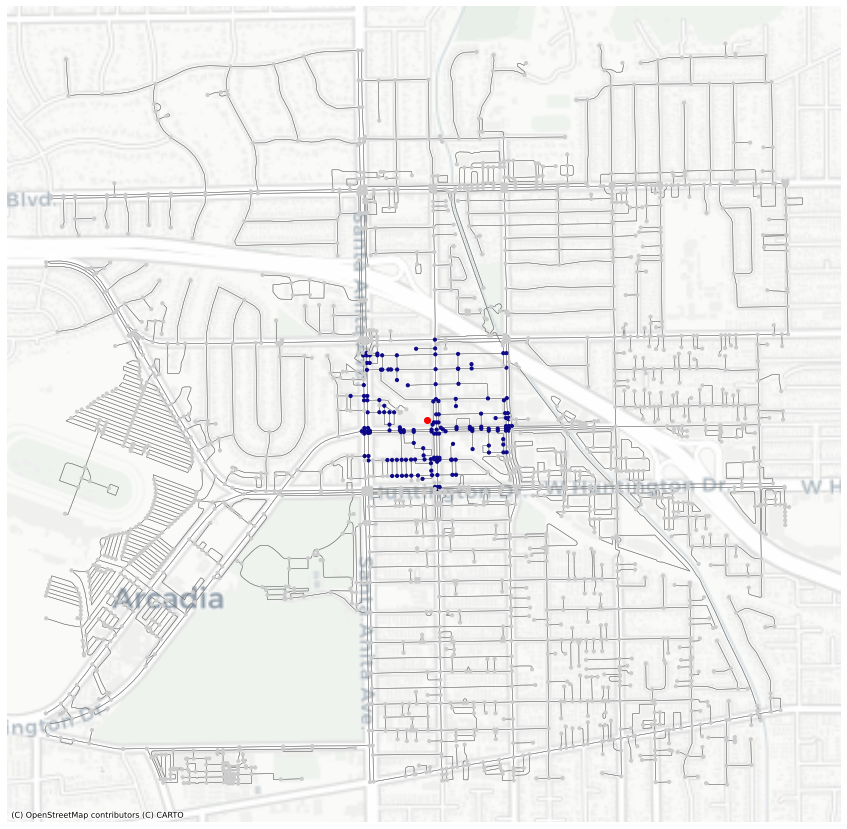

In [451]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node7]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [452]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
28947780,4.048216e+06,-1.313920e+07,3,-118.031451,34.144457,NaN,POINT (-13139201.067 4048215.578),10 mins,#0d0887
7464757602,4.048249e+06,-1.313920e+07,3,-118.031456,34.144706,NaN,POINT (-13139201.568 4048249.096),10 mins,#0d0887
268161590,4.048088e+06,-1.313920e+07,3,-118.031432,34.143510,NaN,POINT (-13139198.930 4048088.256),10 mins,#0d0887
122699116,4.048217e+06,-1.313913e+07,3,-118.030834,34.144465,NaN,POINT (-13139132.372 4048216.627),10 mins,#0d0887
7883463556,4.048217e+06,-1.313913e+07,3,-118.030777,34.144465,NaN,POINT (-13139126.005 4048216.681),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7464904760,4.048067e+06,-1.313853e+07,1,-118.025445,34.143353,NaN,POINT (-13138532.405 4048067.126),10 mins,#0d0887
7464904766,4.048063e+06,-1.313885e+07,1,-118.028313,34.143324,NaN,POINT (-13138851.758 4048063.158),10 mins,#0d0887
7874784811,4.048319e+06,-1.313896e+07,1,-118.029295,34.145223,NaN,POINT (-13138961.029 4048318.595),10 mins,#0d0887


In [453]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

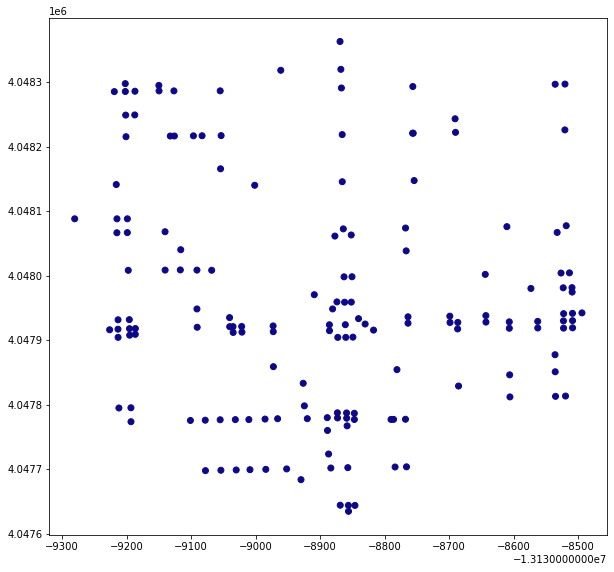

In [454]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

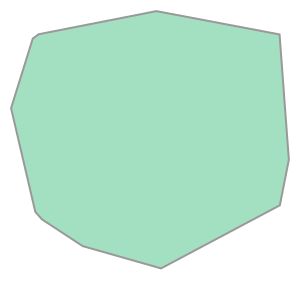

In [455]:
gdf_10.unary_union.convex_hull

In [456]:
# There's our polygon!
isochrones_arcadia = gdf_nodes.dissolve("time")
isochrones_arcadia

,geometry,y,x,street_count,lon,lat,highway,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13139280.639 4048088.229, -131392...",4.048216e+06,-1.313920e+07,3,-118.031451,34.144457,traffic_signals,#0d0887


In [457]:
isochrones_arcadia = isochrones_arcadia.convex_hull.reset_index()
isochrones_arcadia

,time,0
0,10 mins,"POLYGON ((-13138855.977 4047634.613, -13139077..."


In [458]:
isochrones_arcadia.columns=['time','geometry']
isochrones_arcadia

,time,geometry
0,10 mins,"POLYGON ((-13138855.977 4047634.613, -13139077..."


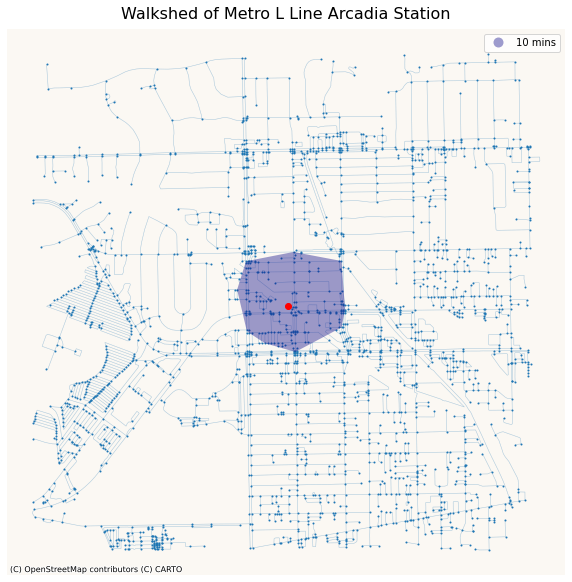

In [461]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones_arcadia.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node7]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Arcadia Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

### Isolating Our Aracadia Walkshed

Based on the walk shed map we created, we use its nodes to cross reference a census tract map and identify the tracts in our walkshed. We now isolate those tracts into its own variable.

In [210]:
arcadia = gdf[gdf["FIPS"].isin(['06037430801', 
                                '06037430721', 
                                '06037430400',]
                                      )
                     ]

In [211]:
arcadia.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born,% Europe,% Asia,% Latin America,% Caribbean,% Central America,% Mexico,% Other Central America,% South America,% Other Areas
1273,06037430400,"Census Tract 4304, Los Angeles, CA",4877.0,2002.0,79.0,59.0,1683.0,222.0,206.0,30.0,14.0,102.0,76.0,0.0,26.0,0.0,74.0,0.0,34.0,0.0,4642.0,2167.0,408.0,73.0,12.0,1974.0,389.0,103.0,54.0,0.0,25.0,25.0,0.0,0.0,0.0,24.0,0.0,17.0,7.0,"MULTIPOLYGON (((-118.03194 34.16693, -118.0318...",5.632639,1.572598,42.524774,2.218871,1.163292,0.538561,0.538561,0.000000,0.517019,0.366221
1278,06037430721,"Census Tract 4307.21, Los Angeles, CA",2973.0,1287.0,81.0,13.0,1134.0,245.0,51.0,0.0,0.0,34.0,11.0,0.0,23.0,0.0,17.0,7.0,21.0,9.0,3963.0,1946.0,487.0,61.0,0.0,1690.0,448.0,194.0,0.0,0.0,142.0,135.0,7.0,7.0,0.0,52.0,32.0,1.0,0.0,"MULTIPOLYGON (((-118.05451 34.13186, -118.0543...",5.814608,1.539238,42.644461,4.895281,0.000000,3.583144,3.406510,0.176634,1.312137,0.025233
1281,06037430801,"Census Tract 4308.01, Los Angeles, CA",6719.0,4035.0,37.0,0.0,3448.0,1290.0,482.0,0.0,0.0,205.0,163.0,75.0,42.0,29.0,277.0,0.0,68.0,47.0,6978.0,3832.0,1027.0,183.0,16.0,3430.0,963.0,98.0,0.0,0.0,67.0,67.0,0.0,0.0,0.0,31.0,0.0,121.0,48.0,"MULTIPOLYGON (((-118.03153 34.14550, -118.0284...",-5.138131,2.622528,49.154486,1.404414,0.000000,0.960161,0.960161,0.000000,0.444253,1.734021


<AxesSubplot:>

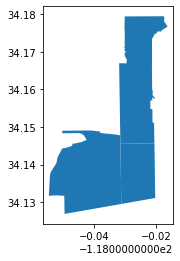

In [212]:
arcadia.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

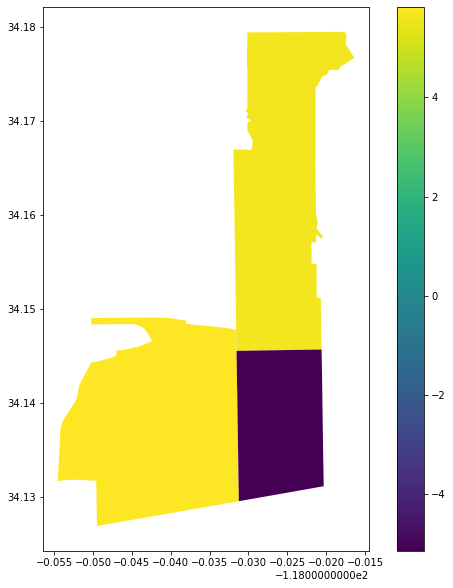

In [213]:
arcadia.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [214]:
arcadia_web_mercator = arcadia.to_crs(epsg=3857)

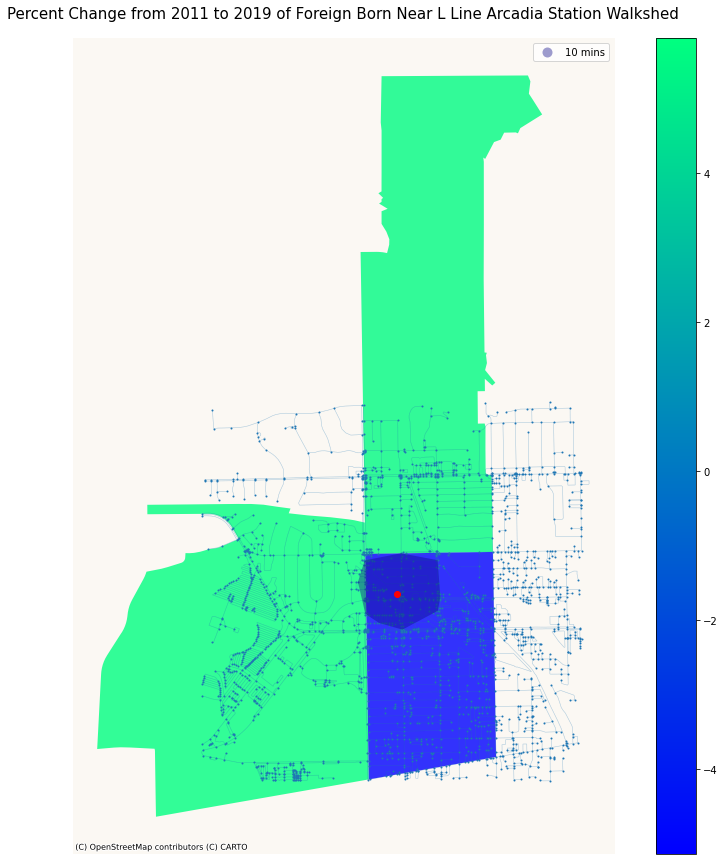

In [215]:
fig, ax = plt.subplots(figsize=(15, 15))
 
arcadia_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8,
                    cmap="winter")

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node7]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Arcadia Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

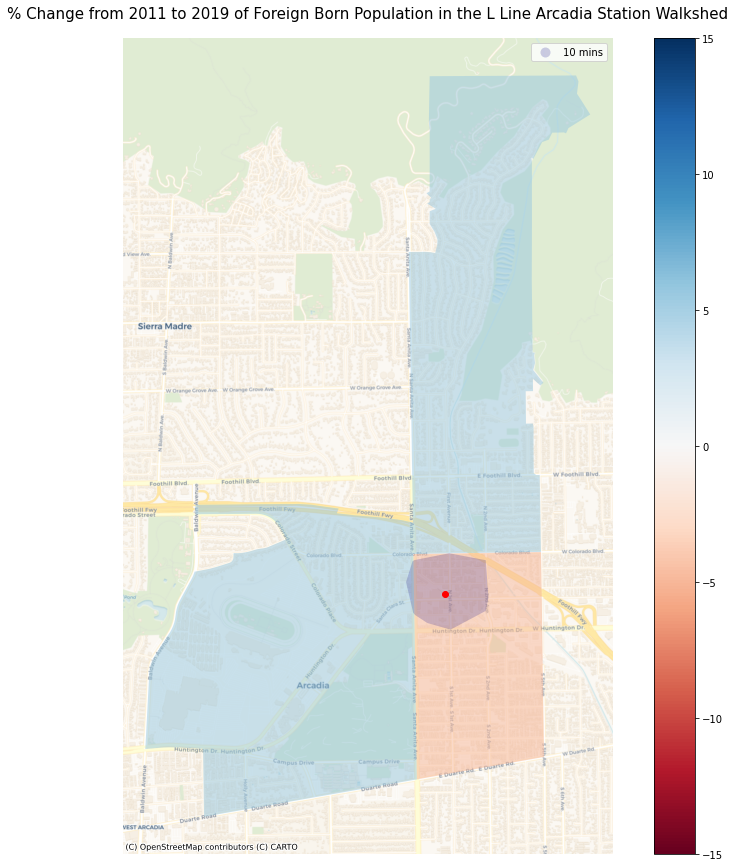

In [465]:
## clean with no nodes or edges

fig, ax = plt.subplots(figsize=(15, 15))
 
arcadia_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, 
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.5,
                    cmap="RdBu")

# add the isochrones
isochrones_arcadia.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node7]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change from 2011 to 2019 of Foreign Born Population in the L Line Arcadia Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("ArcadiaStation_ForeignBorn.jpg")

### Highland Park Station

In [467]:
address = 'Highland Park, Marmion Way, Highland Park, Los Angeles, Los Angeles County, California, 90042, United States'
network_type = 'walk'
trip_times = [10] # in minutes
meters_per_minute = 80 # travel distance per minute

In [468]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 5.04 s, sys: 44.4 ms, total: 5.08 s
Wall time: 5.34 s


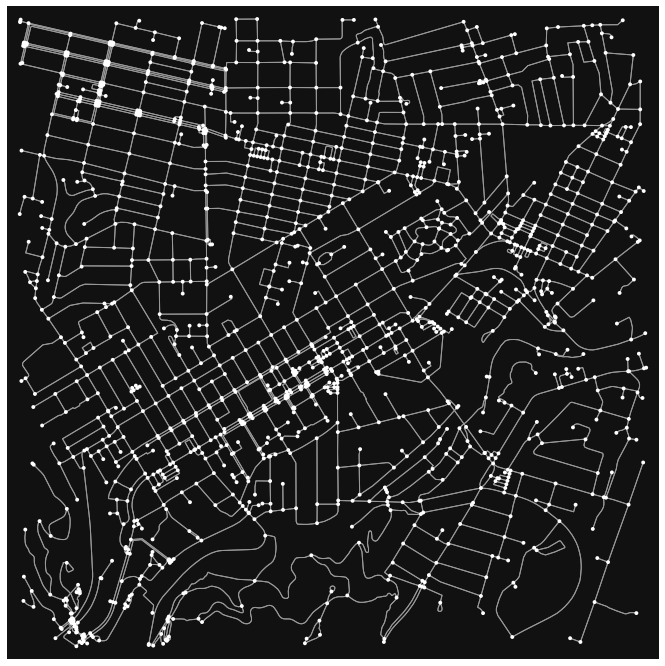

In [469]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [470]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [471]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [472]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
10552905,4.045125e+06,-1.315873e+07,traffic_signals,4,-118.206904,34.121476,POINT (-13158732.406 4045124.904)
14956558,4.045007e+06,-1.315876e+07,stop,4,-118.207144,34.120598,POINT (-13158759.123 4045006.963)
6787557826,4.045178e+06,-1.315872e+07,NaN,3,-118.206794,34.121869,POINT (-13158720.061 4045177.844)
3644839500,4.045123e+06,-1.315872e+07,NaN,4,-118.206818,34.121461,POINT (-13158722.799 4045123.008)
10552907,4.044845e+06,-1.315760e+07,traffic_signals,4,-118.196712,34.119394,POINT (-13157597.793 4044844.985)


### Plotting the station area

<AxesSubplot:>

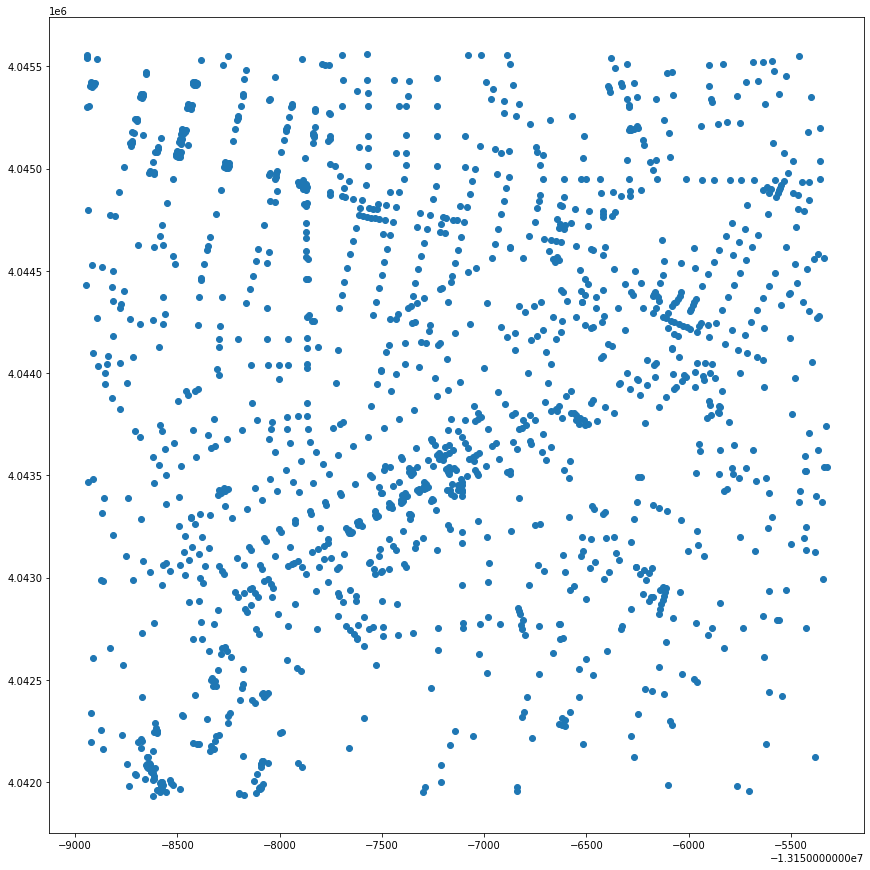

In [473]:
gdf_nodes.plot(figsize=(15,15))

In [474]:
gdf_edges.head()

osmid lanes            name    highway  oneway  \
u        v          key                                                       
10552905 14956558   0     54674043     2       Avenue 50   tertiary   False   
         6787557826 0     54674043     2       Avenue 50   tertiary   False   
         3644839500 0    398616334     5  York Boulevard  secondary   False   
14956558 10553872   0     54674043     2       Avenue 50   tertiary   False   
         10552905   0     54674043     2       Avenue 50   tertiary   False   

                          length  \
u        v          key            
10552905 14956558   0    100.000   
         6787557826 0     44.952   
         3644839500 0      8.097   
14956558 10553872   0    101.501   
         10552905   0    100.000   

                                                                  geometry  \
u        v          key                                                      
10552905 14956558   0    LINESTRING (-13158732.406 4045124.904, -131587...   
         6787557826 0    LINESTRING (-13158732.406 4045124.904, -131587...   
         3644839500 0    LINESTRING (-13158732.406 4045124.904, -131587...   
14956558 10553872   0    LINESTRING (-13158759.123 4045006.963, -131587...   
         10552905   0    LINESTRING (-13158759.123 4045006.963, -131587...   

                        service access bridge maxspeed junction width tunnel  
u        v          key                                                       
10552905 14956558   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         6787557826 0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         3644839500 0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
14956558 10553872   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         10552905   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN

<AxesSubplot:>

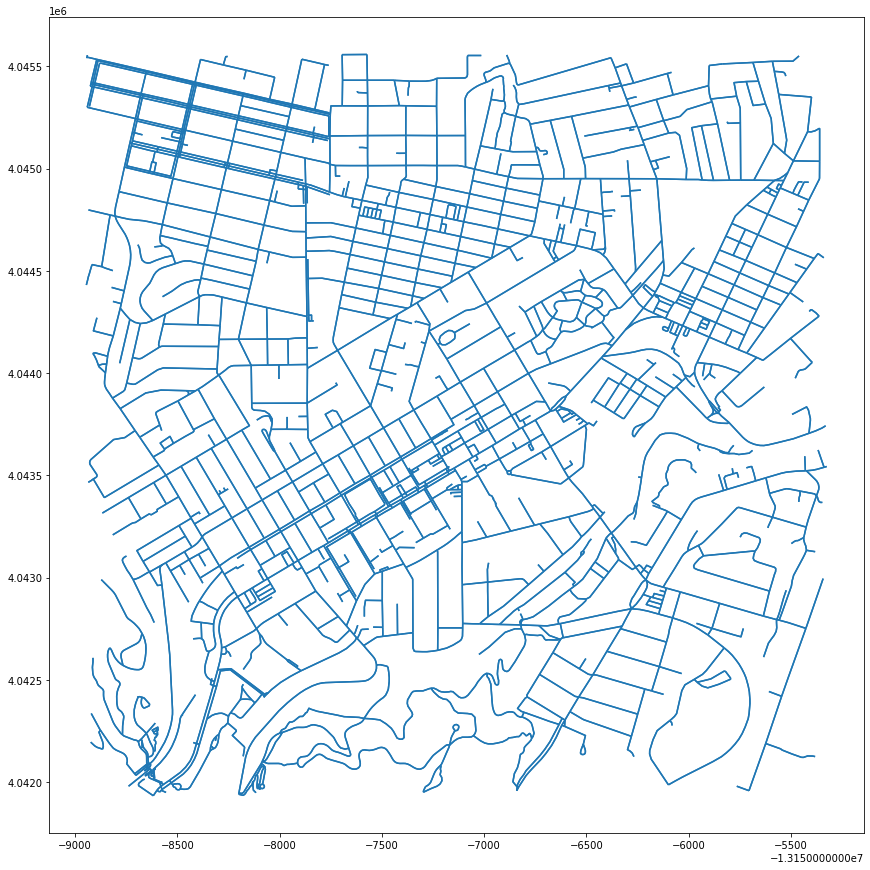

In [475]:
gdf_edges.plot(figsize=(15,15))

In [476]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13158945.382506957
4041933.3467410295
-13155325.361721948
4045557.8058276335


In [477]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13157135.372114453
4043745.5762843313


In [478]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node4 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node4))

The id for the nearest node is 111964509


In [479]:
# what is this record?
gdf_nodes.loc[[center_node4]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
111964509,4.043716e+06,-1.315713e+07,NaN,3,-118.192502,34.110999,POINT (-13157129.183 4043716.222)


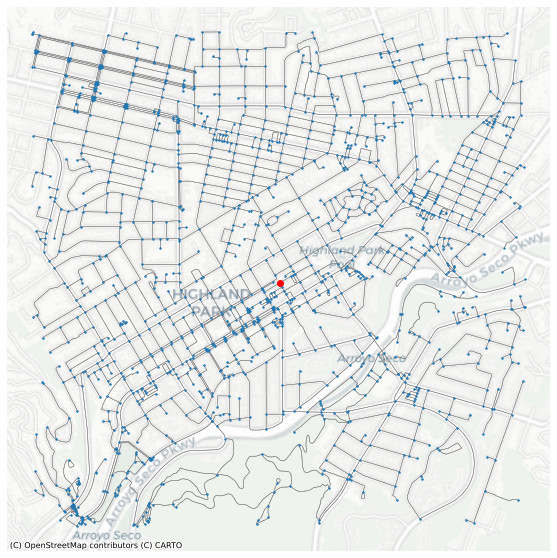

In [480]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node4]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [481]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,service,access,bridge,maxspeed,junction,width,tunnel
u,v,key,,,,,,,,,,,,,,
746908619,123164338,0,60115715,NaN,Lomitas Drive,residential,False,47.227,"LINESTRING (-13155612.722 4043242.775, -131556...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
602742492,14759760,0,167008820,NaN,Avenue 52,residential,False,74.261,"LINESTRING (-13157948.717 4043147.224, -131579...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
6819323858,6819822582,0,167276507,NaN,Almaden Drive,residential,False,94.512,"LINESTRING (-13158275.696 4045506.531, -131581...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
5690240365,8905229959,0,"[398613048, 398613050, 398613052]","[5, 4]",North Figueroa Street,secondary,False,101.164,"LINESTRING (-13157283.939 4043455.282, -131572...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
24970599,24970598,0,173389834,NaN,Hayes Avenue,residential,False,109.600,"LINESTRING (-13156411.083 4043833.922, -131563...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [482]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [483]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,service,access,bridge,maxspeed,junction,width,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,,
6790478971,6790478973,0,724037440,NaN,NaN,service,False,31.434,"LINESTRING (-13156161.182 4044320.289, -131561...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.392925
7788211189,8458917451,0,910976672,NaN,NaN,footway,False,273.420,"LINESTRING (-13158654.137 4045464.415, -131586...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.417750
1784020299,1840753846,0,167015948,NaN,Avenue 53,residential,False,55.114,"LINESTRING (-13158146.999 4044410.739, -131581...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.688925
6822547827,8462863114,0,728054761,NaN,NaN,service,False,22.821,"LINESTRING (-13157839.234 4045125.724, -131578...",driveway,NaN,NaN,NaN,NaN,NaN,NaN,0.285263
7874479217,7874479216,0,844151356,NaN,NaN,service,False,14.708,"LINESTRING (-13156645.923 4044568.341, -131566...",NaN,customers,NaN,NaN,NaN,NaN,NaN,0.183850


In [484]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [485]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [486]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 111964509, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 240 nodes within 10 minutes 


In [487]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
2634612699,4.045107e+06,-1.315859e+07,NaN,3,-118.205664,34.121339,POINT (-13158594.314 4045106.509),NaN,NaN
8410528307,4.043067e+06,-1.315794e+07,NaN,3,-118.199763,34.106170,POINT (-13157937.462 4043067.042),NaN,NaN
7528072474,4.042068e+06,-1.315865e+07,NaN,3,-118.206130,34.098742,POINT (-13158646.145 4042068.356),NaN,NaN
7797882683,4.043845e+06,-1.315589e+07,NaN,3,-118.181405,34.111960,POINT (-13155893.881 4043845.444),NaN,NaN
123312239,4.045512e+06,-1.315583e+07,NaN,3,-118.180874,34.124351,POINT (-13155834.760 4045511.587),NaN,NaN
7528143719,4.042041e+06,-1.315871e+07,NaN,4,-118.206693,34.098535,POINT (-13158708.840 4042040.569),NaN,NaN
6787643134,4.043771e+06,-1.315681e+07,NaN,3,-118.189647,34.111406,POINT (-13156811.321 4043770.917),10 mins,#0d0887
1784125362,4.044272e+06,-1.315666e+07,NaN,4,-118.188319,34.115136,POINT (-13156663.455 4044272.421),NaN,NaN
25954610,4.042455e+06,-1.315621e+07,NaN,3,-118.184286,34.101617,POINT (-13156214.582 4042454.908),NaN,NaN


In [488]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [489]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
7690745880,4.041951e+06,-1.315859e+07,NaN,4,-118.205595,34.097872,POINT (-13158586.622 4041951.468),NaN,#cccccc
5690240369,4.043228e+06,-1.315767e+07,NaN,4,-118.197332,34.107364,POINT (-13157666.834 4043227.542),10 mins,#0d0887
2411608095,4.044224e+06,-1.315647e+07,NaN,3,-118.186577,34.114774,POINT (-13156469.537 4044223.828),10 mins,#0d0887
19809023,4.043634e+06,-1.315734e+07,NaN,3,-118.194353,34.110385,POINT (-13157335.213 4043633.710),10 mins,#0d0887
14920187,4.044176e+06,-1.315590e+07,traffic_signals,4,-118.181457,34.114417,POINT (-13155899.603 4044175.800),NaN,#cccccc


<AxesSubplot:>

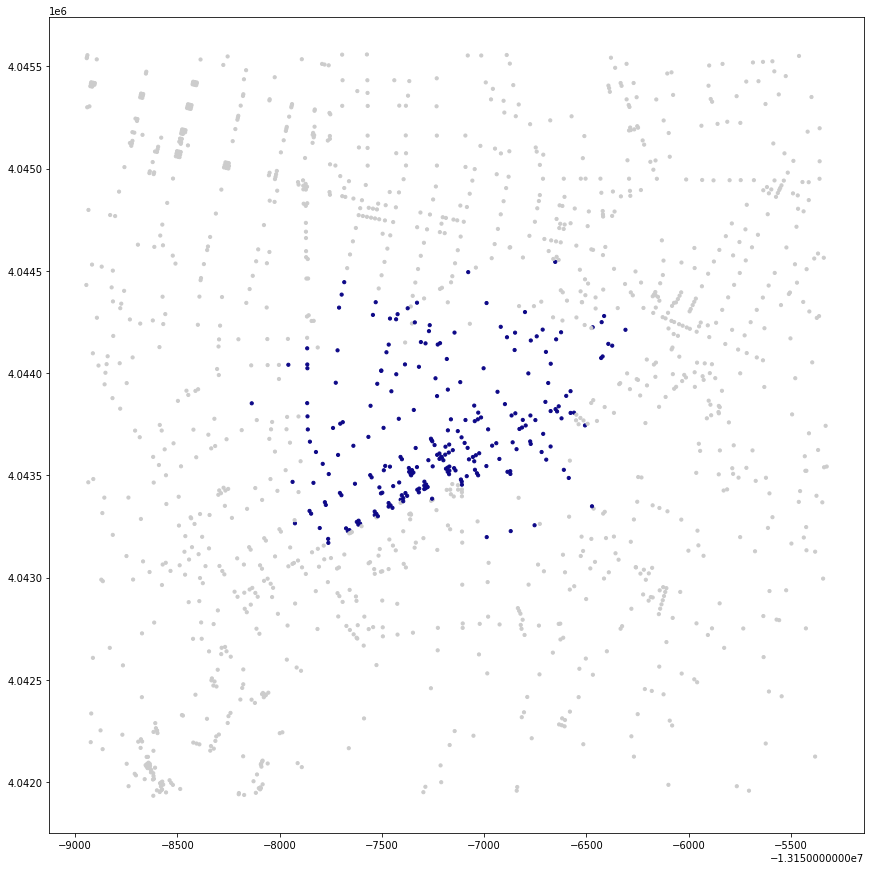

In [490]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

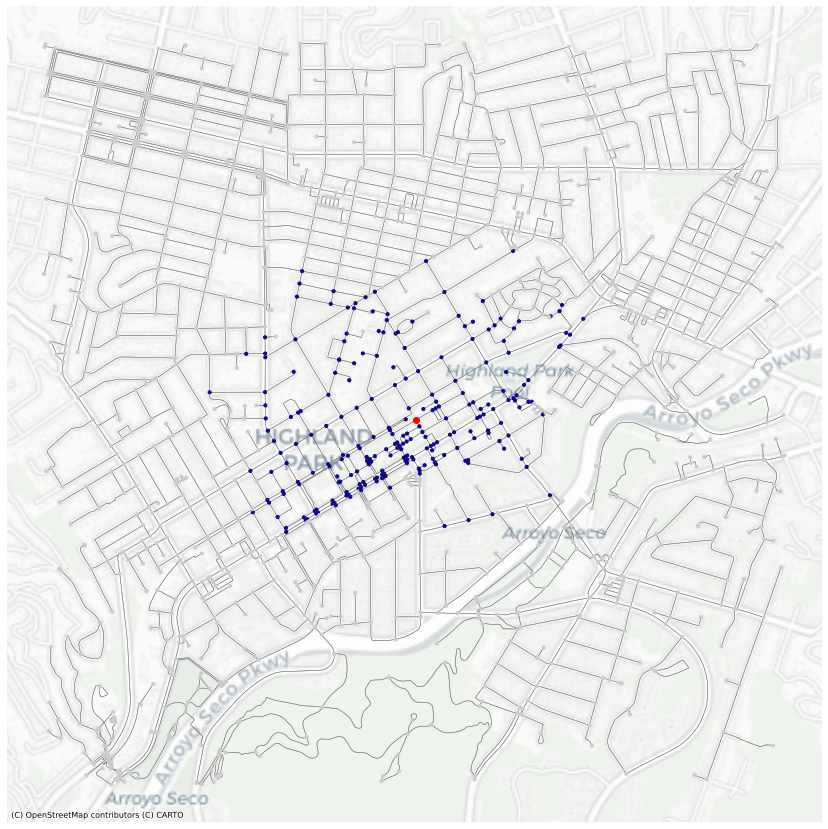

In [491]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node4]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [492]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
18364121,4.044212e+06,-1.315631e+07,NaN,3,-118.185137,34.114683,POINT (-13156309.315 4044211.620),10 mins,#0d0887
19809027,4.043265e+06,-1.315793e+07,NaN,3,-118.199655,34.107645,POINT (-13157925.418 4043265.308),10 mins,#0d0887
14760044,4.043814e+06,-1.315668e+07,traffic_signals,4,-118.188425,34.111728,POINT (-13156675.244 4043814.184),10 mins,#0d0887
702230871,4.043859e+06,-1.315670e+07,NaN,3,-118.188654,34.112062,POINT (-13156700.792 4043859.091),10 mins,#0d0887
6787726293,4.043824e+06,-1.315665e+07,NaN,3,-118.188208,34.111798,POINT (-13156651.143 4043823.650),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8410872932,4.043640e+06,-1.315719e+07,NaN,3,-118.193044,34.110432,POINT (-13157189.440 4043640.029),10 mins,#0d0887
8410872935,4.043651e+06,-1.315717e+07,NaN,3,-118.192880,34.110511,POINT (-13157171.228 4043650.597),10 mins,#0d0887
8459928442,4.043544e+06,-1.315725e+07,NaN,1,-118.193605,34.109716,POINT (-13157251.935 4043543.776),10 mins,#0d0887


In [493]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

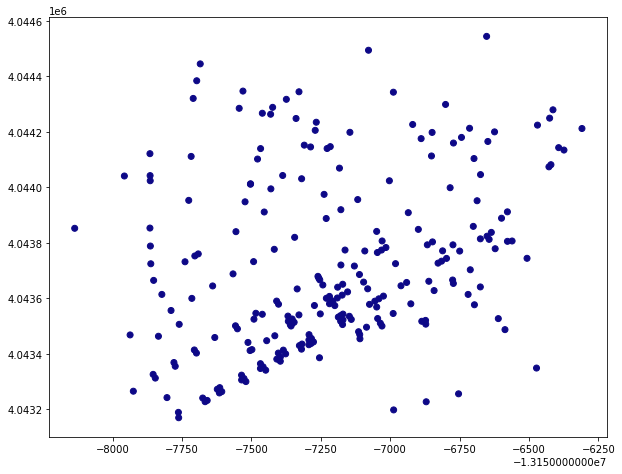

In [494]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

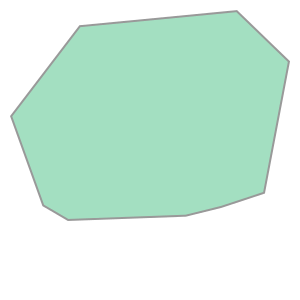

In [495]:
gdf_10.unary_union.convex_hull

In [496]:
# There's our polygon!
isochrones_hlp = gdf_nodes.dissolve("time")
isochrones_hlp

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13158136.669 4043852.127, -131579...",4.044212e+06,-1.315631e+07,traffic_signals,3,-118.185137,34.114683,#0d0887


In [497]:
isochrones_hlp = isochrones_hlp.convex_hull.reset_index()
isochrones_hlp

,time,0
0,10 mins,"POLYGON ((-13157762.101 4043169.744, -13157925..."


In [498]:
isochrones_hlp.columns=['time','geometry']
isochrones_hlp

,time,geometry
0,10 mins,"POLYGON ((-13157762.101 4043169.744, -13157925..."


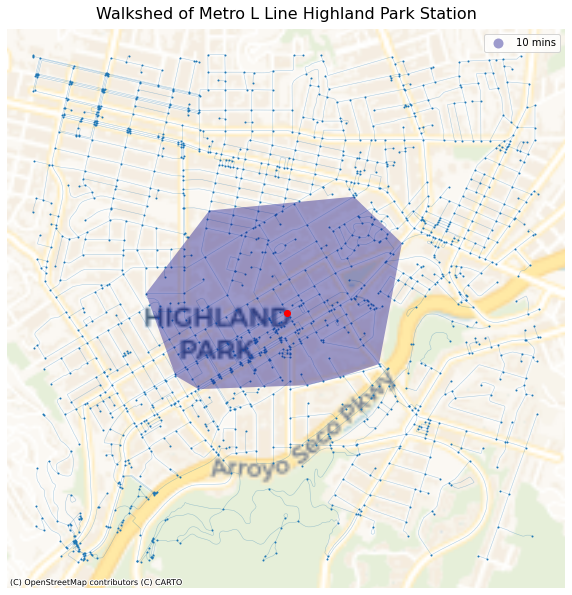

In [499]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones_hlp.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node4]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Highland Park Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

In [500]:
highlandpark = gdf[gdf["FIPS"].isin(['06037183610', 
                                     '06037183510', 
                                     '06037183520',
                                     '06037183810',
                                     '06037183820',
                                     '06037183701',
                                     '06037183101',
                                     '06037183620']
                                      )
                     ]

In [501]:
highlandpark.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born,% Europe,% Asia,% Latin America,% Caribbean,% Central America,% Mexico,% Other Central America,% South America,% Other Areas
357,06037183101,"Census Tract 1831.01, Los Angeles, CA",4231.0,1536.0,27.0,0.0,114.0,0.0,1353.0,0.0,0.0,1025.0,569.0,55.0,456.0,51.0,328.0,6.0,42.0,0.0,3323.0,1086.0,83.0,40.0,9.0,192.0,0.0,820.0,68.0,0.0,717.0,515.0,32.0,202.0,0.0,35.0,8.0,34.0,34.0,"MULTIPOLYGON (((-118.18743 34.12817, -118.1855...",-3.622162,1.203732,5.777912,24.676497,2.046344,21.576888,15.498044,6.078844,1.053265,1.023172
366,06037183510,"Census Tract 1835.10, Los Angeles, CA",2982.0,1203.0,14.0,14.0,196.0,82.0,993.0,0.0,0.0,965.0,849.0,119.0,116.0,7.0,28.0,0.0,0.0,0.0,2577.0,750.0,82.0,51.0,28.0,138.0,18.0,550.0,13.0,0.0,509.0,331.0,0.0,178.0,22.0,28.0,9.0,11.0,5.0,"MULTIPOLYGON (((-118.20800 34.11272, -118.2080...",-11.238443,1.979045,5.355064,21.342646,0.504463,19.751649,12.844393,6.907256,1.086535,0.426853
367,06037183520,"Census Tract 1835.20, Los Angeles, CA",3990.0,1714.0,22.0,0.0,11.0,0.0,1681.0,0.0,0.0,1671.0,1296.0,202.0,375.0,143.0,10.0,0.0,0.0,0.0,3758.0,1311.0,84.0,19.0,0.0,57.0,0.0,1235.0,0.0,0.0,1197.0,873.0,54.0,324.0,16.0,38.0,14.0,0.0,0.0,"MULTIPOLYGON (((-118.20733 34.11181, -118.2062...",-8.071816,0.505588,1.516764,32.863225,0.000000,31.852049,23.230442,8.621607,1.011176,0.000000
368,06037183610,"Census Tract 1836.10, Los Angeles, CA",3436.0,1597.0,3.0,0.0,171.0,12.0,1423.0,0.0,0.0,1423.0,1014.0,217.0,409.0,62.0,0.0,0.0,0.0,0.0,3215.0,1231.0,88.0,6.0,0.0,187.0,16.0,1021.0,13.0,0.0,973.0,665.0,60.0,308.0,0.0,35.0,7.0,17.0,5.0,"MULTIPOLYGON (((-118.19796 34.11446, -118.1977...",-8.189194,0.186625,5.816485,31.757387,0.404355,30.264386,20.684292,9.580093,1.088647,0.528771
369,06037183620,"Census Tract 1836.20, Los Angeles, CA",3337.0,1779.0,0.0,0.0,314.0,0.0,1456.0,65.0,59.0,1259.0,715.0,60.0,544.0,232.0,132.0,109.0,9.0,9.0,3111.0,1185.0,23.0,16.0,6.0,232.0,4.0,932.0,0.0,0.0,932.0,669.0,8.0,263.0,5.0,0.0,0.0,5.0,0.0,"MULTIPOLYGON (((-118.19448 34.11592, -118.1942...",-15.220711,0.514304,7.457409,29.958213,0.000000,29.958213,21.504339,8.453873,0.000000,0.160720


<AxesSubplot:>

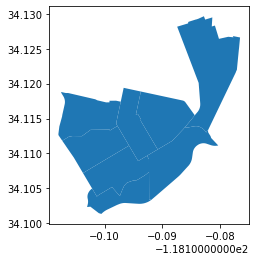

In [502]:
highlandpark.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

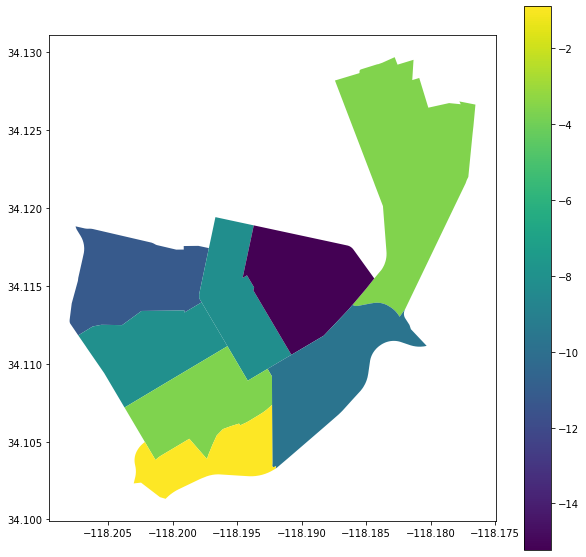

In [503]:
highlandpark.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [504]:
highlandpark_web_mercator = highlandpark.to_crs(epsg=3857)

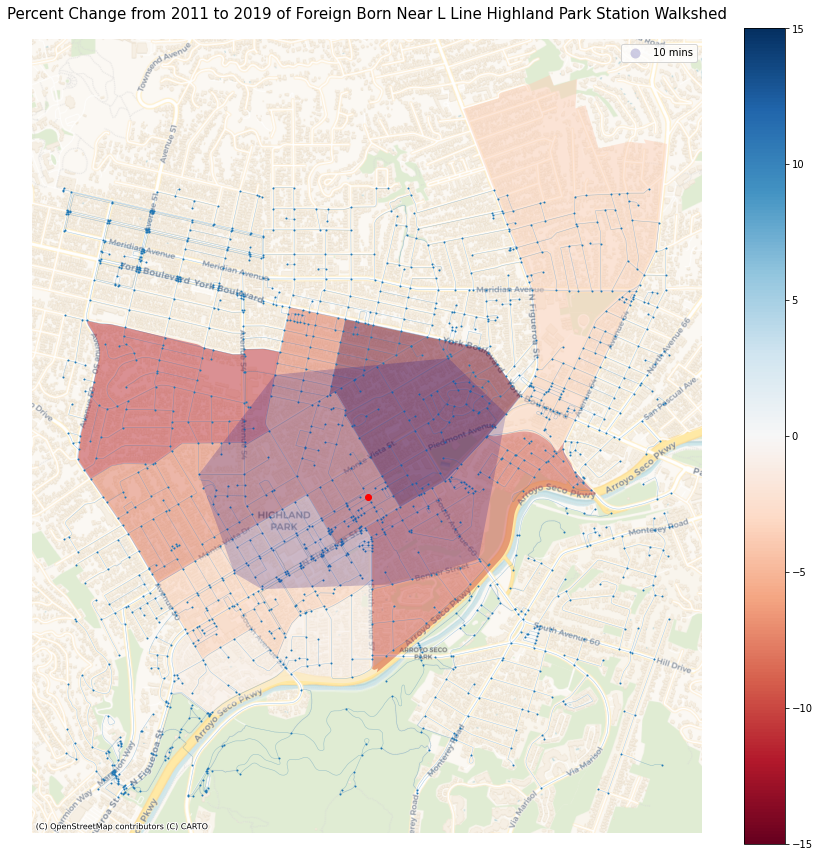

In [505]:
fig, ax = plt.subplots(figsize=(15, 15))
 
highlandpark_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, 
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.5,
                    cmap="RdBu")

# add the isochrones
isochrones_hlp.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node4]].plot(ax=ax,color='r', zorder=30)


# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Highland Park Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

KeyError: "None of [Int64Index([111964509], dtype='int64', name='osmid')] are in the [index]"

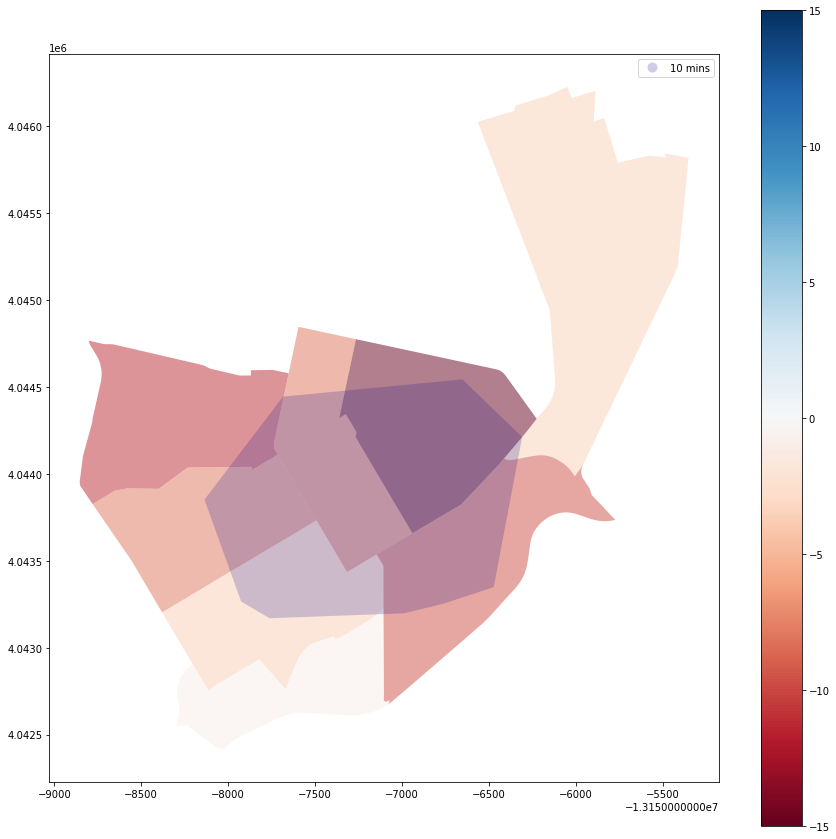

In [547]:
## clean with no nodes or edges

fig, ax = plt.subplots(figsize=(15, 15))
 
highlandpark_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, 
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.5,
                    cmap="RdBu")

# add the isochrones
isochrones_hlp.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node4]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change from 2011 to 2019 of Foreign Born Population in L Line Highland Park Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("HLPStation_ForeignBorn.jpg")

### Heritage Square Station

In [548]:
address = 'Heritage Square, Marmion Way, Dayton Avenue, Los Angeles, Los Angeles County, California, 90031-2212, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [549]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.28 s, sys: 32.3 ms, total: 3.32 s
Wall time: 3.33 s


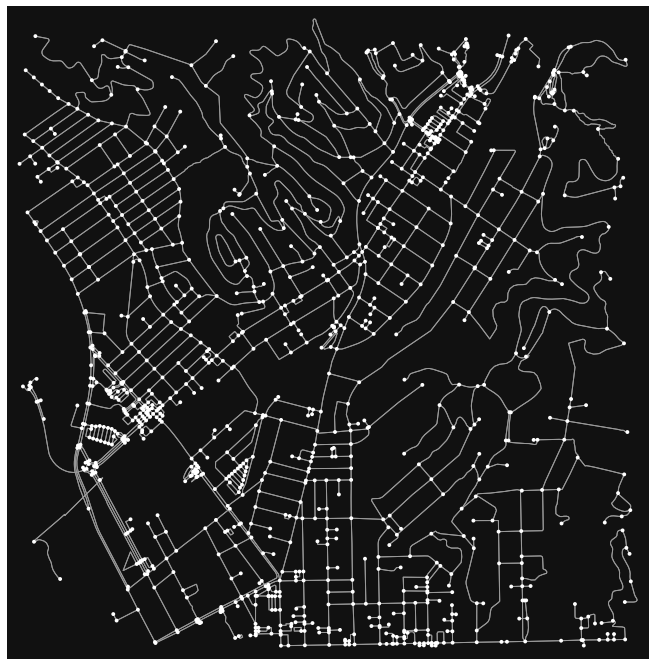

In [550]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [551]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [552]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [553]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
10559930,4.040461e+06,-1.316083e+07,traffic_signals,3,-118.225778,34.086785,POINT (-13160833.383 4040461.066)
6872663520,4.040451e+06,-1.316082e+07,NaN,4,-118.225648,34.086711,POINT (-13160818.979 4040451.213)
2156883458,4.040355e+06,-1.316083e+07,NaN,3,-118.225738,34.085997,POINT (-13160828.975 4040355.176)
18660349,4.040552e+06,-1.316084e+07,NaN,3,-118.225864,34.087459,POINT (-13160843.001 4040551.674)
14695503,4.040667e+06,-1.316087e+07,NaN,3,-118.226097,34.088318,POINT (-13160868.883 4040667.177)


### Plotting the station area

<AxesSubplot:>

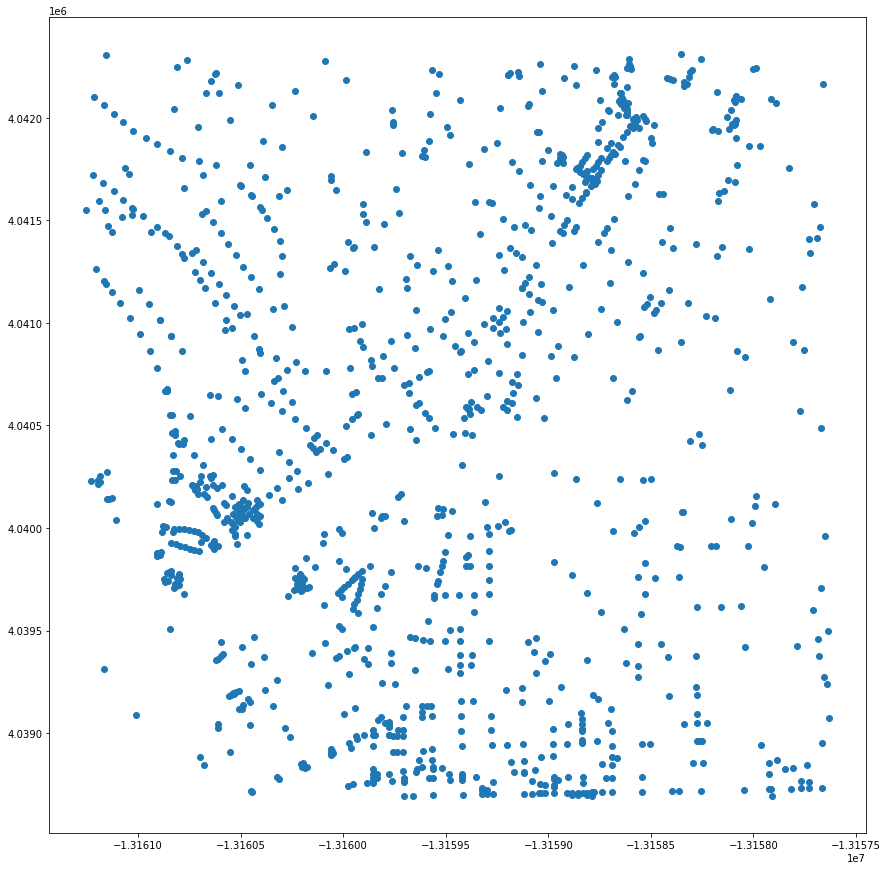

In [554]:
gdf_nodes.plot(figsize=(15,15))

In [555]:
gdf_edges.head()

osmid lanes               name    highway  \
u          v          key                                                  
10559930   6872663520 0    398375445     5     West Avenue 26    primary   
           2156883458 0    104359364   NaN  San Fernando Road  secondary   
           18660349   0    398374225     5  San Fernando Road    primary   
6872663520 10559930   0    398375445     5     West Avenue 26    primary   
           2156883447 0    398375445     5     West Avenue 26    primary   

                           oneway  length  \
u          v          key                   
10559930   6872663520 0     False  14.437   
           2156883458 0     False  87.691   
           18660349   0     False  75.390   
6872663520 10559930   0     False  14.437   
           2156883447 0     False  46.393   

                                                                    geometry  \
u          v          key                                                      
10559930   6872663520 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           2156883458 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           18660349   0    LINESTRING (-13160833.383 4040461.066, -131608...   
6872663520 10559930   0    LINESTRING (-13160818.979 4040451.213, -131608...   
           2156883447 0    LINESTRING (-13160818.979 4040451.213, -131607...   

                          access service maxspeed bridge width tunnel junction  
u          v          key                                                       
10559930   6872663520 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883458 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           18660349   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
6872663520 10559930   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883447 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN

<AxesSubplot:>

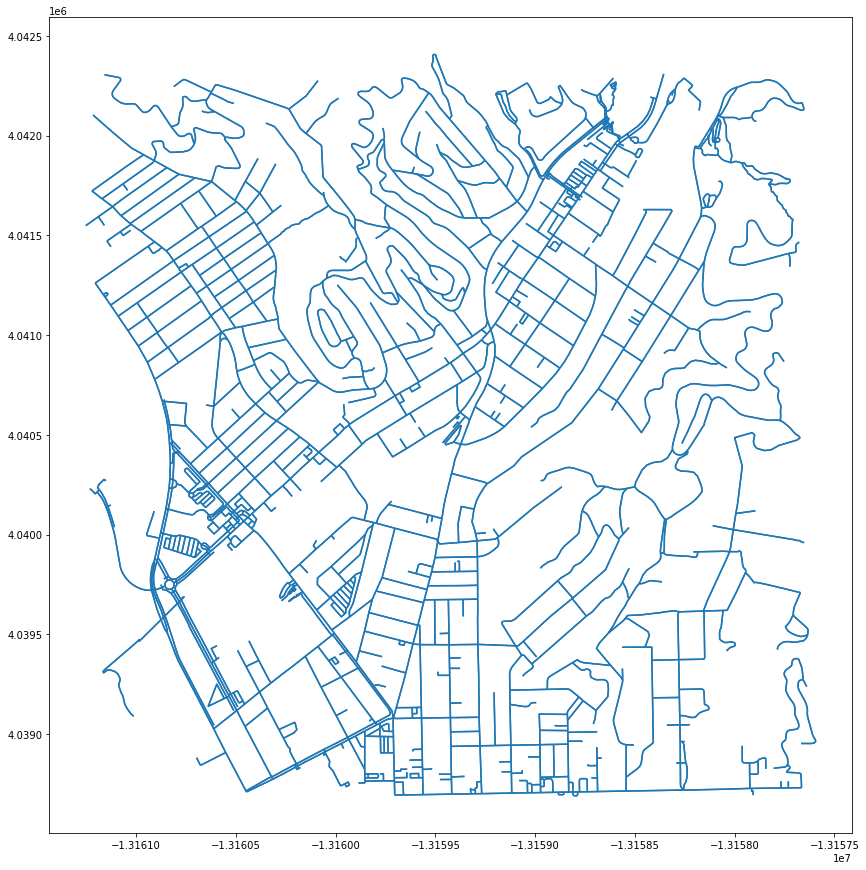

In [556]:
gdf_edges.plot(figsize=(15,15))

In [557]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13161252.734988471
4038694.329905593
-13157631.255918141
4042309.5162158757


In [558]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13159441.995453306
4040501.9230607343


In [559]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node3 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node3))

The id for the nearest node is 1995905139


In [560]:
# what is this record?
gdf_nodes.loc[[center_node3]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
1995905139,4.040537e+06,-1.315941e+07,NaN,1,-118.213003,34.087353,POINT (-13159411.288 4040537.413)


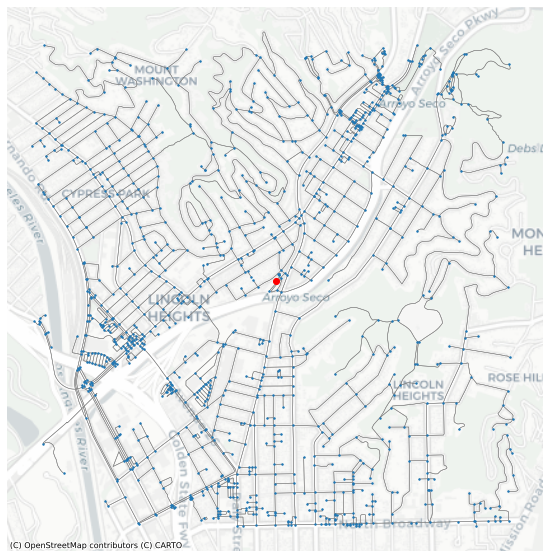

In [561]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node3]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [562]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction
u,v,key,,,,,,,,,,,,,,
8623228024,8623228026,0,929873811,NaN,NaN,footway,False,20.983,"LINESTRING (-13158578.696 4041960.206, -131585...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
3645297881,6872663710,0,733806859,NaN,NaN,footway,False,7.087,"LINESTRING (-13160049.594 4038900.409, -131600...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1995874976,5631781817,0,185887318,4,Avenue 26,primary,False,94.994,"LINESTRING (-13160165.255 4039713.404, -131601...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
806649029,806649009,0,66696176,NaN,NaN,service,False,186.448,"LINESTRING (-13159502.069 4039448.349, -131595...",NaN,alley,NaN,NaN,NaN,NaN,NaN
35833887,8410662441,0,3784012,NaN,Gates Street,residential,False,44.274,"LINESTRING (-13158690.973 4038934.774, -131586...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [563]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [564]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction,walk_time
u,v,key,,,,,,,,,,,,,,,
123330256,279072783,0,13467444,NaN,West Avenue 31,residential,False,192.447,"LINESTRING (-13159767.533 4039784.262, -131596...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.405588
279073058,7497608094,0,801602183,NaN,NaN,service,False,34.545,"LINESTRING (-13159235.114 4040952.504, -131592...",customers,NaN,NaN,NaN,NaN,NaN,NaN,0.431813
1614213166,6726885203,0,148313191,NaN,Granada Street,residential,False,72.295,"LINESTRING (-13161118.361 4041644.231, -131611...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.903687
7811382769,7811382770,0,836970816,NaN,NaN,service,False,13.954,"LINESTRING (-13159854.173 4038800.957, -131598...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.174425
7528072415,7528072413,0,47318687,NaN,NaN,footway,False,32.619,"LINESTRING (-13158619.584 4042012.607, -131585...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.407737


In [565]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [566]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [567]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, center_node3, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 142 nodes within 10 minutes 


In [568]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
7690745880,4.041951e+06,-1.315859e+07,NaN,4,-118.205595,34.097872,POINT (-13158586.622 4041951.468),NaN,NaN
76412998,4.038947e+06,-1.315898e+07,NaN,4,-118.209097,34.075520,POINT (-13158976.441 4038947.017),NaN,NaN
18364095,4.040947e+06,-1.315881e+07,NaN,3,-118.207582,34.090401,POINT (-13158807.780 4040947.114),10 mins,#0d0887
6789908777,4.038781e+06,-1.315971e+07,NaN,3,-118.215653,34.074286,POINT (-13159706.273 4038781.215),NaN,NaN
1609804294,4.041947e+06,-1.315820e+07,NaN,3,-118.202117,34.097835,POINT (-13158199.442 4041946.507),NaN,NaN
3660527658,4.038852e+06,-1.316020e+07,NaN,4,-118.220061,34.074811,POINT (-13160196.936 4038851.798),NaN,NaN
5549335048,4.040223e+06,-1.316070e+07,NaN,3,-118.224553,34.085017,POINT (-13160697.039 4040223.493),NaN,NaN
6787907205,4.041170e+06,-1.315913e+07,NaN,3,-118.210467,34.092062,POINT (-13159129.049 4041170.439),10 mins,#0d0887
1669445959,4.041957e+06,-1.315949e+07,NaN,1,-118.213748,34.097915,POINT (-13159494.232 4041957.208),NaN,NaN


In [569]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [570]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
6726264307,4.038833e+06,-1.315962e+07,NaN,1,-118.214857,34.074675,POINT (-13159617.741 4038833.494),NaN,#cccccc
7690778799,4.041692e+06,-1.315876e+07,NaN,1,-118.207190,34.095942,POINT (-13158764.199 4041691.979),NaN,#cccccc
3645297882,4.038766e+06,-1.315971e+07,NaN,3,-118.215649,34.074174,POINT (-13159705.906 4038766.122),NaN,#cccccc
7495693866,4.040187e+06,-1.316047e+07,NaN,3,-118.222500,34.084744,POINT (-13160468.523 4040186.772),NaN,#cccccc
7082081790,4.040005e+06,-1.316053e+07,NaN,3,-118.223041,34.083389,POINT (-13160528.735 4040004.595),NaN,#cccccc


<AxesSubplot:>

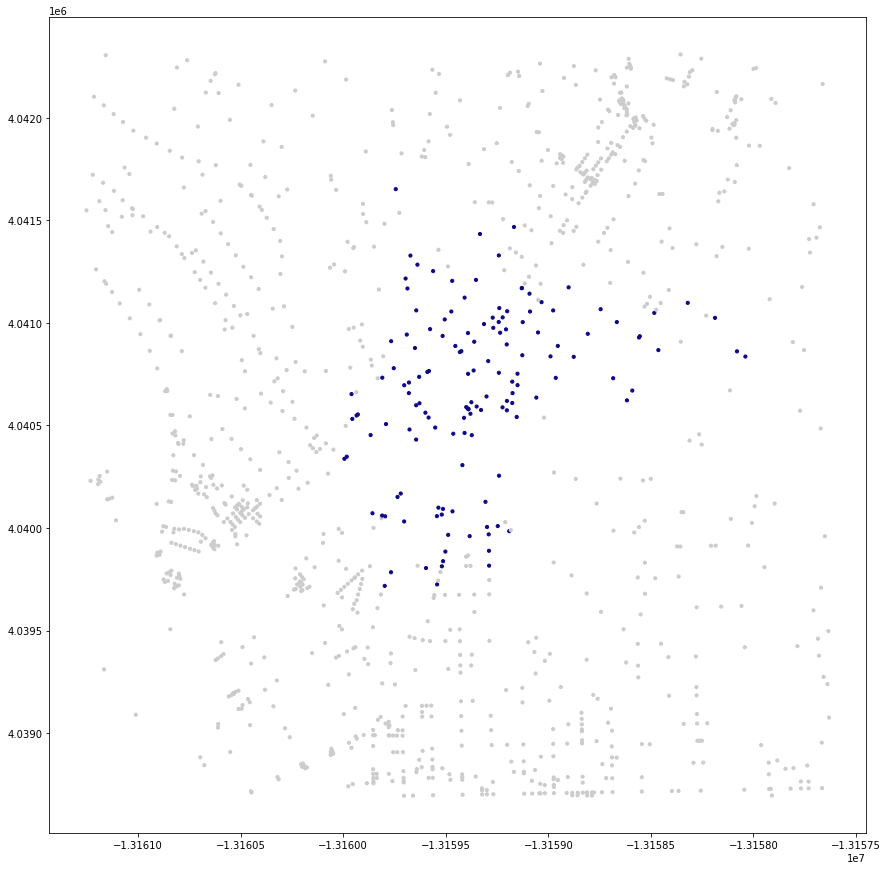

In [571]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

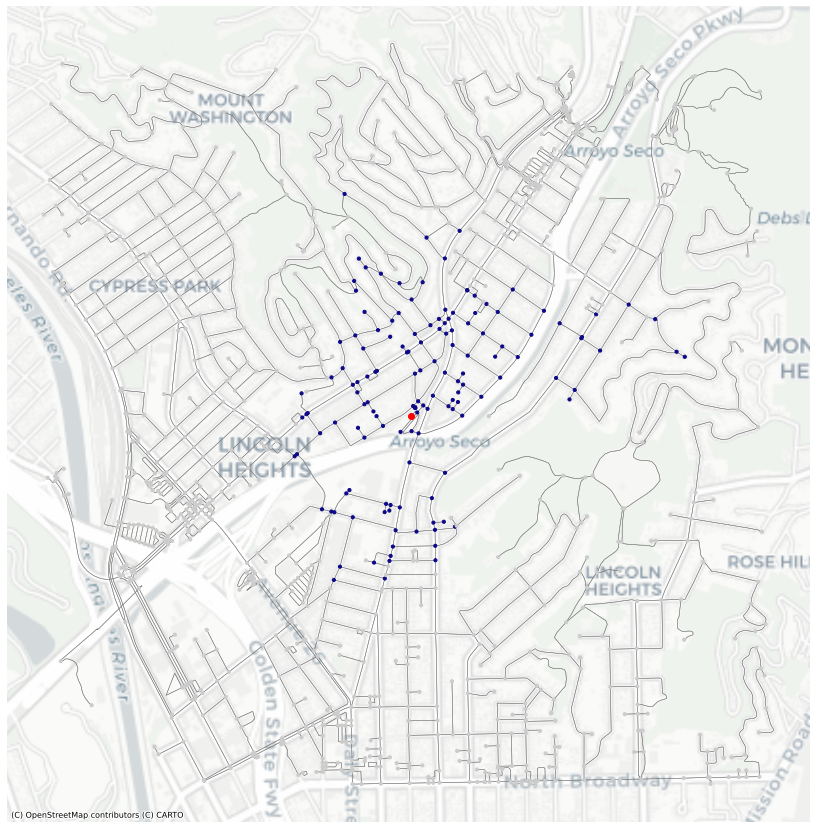

In [572]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node3]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [573]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
14965940,4.040909e+06,-1.315936e+07,NaN,4,-118.212555,34.090114,POINT (-13159361.484 4040908.522),10 mins,#0d0887
1669488556,4.040951e+06,-1.315939e+07,NaN,3,-118.212831,34.090428,POINT (-13159392.130 4040950.824),10 mins,#0d0887
18361081,4.040814e+06,-1.315929e+07,NaN,4,-118.211944,34.089410,POINT (-13159293.389 4040813.959),10 mins,#0d0887
27292003,4.040862e+06,-1.315942e+07,NaN,3,-118.213120,34.089771,POINT (-13159424.323 4040862.484),10 mins,#0d0887
7497608094,4.040976e+06,-1.315927e+07,NaN,3,-118.211721,34.090619,POINT (-13159268.554 4040976.390),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7428386997,4.040562e+06,-1.315960e+07,NaN,1,-118.214695,34.087539,POINT (-13159599.618 4040562.454),10 mins,#0d0887
7874387046,4.040620e+06,-1.315920e+07,NaN,1,-118.211124,34.087967,POINT (-13159202.119 4040619.930),10 mins,#0d0887
8880638493,4.040737e+06,-1.315963e+07,NaN,3,-118.214969,34.088841,POINT (-13159630.198 4040737.422),10 mins,#0d0887


In [574]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

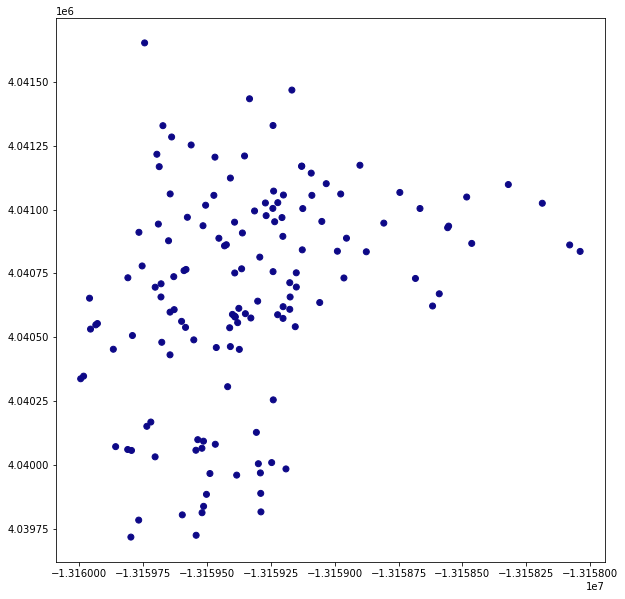

In [536]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

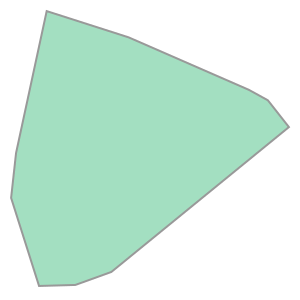

In [593]:
gdf_10.unary_union.convex_hull

In [599]:
# There's our polygon!
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13159994.736 4040337.648, -131599...",4.040909e+06,-1.315936e+07,traffic_signals,4,-118.212555,34.090114,#0d0887


In [600]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


In [601]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


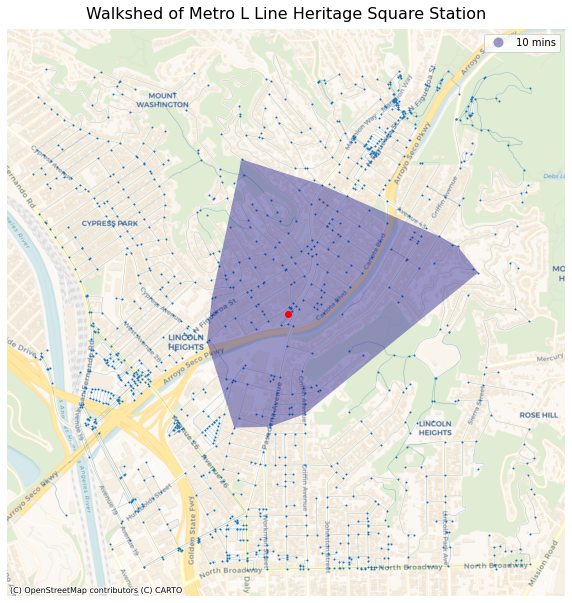

In [602]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                         ax=ax, 
                         column='time', 
                         cmap='plasma', 
                         legend=True,
                         zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node3]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Heritage Square Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

In [582]:
heritage = gdf[gdf["FIPS"].isin(['06037199000', 
                                     '06037185202', 
                                     '06037199400',
                                     '06037199300',
                                     '06037185310']
                                      )
                     ]

In [583]:
heritage.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born,% Europe,% Asia,% Latin America,% Caribbean,% Central America,% Mexico,% Other Central America,% South America,% Other Areas
375,06037185202,"Census Tract 1852.02, Los Angeles, CA",3897.0,1312.0,68.0,58.0,194.0,37.0,1032.0,0.0,0.0,973.0,857.0,178.0,116.0,30.0,59.0,12.0,18.0,0.0,3627.0,1028.0,79.0,66.0,0.0,190.0,37.0,763.0,0.0,0.0,700.0,507.0,0.0,193.0,15.0,63.0,18.0,9.0,9.0,"MULTIPOLYGON (((-118.22656 34.09795, -118.2265...",-5.323940,1.819686,5.238489,21.036669,0.00000,19.299697,13.978495,5.321202,1.736973,0.248139
378,06037185310,"Census Tract 1853.10, Los Angeles, CA",3398.0,1669.0,0.0,0.0,93.0,20.0,1563.0,0.0,0.0,1563.0,1376.0,189.0,187.0,31.0,0.0,0.0,13.0,13.0,3131.0,1166.0,79.0,17.0,0.0,155.0,0.0,986.0,0.0,0.0,953.0,739.0,9.0,214.0,62.0,33.0,0.0,8.0,8.0,"MULTIPOLYGON (((-118.22881 34.09588, -118.2264...",-11.876629,0.542958,4.950495,31.491536,0.00000,30.437560,23.602683,6.834877,1.053976,0.255509
483,06037199000,"Census Tract 1990, Los Angeles, CA",4711.0,2501.0,6.0,0.0,1214.0,345.0,1281.0,0.0,0.0,1238.0,1064.0,210.0,174.0,0.0,43.0,0.0,0.0,0.0,5391.0,2781.0,401.0,31.0,6.0,1015.0,256.0,1689.0,0.0,0.0,1670.0,1063.0,13.0,607.0,126.0,19.0,0.0,46.0,0.0,"MULTIPOLYGON (((-118.22723 34.08122, -118.2270...",-1.502540,0.575032,18.827676,31.329994,0.00000,30.977555,19.718049,11.259507,0.352439,0.853274
488,06037199300,"Census Tract 1993, Los Angeles, CA",4084.0,1331.0,50.0,10.0,278.0,84.0,984.0,0.0,0.0,966.0,839.0,46.0,127.0,0.0,18.0,11.0,19.0,0.0,4202.0,1470.0,133.0,62.0,22.0,380.0,12.0,965.0,11.0,0.0,902.0,663.0,54.0,239.0,0.0,52.0,15.0,63.0,30.0,"MULTIPOLYGON (((-118.21217 34.08388, -118.2120...",2.392744,1.475488,9.043313,22.965255,0.26178,21.465969,15.778201,5.687768,1.237506,1.499286
489,06037199400,"Census Tract 1994, Los Angeles, CA",4822.0,2388.0,0.0,0.0,666.0,222.0,1722.0,23.0,0.0,1699.0,1385.0,65.0,314.0,49.0,0.0,0.0,0.0,0.0,4759.0,2272.0,248.0,0.0,0.0,557.0,111.0,1696.0,0.0,0.0,1696.0,1295.0,39.0,401.0,98.0,0.0,0.0,19.0,0.0,"MULTIPOLYGON (((-118.21481 34.07928, -118.2145...",-1.781897,0.000000,11.704140,35.637739,0.00000,35.637739,27.211599,8.426140,0.000000,0.399244


<AxesSubplot:>

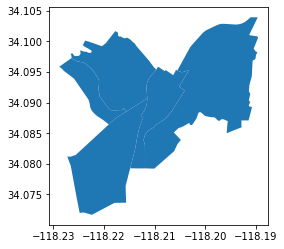

In [584]:
heritage.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

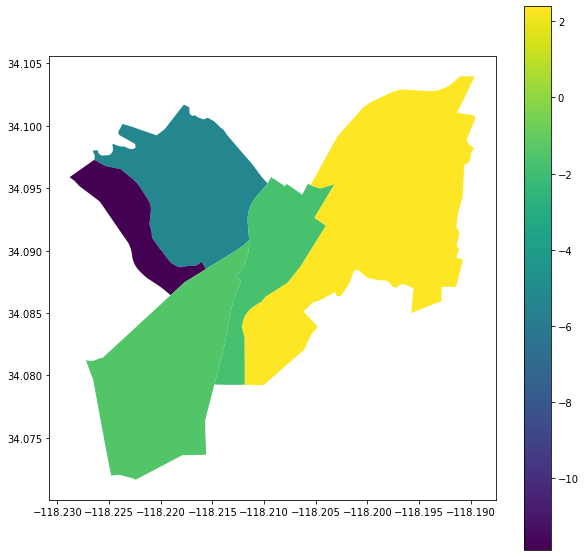

In [585]:
heritage.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [586]:
heritage_web_mercator = heritage.to_crs(epsg=3857)

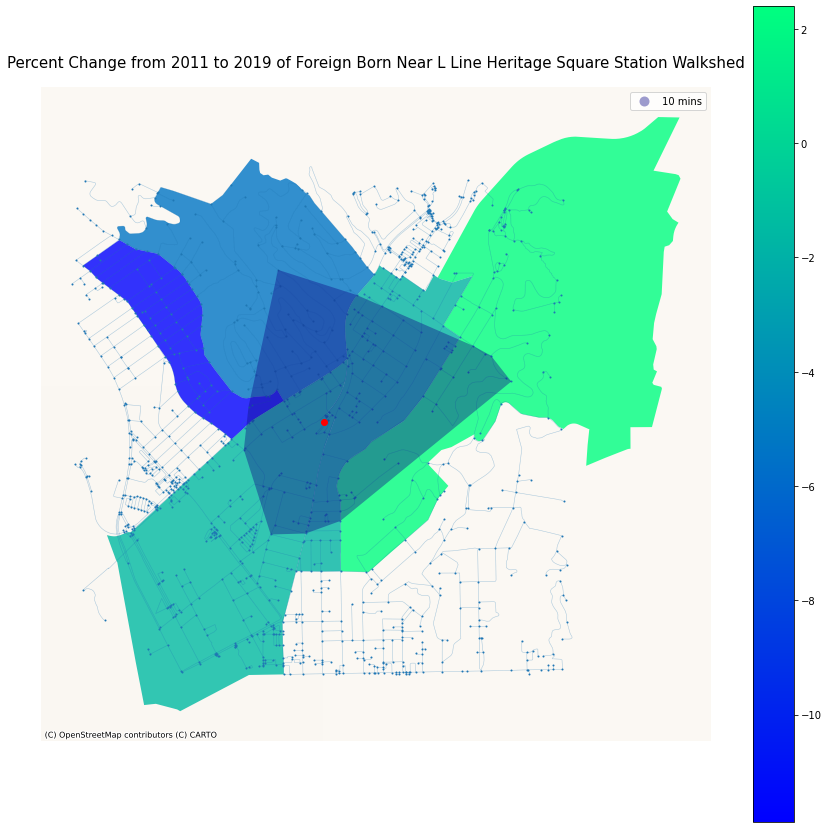

In [603]:
fig, ax = plt.subplots(figsize=(15, 15))
 
heritage_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8,
                    cmap="winter")

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node3]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Heritage Square Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

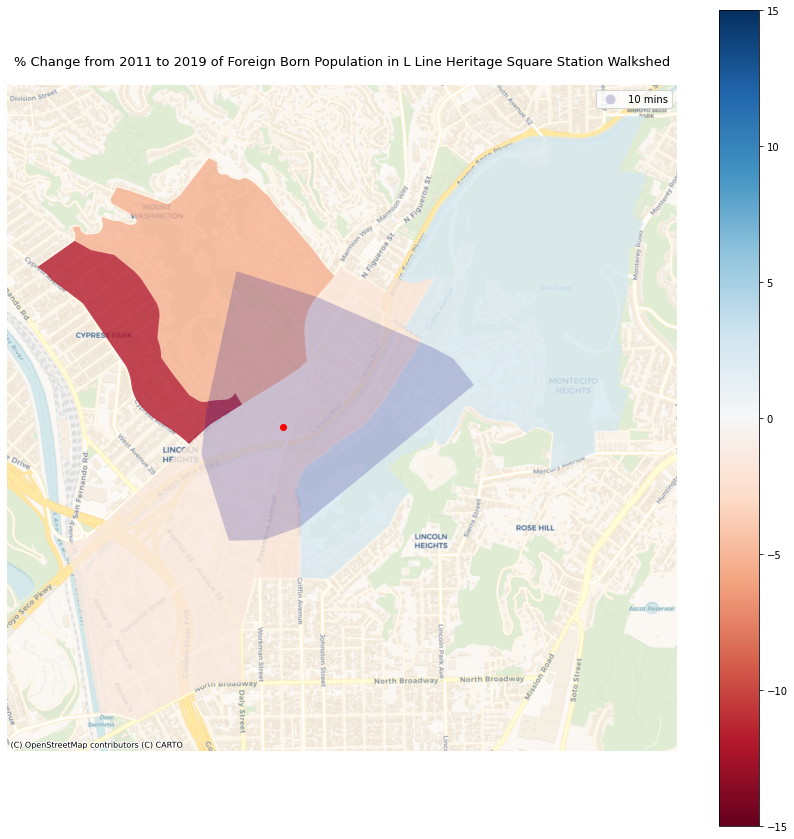

In [614]:
## running it again clean with no nodes or edges

fig, ax = plt.subplots(figsize=(15, 15))
 
heritage_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax,
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.8,
                    cmap="RdBu")

# add the isochrones
isochrones.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node3]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change from 2011 to 2019 of Foreign Born Population in L Line Heritage Square Station Walkshed',fontsize=13, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("HeritageSquareStation_ForeignBorn.jpg")

### Mariachi Plaza Station

In [615]:
# Let's start by orienting ourselves around the Mariachi Plaza Station by calling for it by address in osmnx

address = 'Mariachi Plaza, Metro Gold Line Entrance, Brooklyn Heights, Boyle Heights, Los Angeles, Los Angeles County, California, 90033, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [616]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.57 s, sys: 63.4 ms, total: 3.63 s
Wall time: 3.65 s


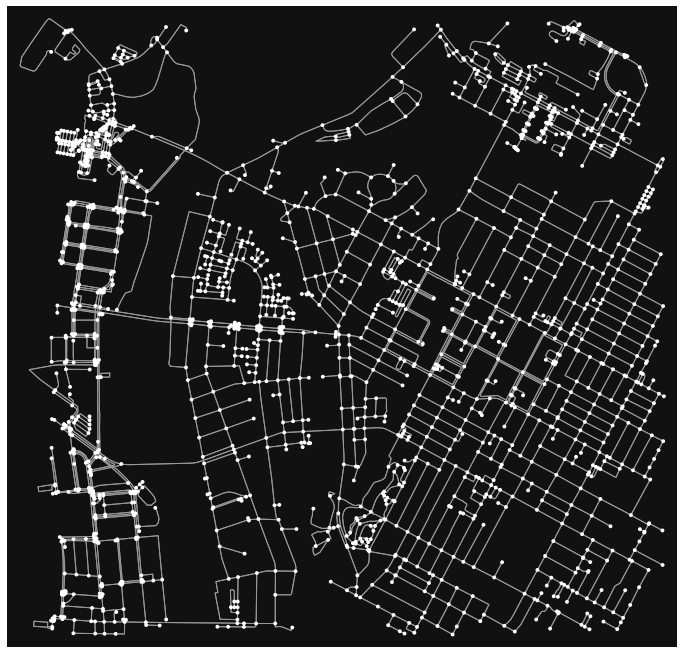

In [617]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [618]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [619]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [620]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
14941481,4.036783e+06,-1.315848e+07,stop,3,-118.204655,34.059417,POINT (-13158481.982 4036783.097)
8772109642,4.036793e+06,-1.315848e+07,crossing,4,-118.204605,34.059495,POINT (-13158476.416 4036793.498)
604238739,4.036724e+06,-1.315839e+07,NaN,4,-118.203870,34.058981,POINT (-13158394.652 4036724.445)
15373745,4.036812e+06,-1.315854e+07,NaN,3,-118.205136,34.059632,POINT (-13158535.560 4036812.014)
14941485,4.036619e+06,-1.315836e+07,NaN,3,-118.203524,34.058197,POINT (-13158356.146 4036619.141)


<AxesSubplot:>

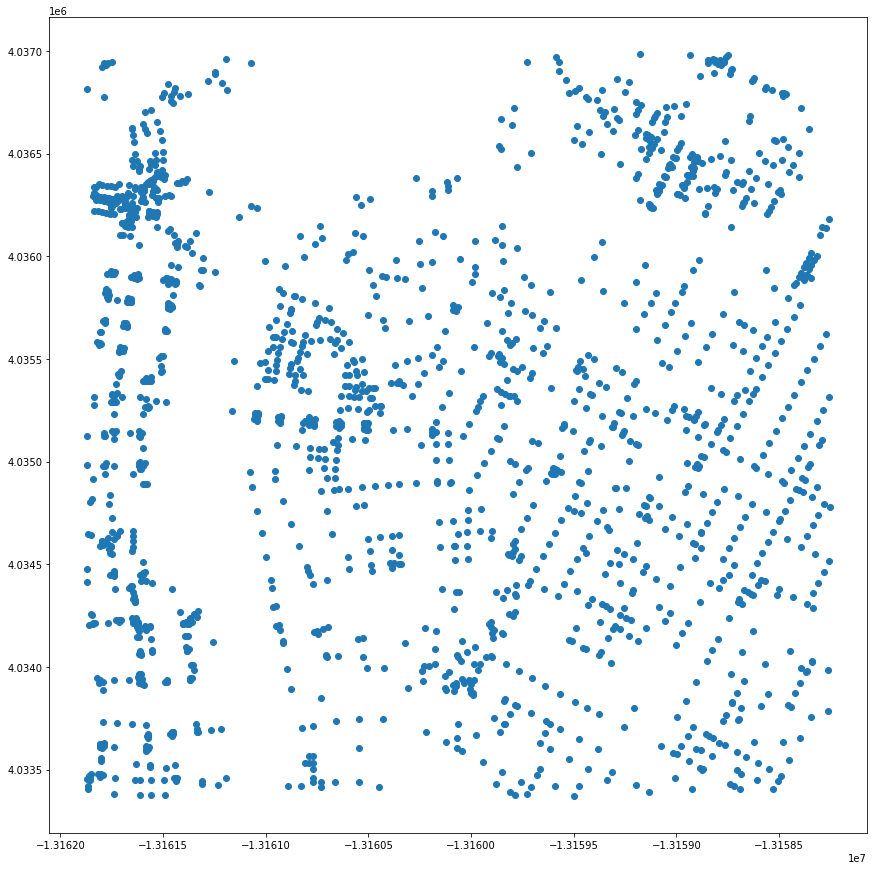

In [621]:
gdf_nodes.plot(figsize=(15,15))

In [622]:
gdf_edges.head()

osmid              name      highway  oneway  \
u          v          key                                                     
14941481   8772109642 0    161709222  San Pablo Street  residential   False   
           604238739  0    161709223      Zonal Avenue  residential   False   
           15373745   0    161709223      Zonal Avenue  residential   False   
8772109642 14941481   0    161709222  San Pablo Street  residential   False   
           8772216945 0    947706656               NaN      footway   False   

                           length  \
u          v          key           
14941481   8772109642 0     9.762   
           604238739  0    87.618   
           15373745   0    50.384   
8772109642 14941481   0     9.762   
           8772216945 0     9.079   

                                                                    geometry  \
u          v          key                                                      
14941481   8772109642 0    LINESTRING (-13158481.982 4036783.097, -131584...   
           604238739  0    LINESTRING (-13158481.982 4036783.097, -131584...   
           15373745   0    LINESTRING (-13158481.982 4036783.097, -131584...   
8772109642 14941481   0    LINESTRING (-13158476.416 4036793.498, -131584...   
           8772216945 0    LINESTRING (-13158476.416 4036793.498, -131584...   

                          lanes maxspeed access bridge service tunnel width  
u          v          key                                                    
14941481   8772109642 0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           604238739  0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           15373745   0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
8772109642 14941481   0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           8772216945 0     NaN      NaN    NaN    NaN     NaN    NaN   NaN

<AxesSubplot:>

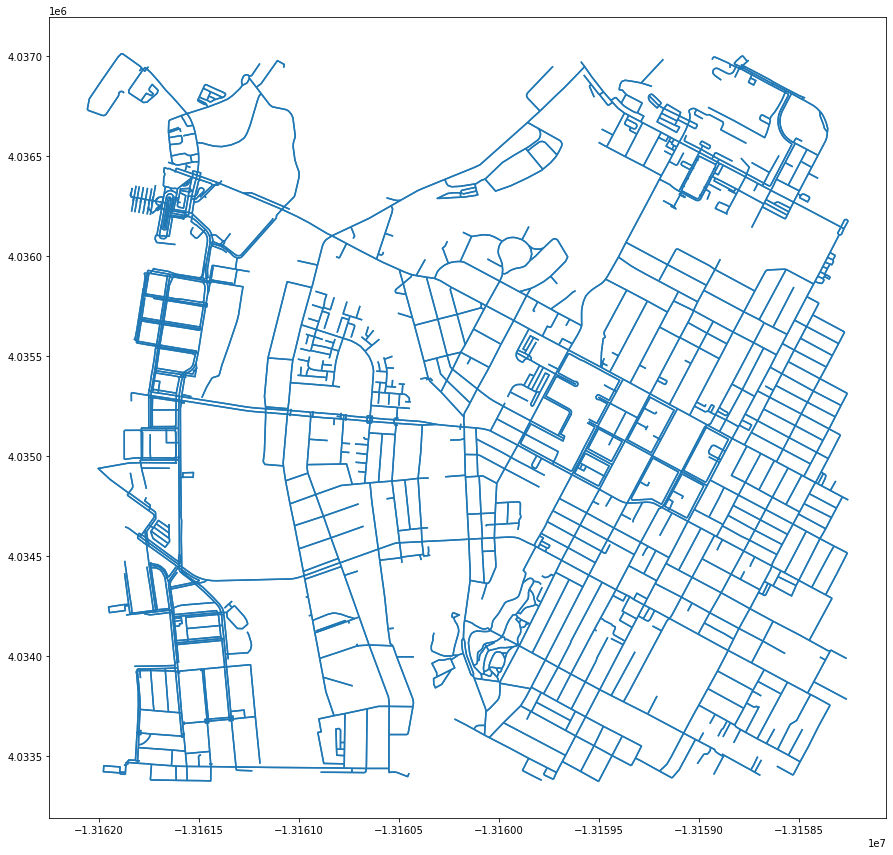

In [623]:
gdf_edges.plot(figsize=(15,15))

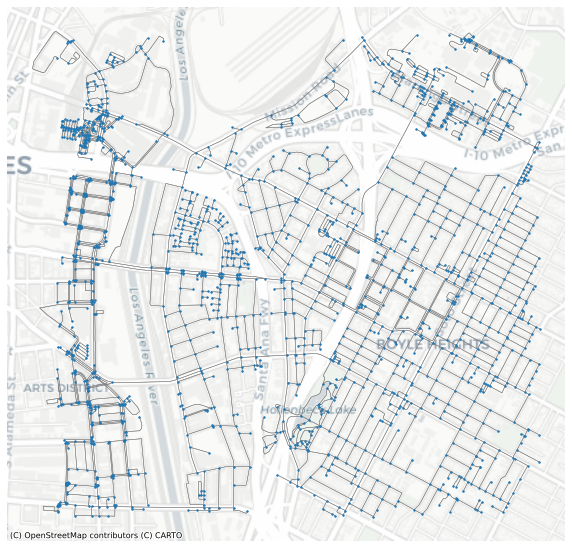

In [624]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [625]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13161872.984927278
4033373.0514499233
-13158251.594912536
4036983.296539621


In [626]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13160062.289919907
4035178.173994772


In [627]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node2 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node2))

The id for the nearest node is 2935903748


In [628]:
# what is this record?
gdf_nodes.loc[[center_node2]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
2935903748,4.035186e+06,-1.316001e+07,NaN,3,-118.218374,34.047528,POINT (-13160009.241 4035185.662)


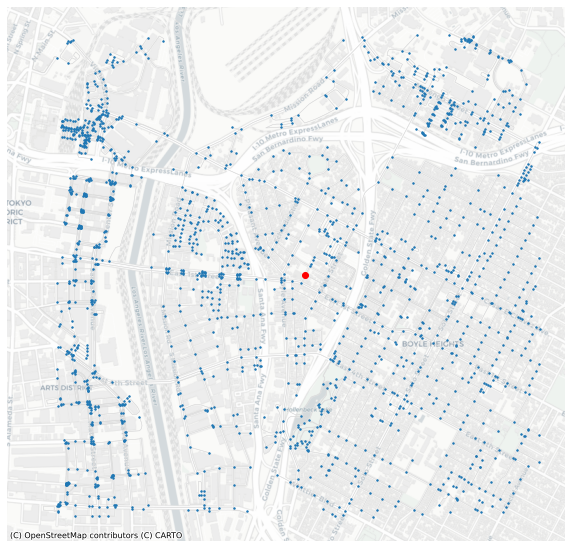

In [629]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node2]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [630]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,access,bridge,service,tunnel,width
u,v,key,,,,,,,,,,,,,
3611041523,9071150193,0,161689966,Commercial Street,unclassified,False,6.113,"LINESTRING (-13161445.474 4035873.465, -131614...",2,NaN,NaN,NaN,NaN,NaN,NaN
605181914,5987518219,0,634477672,NaN,service,False,10.747,"LINESTRING (-13159521.338 4034132.132, -131595...",NaN,NaN,NaN,NaN,alley,NaN,NaN
122945890,122945891,0,13342736,North Saint Louis Street,residential,False,53.809,"LINESTRING (-13159004.515 4035770.815, -131589...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
123182636,5549427303,0,382439721,East 2nd Street,secondary,False,64.651,"LINESTRING (-13161738.711 4035138.344, -131616...",2,NaN,NaN,NaN,NaN,NaN,NaN
7882489893,604238485,0,47474563,NaN,service,False,115.659,"LINESTRING (-13158699.912 4033742.101, -131587...",NaN,NaN,NaN,NaN,alley,NaN,NaN


In [631]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [632]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,access,bridge,service,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,
4409000197,4409000542,0,"[443287590, 443287484, 443287430, 443287407]",NaN,"[footway, steps]",False,15.123,"LINESTRING (-13161767.910 4036264.886, -131617...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.189038
123030030,7179460778,0,13448593,Kingston Avenue,residential,False,31.337,"LINESTRING (-13158996.456 4036517.519, -131590...",2,NaN,NaN,NaN,NaN,NaN,NaN,0.391713
123232157,123051542,0,13387642,Calle Pedro Infante,residential,False,76.726,"LINESTRING (-13158608.641 4033449.216, -131585...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.959075
9071150197,279044850,0,355511656,Center Street,unclassified,False,45.093,"LINESTRING (-13161443.681 4035865.135, -131614...",2,NaN,NaN,NaN,NaN,NaN,NaN,0.563662
72568812,122713960,0,518090282,Gabriel Garcia Marquez Street,tertiary,False,64.938,"LINESTRING (-13160986.214 4035655.255, -131609...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.811725


In [633]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [634]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [635]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 2935903748, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 287 nodes within 10 minutes 


In [636]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
4604376781,4.034651e+06,-1.315888e+07,NaN,3,-118.208240,34.043549,POINT (-13158881.073 4034651.079),NaN,NaN
15373749,4.036563e+06,-1.315852e+07,NaN,3,-118.204966,34.057781,POINT (-13158516.569 4036563.217),NaN,NaN
7882619526,4.036792e+06,-1.316138e+07,NaN,3,-118.230681,34.059484,POINT (-13161379.250 4036792.100),NaN,NaN
8400881071,4.036299e+06,-1.316147e+07,NaN,3,-118.231504,34.055817,POINT (-13161470.810 4036299.404),NaN,NaN
9456170509,4.035645e+06,-1.316149e+07,NaN,3,-118.231701,34.050945,POINT (-13161492.762 4035644.802),NaN,NaN
8881865777,4.036205e+06,-1.316164e+07,NaN,3,-118.233041,34.055116,POINT (-13161641.863 4036205.215),NaN,NaN
9413699404,4.034984e+06,-1.316187e+07,NaN,3,-118.235082,34.046028,POINT (-13161869.144 4034984.138),NaN,NaN
4614871600,4.034843e+06,-1.315887e+07,NaN,3,-118.208161,34.044974,POINT (-13158872.301 4034842.576),NaN,NaN
4279710596,4.035018e+06,-1.315841e+07,NaN,4,-118.204006,34.046281,POINT (-13158409.802 4035018.195),NaN,NaN


In [637]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [638]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
4454249238,4.036327e+06,-1.316164e+07,NaN,3,-118.232996,34.056022,POINT (-13161636.854 4036326.962),NaN,#cccccc
279044965,4.036228e+06,-1.316164e+07,NaN,3,-118.233008,34.055285,POINT (-13161638.201 4036227.882),NaN,#cccccc
123219214,4.034494e+06,-1.316049e+07,NaN,4,-118.222657,34.042383,POINT (-13160486.000 4034494.395),NaN,#cccccc
9074390819,4.035791e+06,-1.316166e+07,crossing,3,-118.233196,34.052033,POINT (-13161659.151 4035790.902),NaN,#cccccc
3413775187,4.033502e+06,-1.316077e+07,NaN,3,-118.225216,34.034996,POINT (-13160770.877 4033502.062),NaN,#cccccc


<AxesSubplot:>

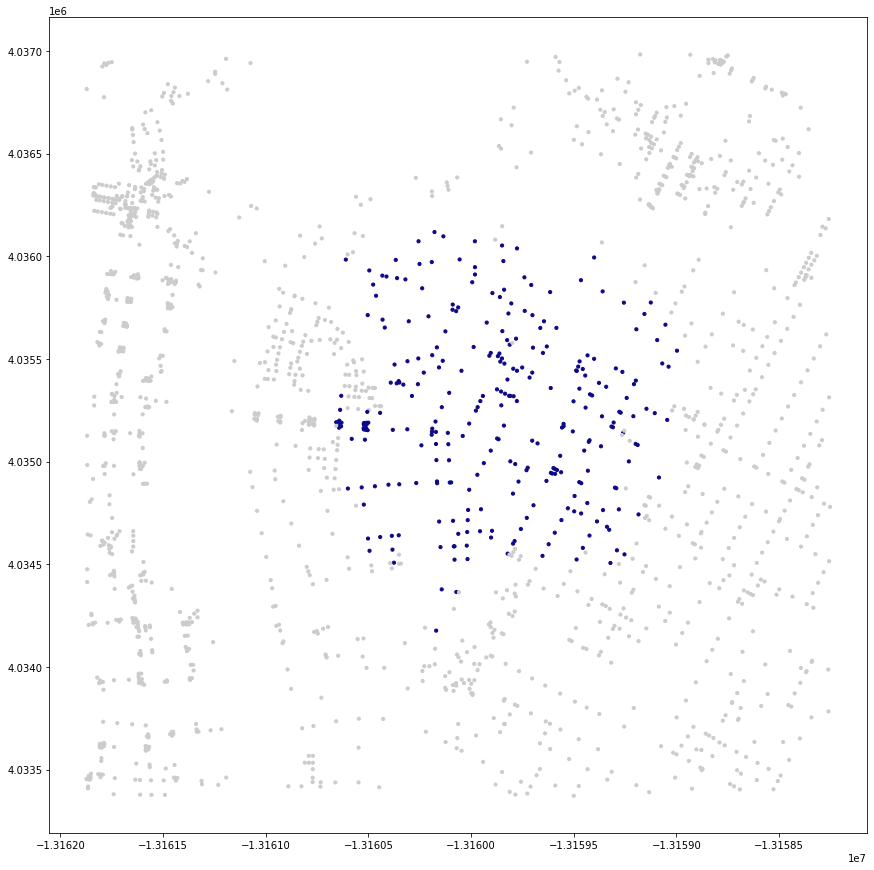

In [639]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

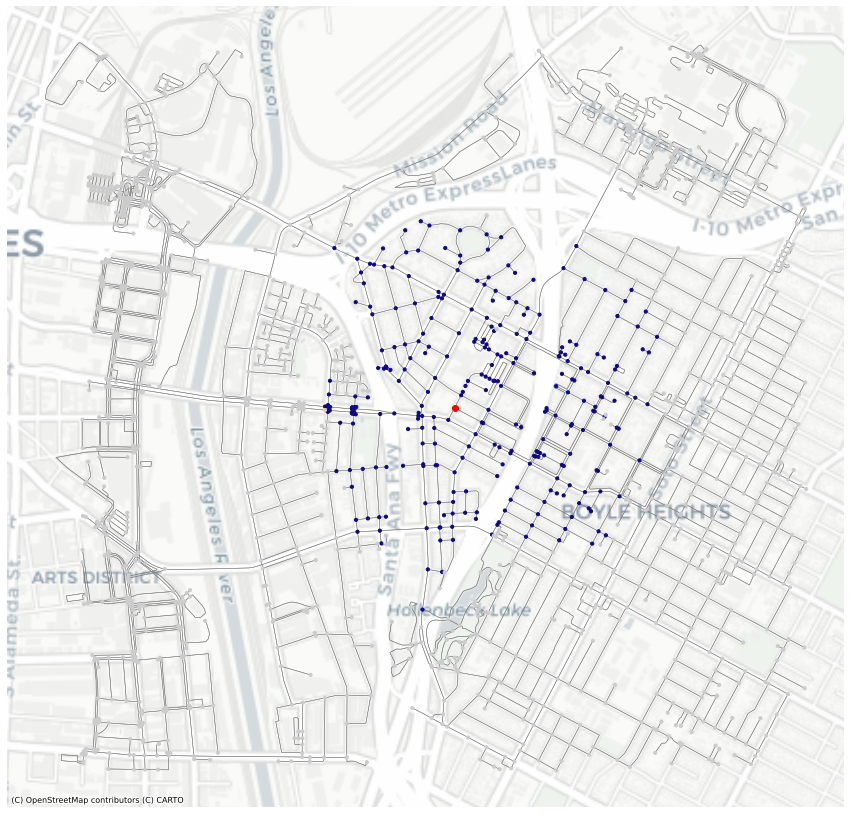

In [640]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[2935903748]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [641]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
15713713,4.034584e+06,-1.316015e+07,traffic_signals,4,-118.219629,34.043049,POINT (-13160148.902 4034583.948),10 mins,#0d0887
604238292,4.034588e+06,-1.316008e+07,NaN,3,-118.219048,34.043076,POINT (-13160084.214 4034587.562),10 mins,#0d0887
72744268,4.034572e+06,-1.316038e+07,NaN,4,-118.221731,34.042958,POINT (-13160382.907 4034571.655),10 mins,#0d0887
604238295,4.034708e+06,-1.316016e+07,NaN,3,-118.219688,34.043976,POINT (-13160155.503 4034708.498),10 mins,#0d0887
123413088,4.034378e+06,-1.316014e+07,NaN,3,-118.219576,34.041517,POINT (-13160143.013 4034378.068),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7875081594,4.035722e+06,-1.315982e+07,NaN,1,-118.216658,34.051518,POINT (-13159818.138 4035721.748),10 mins,#0d0887
8395946642,4.034758e+06,-1.315950e+07,NaN,1,-118.213780,34.044345,POINT (-13159497.750 4034757.991),10 mins,#0d0887
8395946644,4.034748e+06,-1.315946e+07,NaN,1,-118.213476,34.044269,POINT (-13159463.975 4034747.888),10 mins,#0d0887


In [642]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

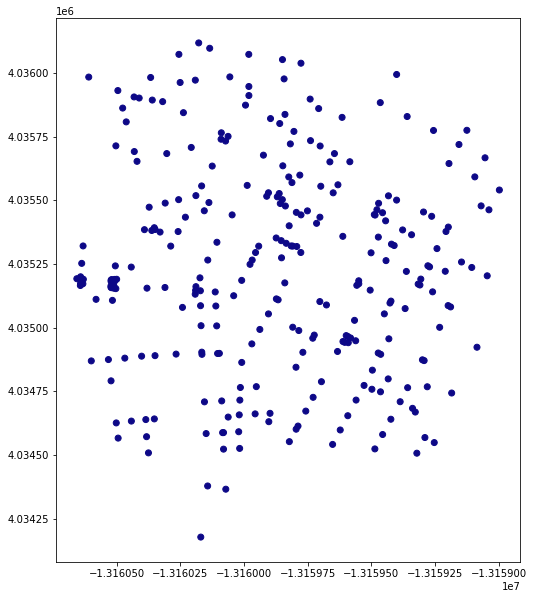

In [643]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

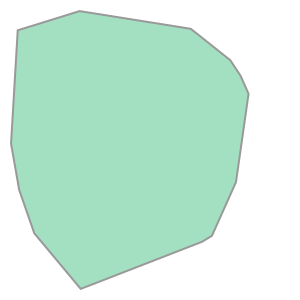

In [644]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [645]:
isochrones_mariachi = gdf_nodes.dissolve("time")
isochrones_mariachi

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13160656.853 4035192.232, -131606...",4.034584e+06,-1.316015e+07,traffic_signals,4,-118.219629,34.043049,#0d0887


In [646]:
isochrones_mariachi = isochrones_mariachi.convex_hull.reset_index()
isochrones_mariachi

,time,0
0,10 mins,"POLYGON ((-13160169.964 4034177.270, -13160494..."


In [647]:
isochrones_mariachi.columns=['time','geometry']
isochrones_mariachi

,time,geometry
0,10 mins,"POLYGON ((-13160169.964 4034177.270, -13160494..."


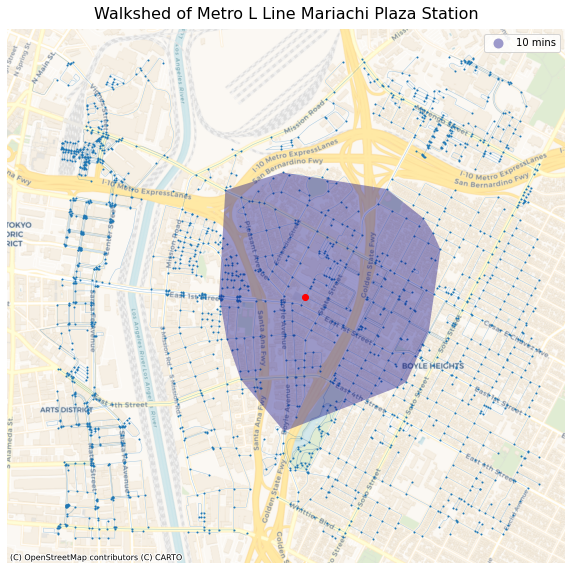

In [648]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones_mariachi.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node2]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Mariachi Plaza Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

In [649]:
mariachi = gdf[gdf["FIPS"].isin(['06037203500', 
                                 '06037203600', 
                                 '06037204410',
                                 '06037204420',
                                 '06037204600',
                                 '06037206050',
                                 '06037206032']
                                    )
                     ]

In [650]:
mariachi.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born,% Europe,% Asia,% Latin America,% Caribbean,% Central America,% Mexico,% Other Central America,% South America,% Other Areas
509,06037203500,"Census Tract 2035, Los Angeles, CA",3339.0,1459.0,0.0,0.0,375.0,221.0,1075.0,0.0,0.0,1075.0,872.0,93.0,203.0,21.0,0.0,0.0,9.0,0.0,2907.0,1200.0,99.0,6.0,3.0,309.0,90.0,885.0,6.0,0.0,879.0,728.0,6.0,151.0,0.0,0.0,0.0,0.0,0.0,"MULTIPOLYGON (((-118.22845 34.05311, -118.2284...",-2.416048,0.206398,10.629515,30.443756,0.206398,30.237358,25.043000,5.194358,0.000000,0.000000
510,06037203600,"Census Tract 2036, Los Angeles, CA",4572.0,2072.0,0.0,0.0,0.0,0.0,2072.0,0.0,0.0,2072.0,1902.0,486.0,170.0,26.0,0.0,0.0,0.0,0.0,5276.0,2256.0,313.0,11.0,0.0,31.0,0.0,2214.0,0.0,0.0,2170.0,1856.0,200.0,314.0,102.0,44.0,11.0,0.0,0.0,"MULTIPOLYGON (((-118.21404 34.05515, -118.2140...",-2.559669,0.208491,0.587566,41.963609,0.000000,41.129644,35.178165,5.951478,0.833965,0.000000
519,06037204410,"Census Tract 2044.10, Los Angeles, CA",2239.0,1264.0,2.0,0.0,0.0,0.0,1262.0,0.0,0.0,1262.0,1221.0,362.0,41.0,8.0,0.0,0.0,0.0,0.0,2575.0,1184.0,76.0,0.0,0.0,27.0,0.0,1157.0,0.0,0.0,1157.0,1025.0,27.0,132.0,49.0,0.0,0.0,0.0,0.0,"MULTIPOLYGON (((-118.21841 34.04440, -118.2183...",-10.473191,0.000000,1.048544,44.932039,0.000000,44.932039,39.805825,5.126214,0.000000,0.000000
520,06037204420,"Census Tract 2044.20, Los Angeles, CA",3719.0,2077.0,0.0,0.0,39.0,0.0,2038.0,9.0,0.0,2029.0,1731.0,366.0,298.0,156.0,0.0,0.0,0.0,0.0,3154.0,1419.0,86.0,0.0,0.0,49.0,0.0,1370.0,54.0,0.0,1316.0,1127.0,45.0,189.0,41.0,0.0,0.0,0.0,0.0,"MULTIPOLYGON (((-118.21489 34.04315, -118.2143...",-10.857858,0.000000,1.553583,43.436906,1.712112,41.724794,35.732403,5.992391,0.000000,0.000000
521,06037204600,"Census Tract 2046, Los Angeles, CA",4566.0,2412.0,0.0,0.0,0.0,0.0,2412.0,10.0,0.0,2402.0,2331.0,656.0,71.0,34.0,0.0,0.0,0.0,0.0,4080.0,1612.0,81.0,0.0,0.0,50.0,13.0,1548.0,5.0,0.0,1522.0,1278.0,0.0,244.0,54.0,21.0,0.0,14.0,14.0,"MULTIPOLYGON (((-118.22040 34.02978, -118.2203...",-13.315426,0.000000,1.225490,37.941176,0.122549,37.303922,31.323529,5.980392,0.514706,0.343137


<AxesSubplot:>

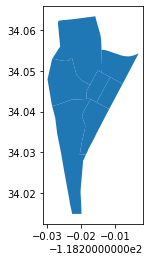

In [330]:
mariachi.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

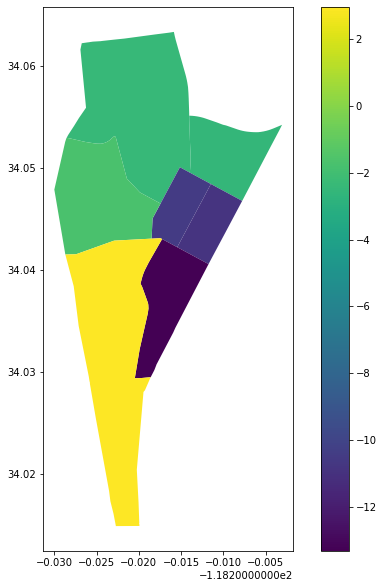

In [651]:
mariachi.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [652]:
mariachi_web_mercator = mariachi.to_crs(epsg=3857)

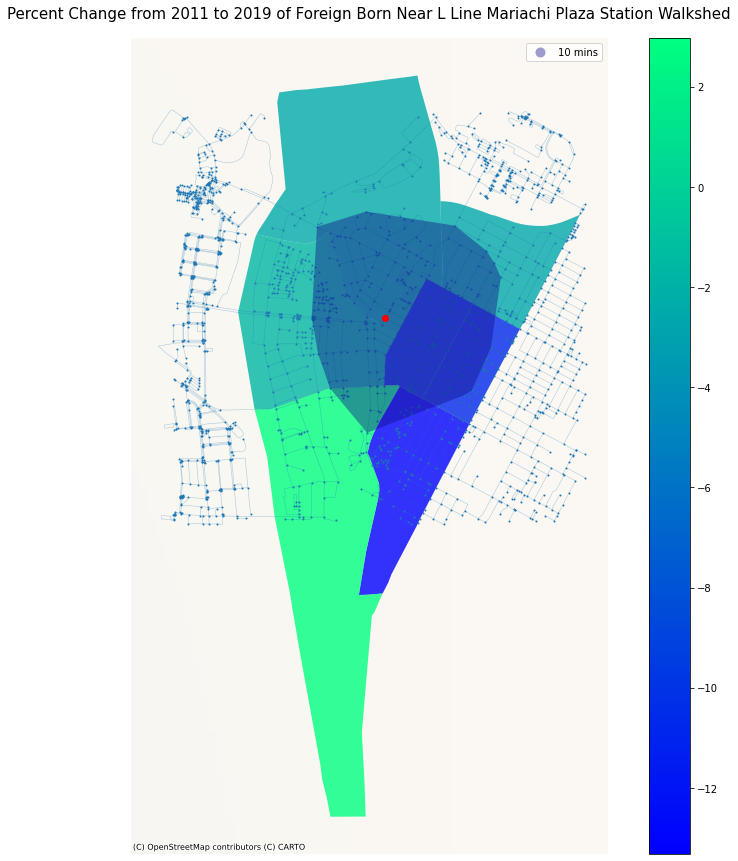

In [653]:
fig, ax = plt.subplots(figsize=(15, 15))
 
mariachi_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8,
                    cmap="winter")

# add the isochrones
isochrones_mariachi.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node2]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Mariachi Plaza Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

## East LA Civic Center Station

In [334]:
# Let's start by orienting ourselves around the East LA Civic Center Station by calling for it by address in osmnx

address = 'East Los Angeles Civic Center, East 3rd Street, Belvedere Gardens, East Los Angeles, Los Angeles County, California, 90022-1601, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [335]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.94 s, sys: 33.8 ms, total: 3.97 s
Wall time: 4.12 s


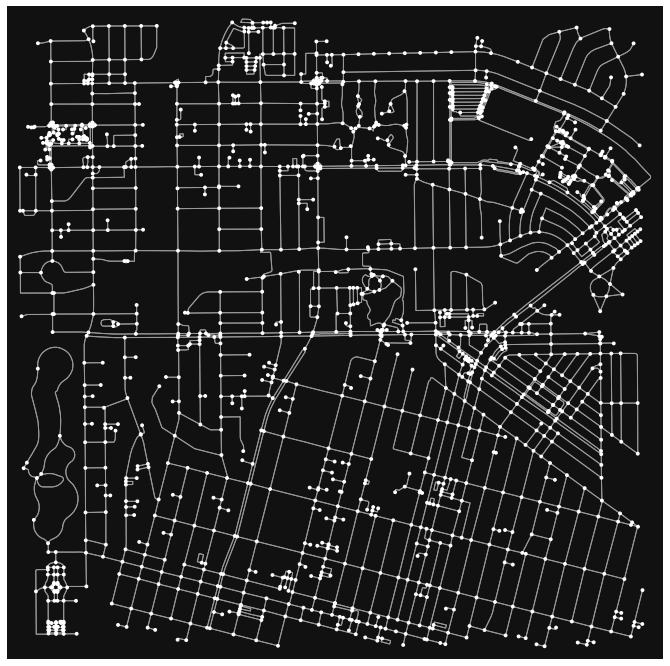

In [336]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [337]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [338]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [339]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
17445327,4.033839e+06,-1.315200e+07,traffic_signals,4,-118.146421,34.037501,POINT (-13151999.403 4033838.580)
8414804812,4.033816e+06,-1.315203e+07,NaN,3,-118.146684,34.037336,POINT (-13152028.735 4033816.401)
8414804800,4.033858e+06,-1.315197e+07,NaN,3,-118.146197,34.037648,POINT (-13151974.467 4033858.327)
3643016816,4.033796e+06,-1.315196e+07,NaN,4,-118.146107,34.037181,POINT (-13151964.459 4033795.566)
8414804799,4.033863e+06,-1.315202e+07,NaN,3,-118.146602,34.037683,POINT (-13152019.540 4033863.055)


<AxesSubplot:>

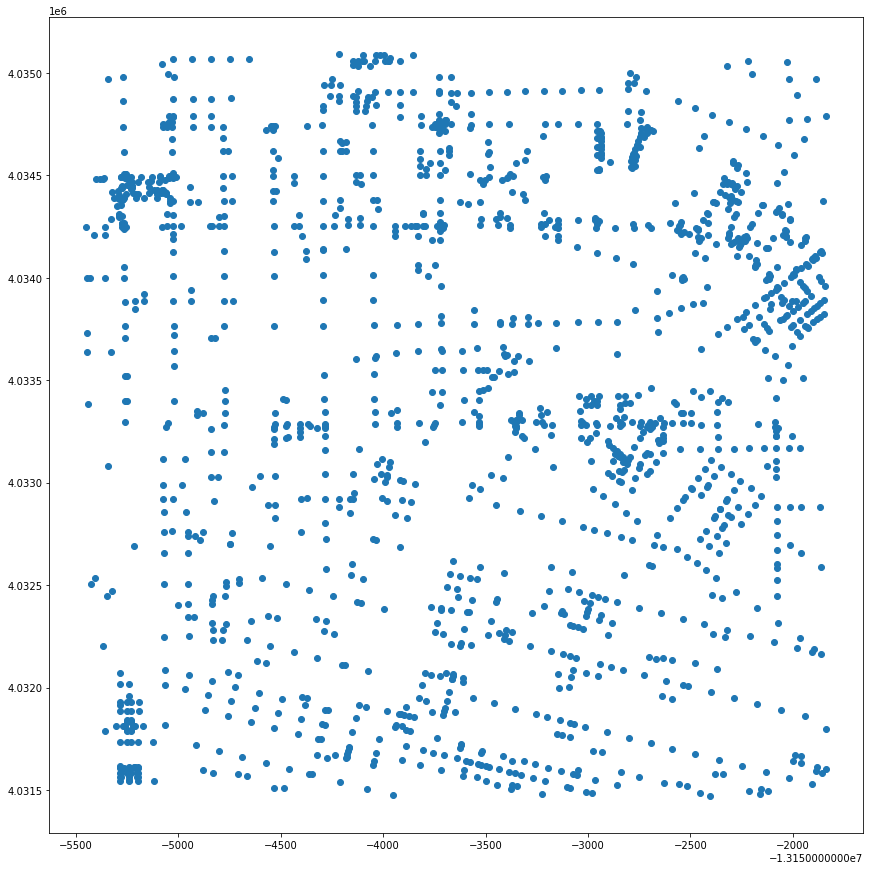

In [340]:
gdf_nodes.plot(figsize=(15,15))

In [341]:
gdf_edges.head()

osmid lanes                  name    highway  \
u          v          key                                                     
17445327   8414804812 0    397475166     7    Atlantic Boulevard    primary   
           8414804800 0    397479970     7    Atlantic Boulevard    primary   
           3643016816 0    397516716     5    West Reggin Street  secondary   
           8414804799 0    397516718     5  Avenida Cesar Chavez  secondary   
8414804812 4872874510 0    397475166     7    Atlantic Boulevard    primary   

                          maxspeed  oneway  length  \
u          v          key                            
17445327   8414804812 0     35 mph   False  30.439   
           8414804800 0     35 mph   False  26.329   
           3643016816 0        NaN   False  45.873   
           8414804799 0        NaN   False  26.236   
8414804812 4872874510 0     35 mph   False   5.754   

                                                                    geometry  \
u          v          key                                                      
17445327   8414804812 0    LINESTRING (-13151999.403 4033838.580, -131520...   
           8414804800 0    LINESTRING (-13151999.403 4033838.580, -131519...   
           3643016816 0    LINESTRING (-13151999.403 4033838.580, -131519...   
           8414804799 0    LINESTRING (-13151999.403 4033838.580, -131520...   
8414804812 4872874510 0    LINESTRING (-13152028.735 4033816.401, -131520...   

                          access service  ref bridge tunnel  
u          v          key                                    
17445327   8414804812 0      NaN     NaN  NaN    NaN    NaN  
           8414804800 0      NaN     NaN  NaN    NaN    NaN  
           3643016816 0      NaN     NaN  NaN    NaN    NaN  
           8414804799 0      NaN     NaN  NaN    NaN    NaN  
8414804812 4872874510 0      NaN     NaN  NaN    NaN    NaN

<AxesSubplot:>

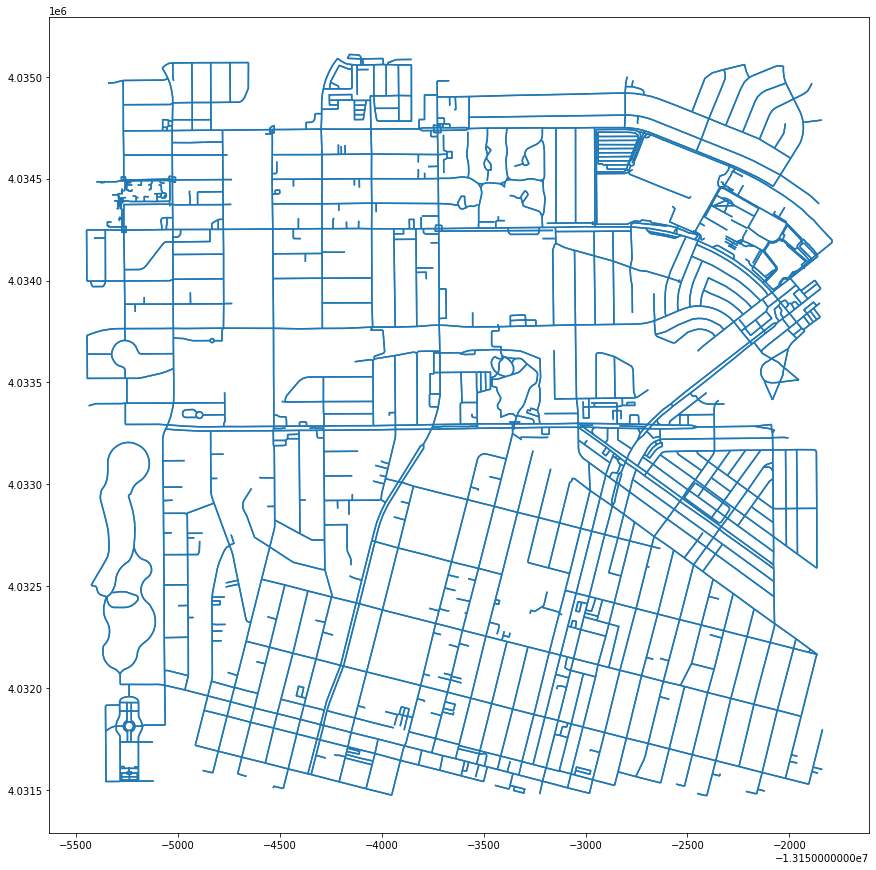

In [342]:
gdf_edges.plot(figsize=(15,15))

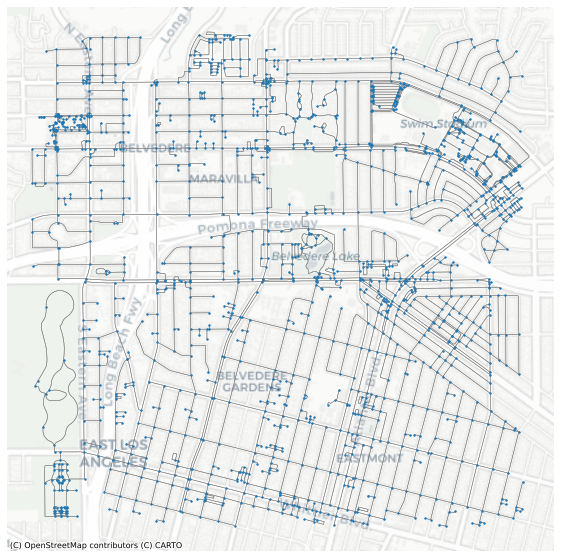

In [343]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [344]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13155448.347495379
4031471.857767747
-13151837.354721077
4035089.507649423


In [345]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13153642.851108227
4033280.6827085847


In [346]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node1 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node1))

The id for the nearest node is 269612210


In [347]:
# what is this record?
gdf_nodes.loc[[center_node1]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
269612210,4.033295e+06,-1.315361e+07,NaN,3,-118.160921,34.033453,POINT (-13153613.569 4033294.845)


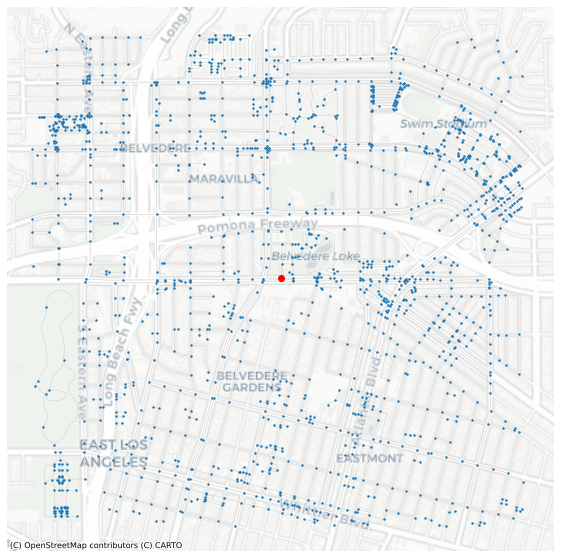

In [348]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node1]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron, zoom=14)

In [349]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,maxspeed,oneway,length,geometry,access,service,ref,bridge,tunnel
u,v,key,,,,,,,,,,,,,
8840704483,8840704482,0,955178518,NaN,NaN,footway,NaN,False,7.263,"LINESTRING (-13152073.452 4033950.441, -131520...",NaN,NaN,NaN,NaN,NaN
123141510,540554436,0,162804746,2,Woods Avenue,tertiary,NaN,False,56.447,"LINESTRING (-13153327.500 4031573.502, -131533...",NaN,NaN,NaN,NaN,NaN
607813223,122658911,0,"[397468224, 404034714]",6,Mednik Avenue,secondary,NaN,False,79.557,"LINESTRING (-13153714.491 4033548.608, -131537...",NaN,NaN,NaN,NaN,NaN
5624025992,7875671484,0,397479971,4,Atlantic Boulevard,primary,35 mph,False,40.150,"LINESTRING (-13153093.762 4032003.417, -131530...",NaN,NaN,NaN,NaN,NaN
4605930421,589715449,0,806072019,NaN,NaN,service,NaN,False,116.882,"LINESTRING (-13154303.081 4031746.331, -131542...",NaN,alley,NaN,NaN,NaN


In [350]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [351]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,maxspeed,oneway,length,geometry,access,service,ref,bridge,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,
6789830140,6725928847,0,723952124,NaN,NaN,service,NaN,False,163.177,"LINESTRING (-13154132.161 4031853.592, -131540...",NaN,alley,NaN,NaN,NaN,2.039712
123302986,122884142,0,13401088,NaN,West 1st Street,tertiary,NaN,False,41.670,"LINESTRING (-13152436.576 4033874.259, -131524...",NaN,NaN,NaN,NaN,NaN,0.520875
6726756156,6726756155,0,715782620,NaN,NaN,service,NaN,False,11.057,"LINESTRING (-13152687.279 4032593.726, -131527...",NaN,NaN,NaN,NaN,NaN,0.138213
123385026,1746242104,0,13451050,NaN,South Hillview Avenue,residential,NaN,False,41.509,"LINESTRING (-13152663.568 4032743.924, -131526...",NaN,NaN,NaN,NaN,NaN,0.518863
1746242151,122785214,0,162804741,NaN,South McDonnell Avenue,residential,NaN,False,100.053,"LINESTRING (-13154286.228 4033526.685, -131542...",NaN,NaN,NaN,NaN,NaN,1.250663


In [352]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [353]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [354]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 269612210, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 271 nodes within 10 minutes 


In [355]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
1746242080,4.032284e+06,-1.315360e+07,NaN,4,-118.160835,34.025927,POINT (-13153604.017 4032283.880),10 mins,#0d0887
2032564789,4.034085e+06,-1.315190e+07,NaN,3,-118.145544,34.039337,POINT (-13151901.809 4034085.288),NaN,NaN
122797530,4.033115e+06,-1.315507e+07,NaN,3,-118.174044,34.032117,POINT (-13155074.459 4033115.397),NaN,NaN
1746242160,4.033609e+06,-1.315404e+07,NaN,3,-118.164765,34.035790,POINT (-13154041.436 4033608.721),10 mins,#0d0887
6788662221,4.034228e+06,-1.315255e+07,NaN,3,-118.151404,34.040402,POINT (-13152554.141 4034228.305),NaN,NaN
123167630,4.033022e+06,-1.315246e+07,NaN,4,-118.150572,34.031422,POINT (-13152461.534 4033021.947),NaN,NaN
122620567,4.032784e+06,-1.315302e+07,stop,4,-118.155621,34.029647,POINT (-13153023.564 4032783.549),NaN,NaN
7859977747,4.034768e+06,-1.315369e+07,NaN,3,-118.161634,34.044419,POINT (-13153692.939 4034768.027),NaN,NaN
8777112249,4.034508e+06,-1.315527e+07,NaN,4,-118.175766,34.042484,POINT (-13155266.095 4034507.963),NaN,NaN


In [356]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [357]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
123141505,4.032969e+06,-1.315298e+07,NaN,4,-118.155208,34.031028,POINT (-13152977.600 4032969.117),10 mins,#0d0887
123752103,4.031978e+06,-1.315240e+07,NaN,4,-118.150027,34.023649,POINT (-13152400.887 4031978.005),NaN,#cccccc
7874389993,4.034559e+06,-1.315377e+07,NaN,1,-118.162353,34.042864,POINT (-13153772.967 4034559.054),NaN,#cccccc
123304217,4.032383e+06,-1.315400e+07,NaN,4,-118.164363,34.026668,POINT (-13153996.697 4032383.476),10 mins,#0d0887
1743923274,4.031579e+06,-1.315524e+07,NaN,3,-118.175513,34.020678,POINT (-13155237.909 4031578.968),NaN,#cccccc


<AxesSubplot:>

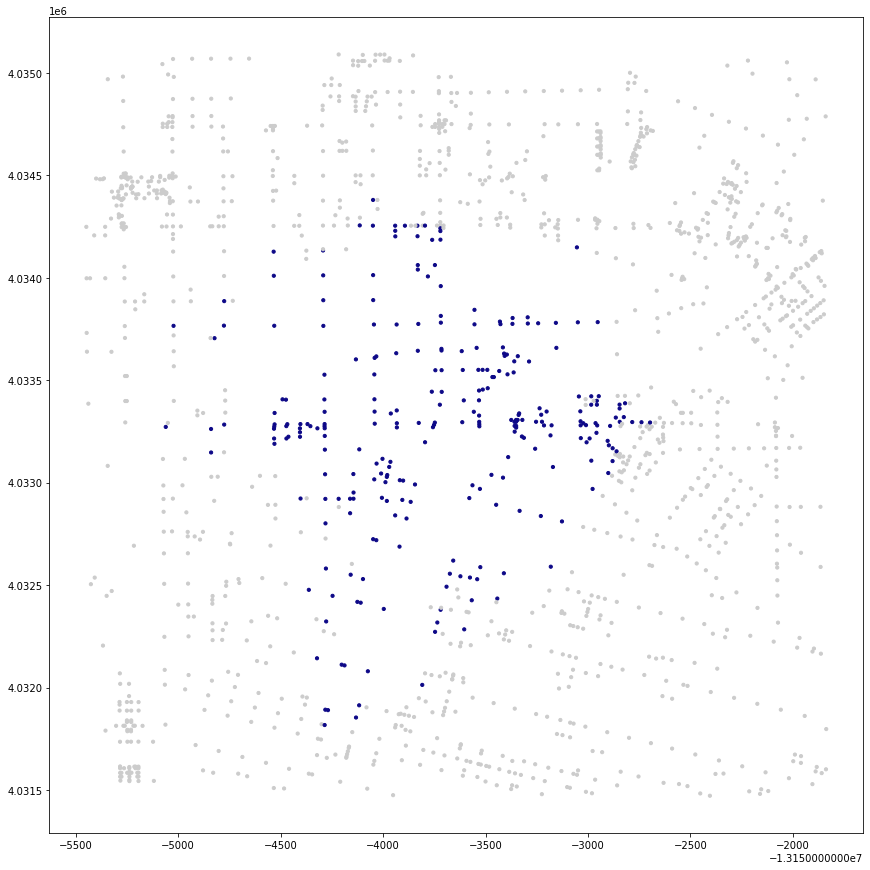

In [358]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

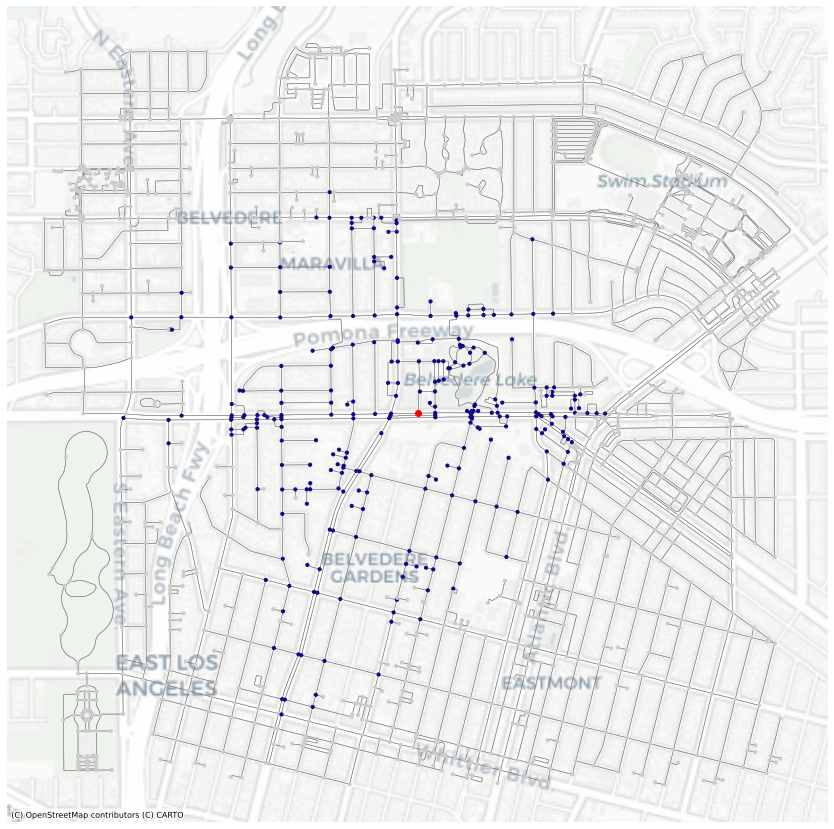

In [359]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[269612210]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [360]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
6816488222,4.034241e+06,-1.315372e+07,NaN,4,-118.161882,34.040497,POINT (-13153720.558 4034241.067),10 mins,#0d0887
74673066,4.034127e+06,-1.315453e+07,traffic_signals,3,-118.169191,34.039649,POINT (-13154534.158 4034127.121),10 mins,#0d0887
6735157126,4.031892e+06,-1.315428e+07,NaN,3,-118.166926,34.023007,POINT (-13154282.009 4031891.776),10 mins,#0d0887
1742549940,4.031817e+06,-1.315429e+07,traffic_signals,4,-118.166954,34.022450,POINT (-13154285.181 4031816.938),10 mins,#0d0887
122584279,4.034009e+06,-1.315453e+07,NaN,3,-118.169183,34.038773,POINT (-13154533.324 4034009.495),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8361650777,4.033306e+06,-1.315332e+07,NaN,1,-118.158287,34.033536,POINT (-13153320.320 4033305.954),10 mins,#0d0887
8361650775,4.033306e+06,-1.315337e+07,NaN,1,-118.158774,34.033535,POINT (-13153374.566 4033305.806),10 mins,#0d0887
8361650779,4.033268e+06,-1.315335e+07,NaN,1,-118.158558,34.033256,POINT (-13153350.543 4033268.382),10 mins,#0d0887


In [361]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

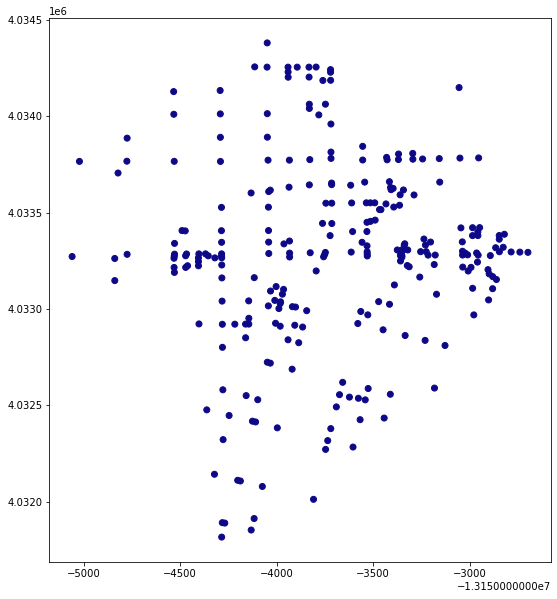

In [362]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

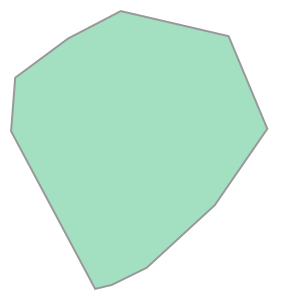

In [363]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [364]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13155060.722 4033271.808, -131550...",4.034241e+06,-1.315372e+07,traffic_signals,4,-118.161882,34.040497,#0d0887


In [365]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13154285.181 4031816.938, -13155060..."


In [366]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13154285.181 4031816.938, -13155060..."


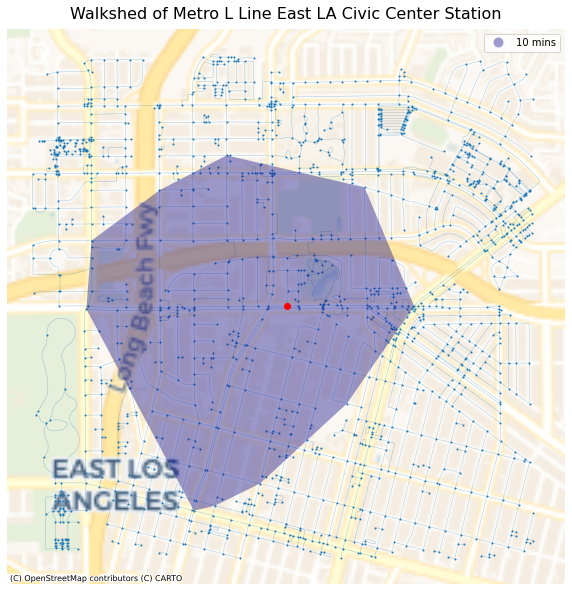

In [367]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node1]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line East LA Civic Center Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

In [368]:
civic = gdf[gdf["FIPS"].isin(['06037530400', 
                              '06037530301', 
                              '06037531603',
                              '06037531604',
                              '06037531504',
                              '06037531503',
                              '06037531000',
                              '06037530500']
                                    )
                     ]

In [369]:
civic.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,11 Caribbean,11 Caribbean Entered 2000 or later,11 Central America,11 Mexico,11 Mexico Entered 2000 or later,11 Other Central America,11 Other Central America 2000 or later,11 South America,11 South America Entered 2000 or later,11 Other areas,11 Other areas Entered 2000 or later,19 Total Population,19 Total Foreign Born,19 Total Entered 2010 or later,19 Europe,19 Europe Entered 2010 or later,19 Asia,19 Asia Entered 2010 or later,19 Latin America,19 Caribbean,19 Caribbean entered 2010 or later,19 Central America,19 Mexico,19 Mexico Entered 2010 or later,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,geometry,% Change Foreign Born,% Europe,% Asia,% Latin America,% Caribbean,% Central America,% Mexico,% Other Central America,% South America,% Other Areas
1530,06037530301,"Census Tract 5303.01, Los Angeles, CA",2389.0,1190.0,4.0,0.0,36.0,0.0,1150.0,0.0,0.0,1122.0,929.0,126.0,193.0,27.0,28.0,28.0,0.0,0.0,2211.0,865.0,61.0,0.0,0.0,82.0,3.0,783.0,0.0,0.0,774.0,720.0,58.0,54.0,0.0,9.0,0.0,0.0,0.0,"MULTIPOLYGON (((-118.15978 34.02568, -118.1595...",-10.689068,0.00000,3.708729,35.413840,0.000000,35.006784,32.564450,2.442334,0.407056,0.000000
1532,06037530400,"Census Tract 5304, Los Angeles, CA",3427.0,1015.0,0.0,0.0,274.0,16.0,715.0,0.0,0.0,616.0,476.0,11.0,140.0,0.0,99.0,32.0,26.0,26.0,3744.0,1290.0,138.0,16.0,0.0,467.0,138.0,807.0,4.0,0.0,789.0,628.0,0.0,161.0,0.0,14.0,0.0,0.0,0.0,"MULTIPOLYGON (((-118.16186 34.03384, -118.1617...",4.837387,0.42735,12.473291,21.554487,0.106838,21.073718,16.773504,4.300214,0.373932,0.000000
1533,06037530500,"Census Tract 5305, Los Angeles, CA",4555.0,1560.0,1.0,0.0,0.0,0.0,1557.0,27.0,0.0,1514.0,1381.0,310.0,133.0,9.0,16.0,8.0,2.0,0.0,3719.0,1516.0,91.0,0.0,0.0,70.0,32.0,1434.0,0.0,0.0,1434.0,1253.0,41.0,181.0,18.0,0.0,0.0,12.0,0.0,"MULTIPOLYGON (((-118.16991 34.03369, -118.1698...",6.515567,0.00000,1.882226,38.558752,0.000000,38.558752,33.691853,4.866900,0.000000,0.322667
1541,06037531000,"Census Tract 5310, Los Angeles, CA",5219.0,2134.0,9.0,0.0,0.0,0.0,2124.0,0.0,0.0,2124.0,1938.0,394.0,186.0,40.0,0.0,0.0,1.0,0.0,5133.0,1790.0,69.0,0.0,0.0,7.0,0.0,1783.0,0.0,0.0,1774.0,1639.0,69.0,135.0,0.0,9.0,0.0,0.0,0.0,"MULTIPOLYGON (((-118.17866 34.03421, -118.1786...",-6.016665,0.00000,0.136372,34.736022,0.000000,34.560686,31.930645,2.630041,0.175336,0.000000
1549,06037531503,"Census Tract 5315.03, Los Angeles, CA",3651.0,1826.0,0.0,0.0,0.0,0.0,1826.0,0.0,0.0,1826.0,1501.0,411.0,325.0,189.0,0.0,0.0,0.0,0.0,2753.0,946.0,44.0,0.0,0.0,0.0,0.0,946.0,0.0,0.0,946.0,837.0,44.0,109.0,0.0,0.0,0.0,0.0,0.0,"MULTIPOLYGON (((-118.18047 34.03340, -118.1804...",-15.651181,0.00000,0.000000,34.362514,0.000000,34.362514,30.403197,3.959317,0.000000,0.000000


<AxesSubplot:>

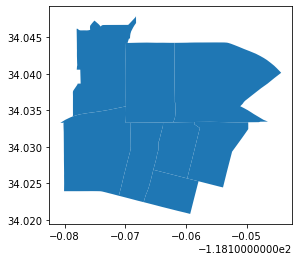

In [370]:
civic.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

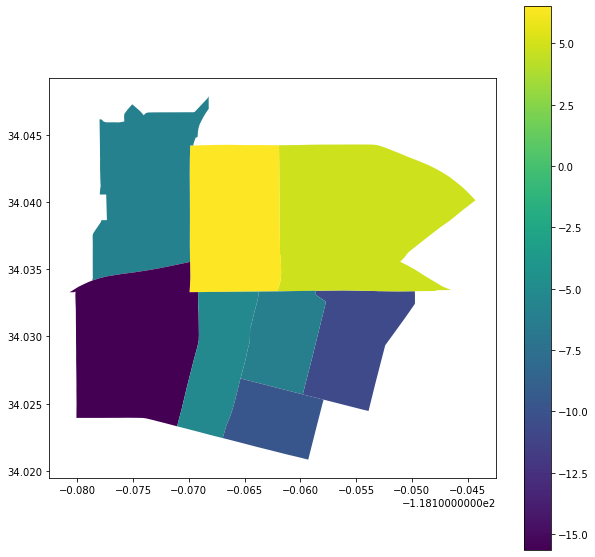

In [371]:
civic.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [372]:
civic_web_mercator = civic.to_crs(epsg=3857)

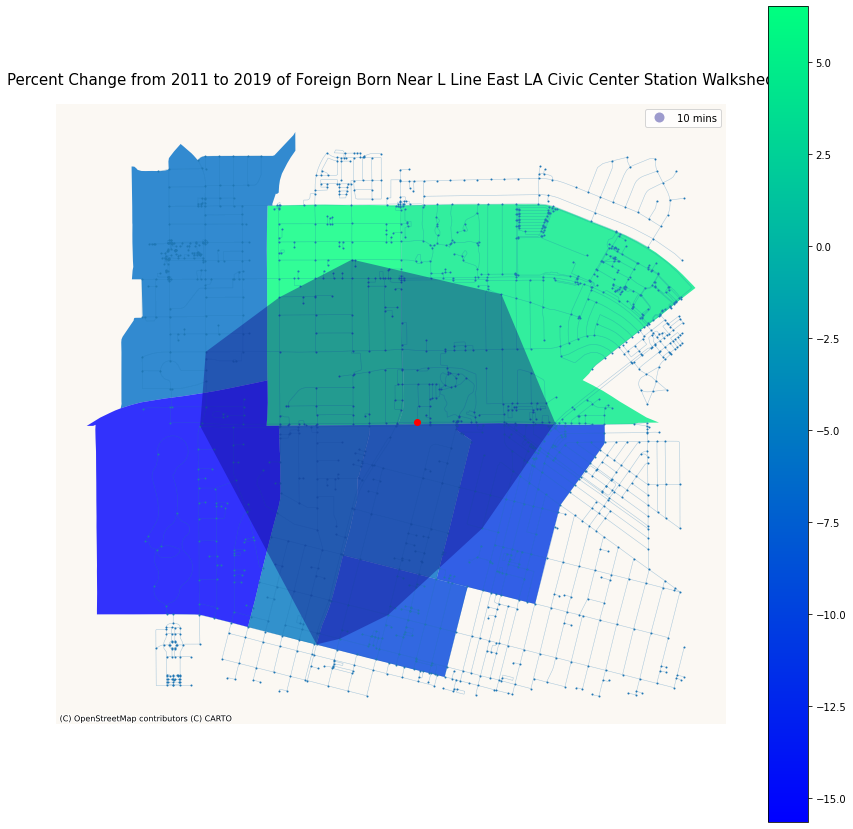

In [373]:
fig, ax = plt.subplots(figsize=(15, 15))
 
civic_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8,
                    cmap="winter")

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node1]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line East LA Civic Center Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

### Arroyo Seco Collective

Erik: Chinatown Station walkshed, isochrone mapping, interactive mapping, census tract tracking, code and markdown proofreading, 

Kevin: Del Mar Station walk shed, plotly charting, function and “for loop” coding, data merging, final midterm notebook construction, code proofreading
